# October ??th, 2021

**Motivation**: ?? <br>

In [1]:
# HIDE CODE


import os
import sys
import nibabel as nib
import networkx as nx
from time import time
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from myterial import orange, blue_grey
from IPython.display import display, IFrame, HTML
from matplotlib.colors import rgb2hex, to_rgb
import matplotlib.pyplot as plt
import seaborn as sns

# set style & no interpolalation
import matplotlib
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = pjoin(os.environ['HOME'], 'Documents/workspaces/lfr/binary_overlapping')


# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [2]:
%%time

mice = Mice((192, 4))

CPU times: user 256 ms, sys: 767 ms, total: 1.02 s
Wall time: 1.02 s


In [3]:
mice.setup_func_data()

In [4]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p15-sample',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'prepare_data': False,
    'verbose': False,
}

  0%|          | 0/162 [00:00<?, ?it/s]

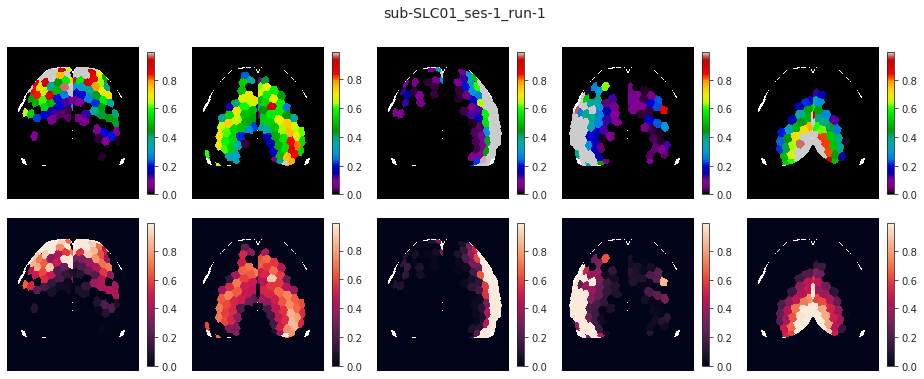

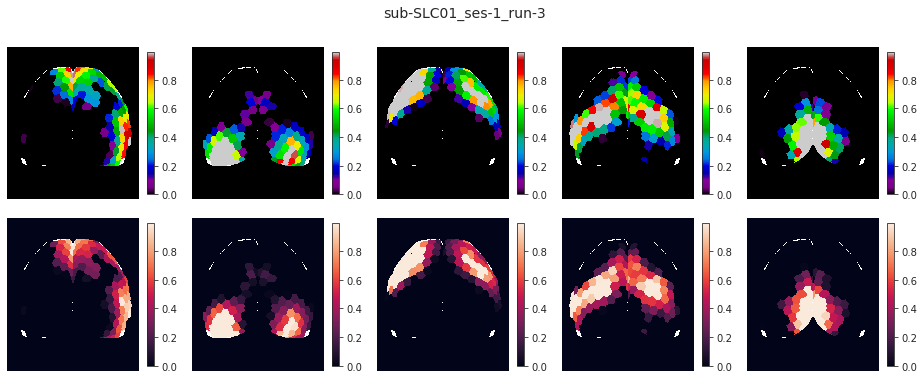

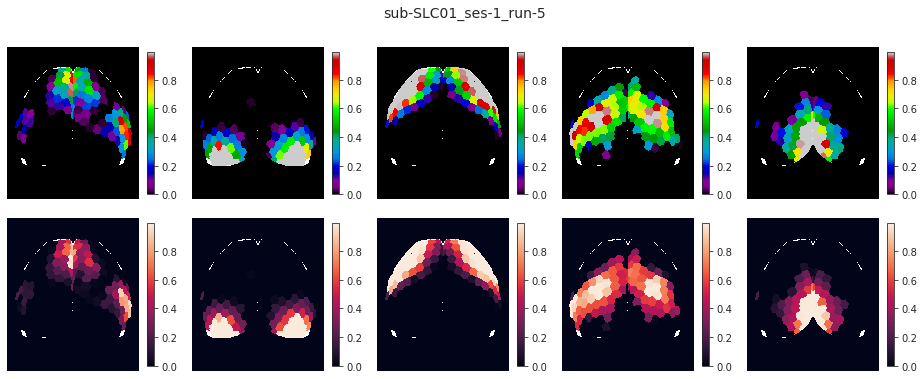

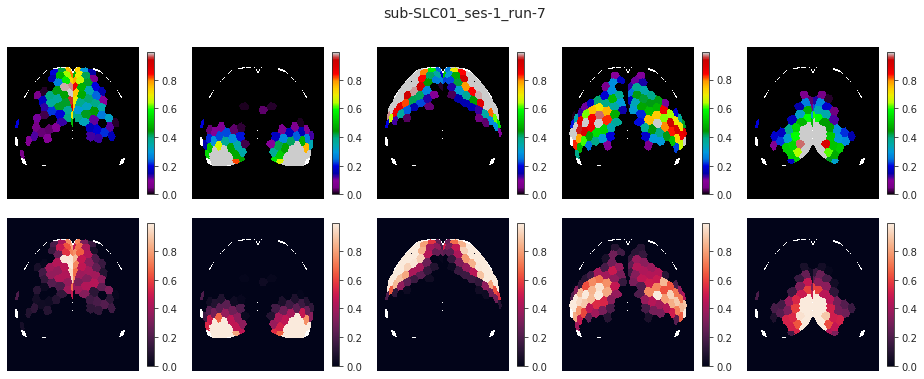

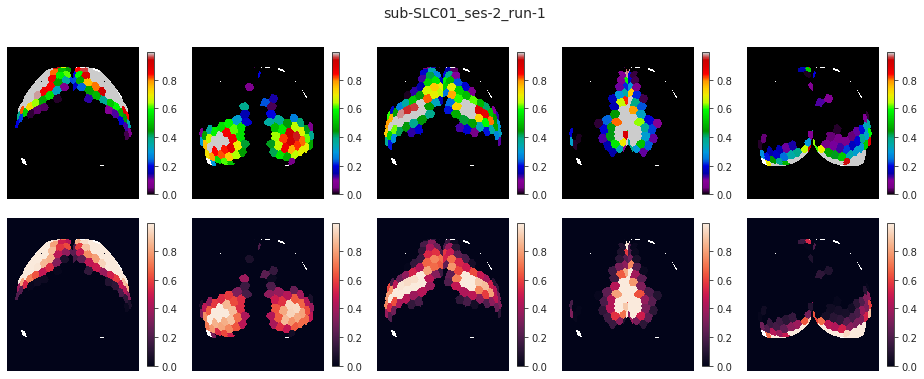

...

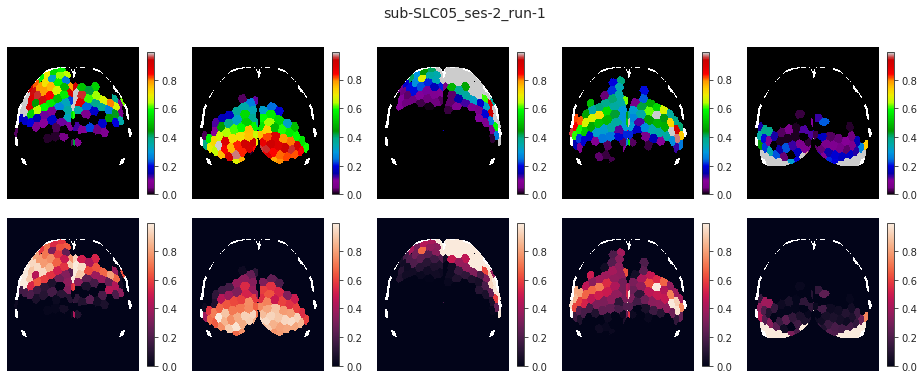

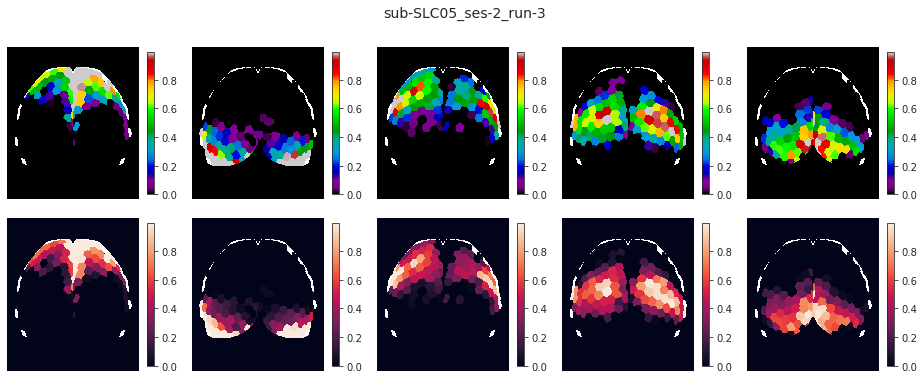

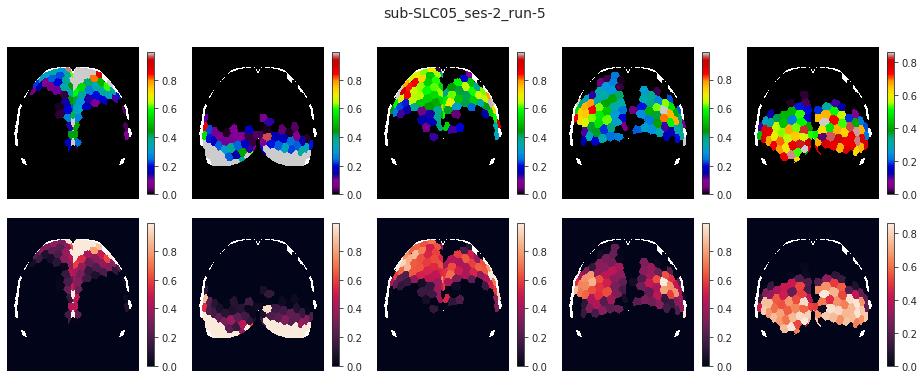

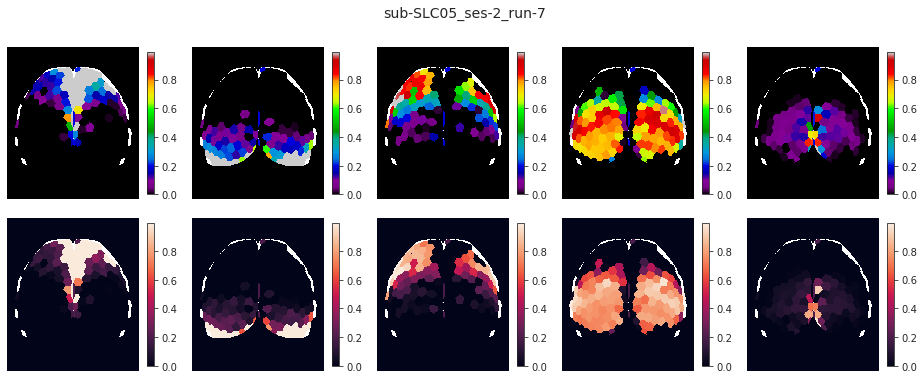

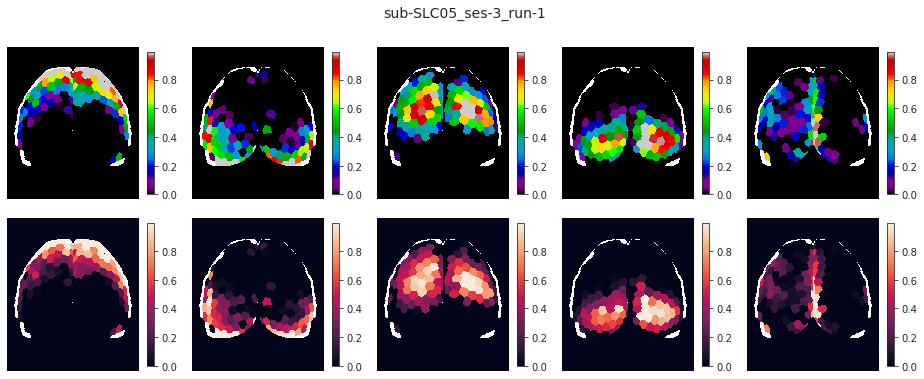

In [5]:
pi_avg = []
for key in tqdm(mice.ca):
    if 'run' not in key:
        continue
    sv = SVINET(key=key, mode='ca2', **props)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    else:
        continue
        
    proj = sv.project_vec()
    
    fig, axes = create_figure(2, 5, (13, 5.5))
    for i in range(5):
        ax = axes[0, i]
        im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
        plt.colorbar(im, ax=ax, shrink=0.8)

        ax = axes[1, i]
        im = ax.imshow(proj['parcel2d-top'][i])
        plt.colorbar(im, ax=ax, shrink=0.8)
    fig.suptitle(key, fontsize=14)
    remove_ticks(axes)
    plt.show()

  0%|          | 0/162 [00:00<?, ?it/s]

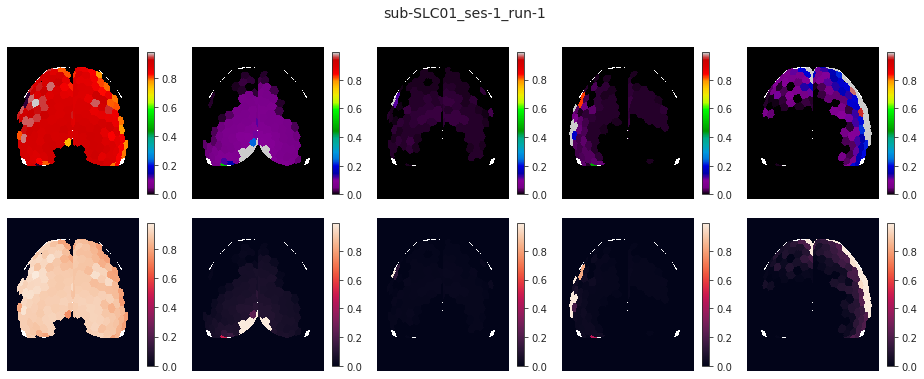

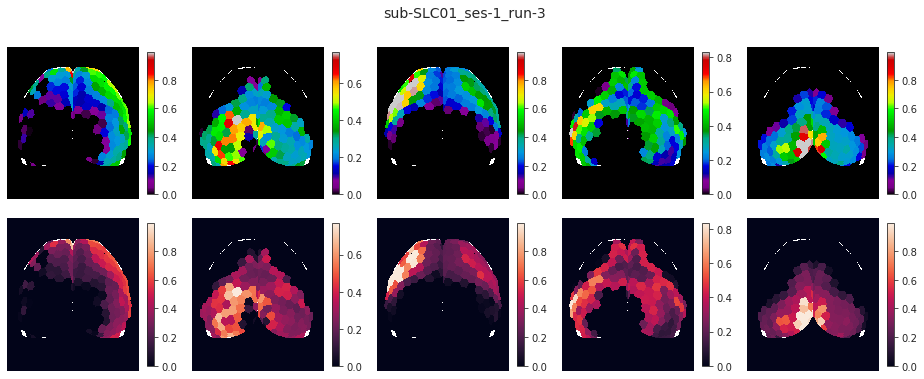

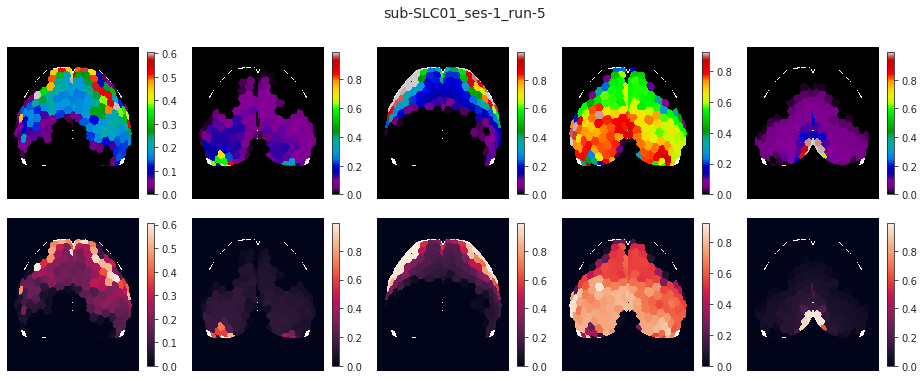

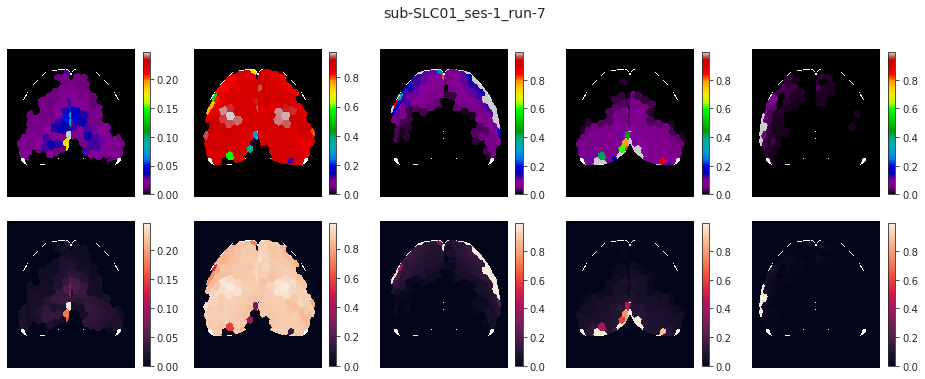

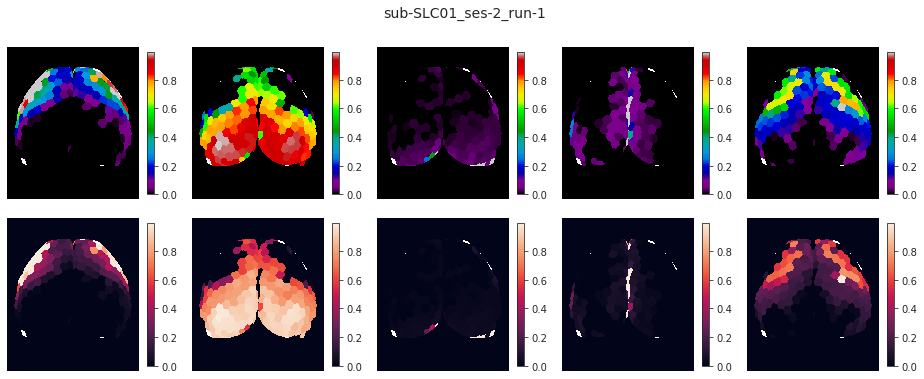

...

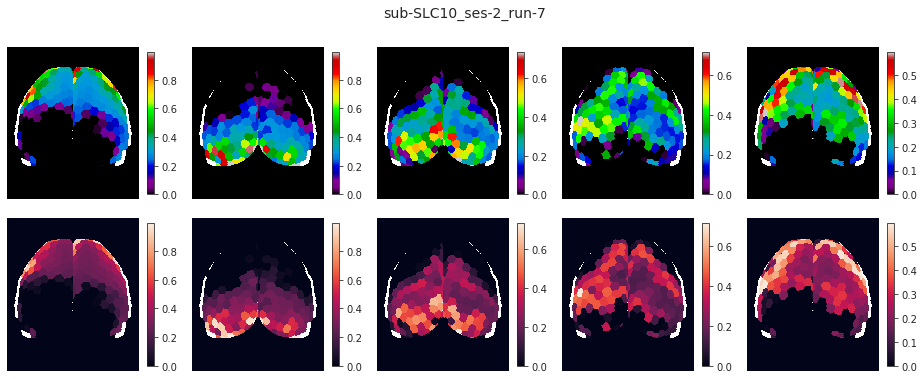

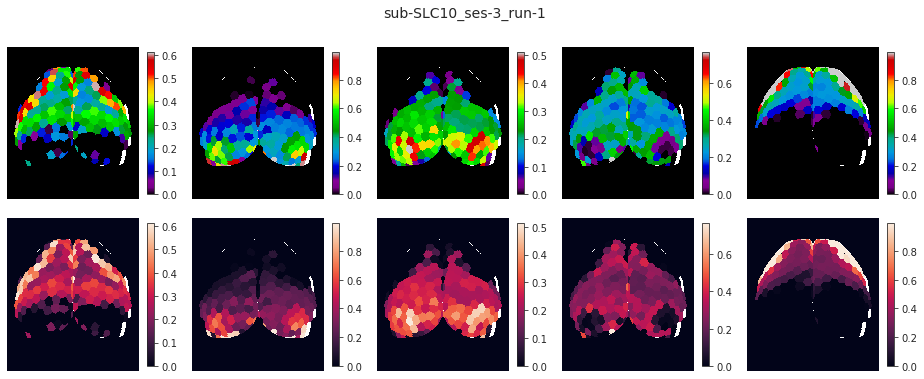

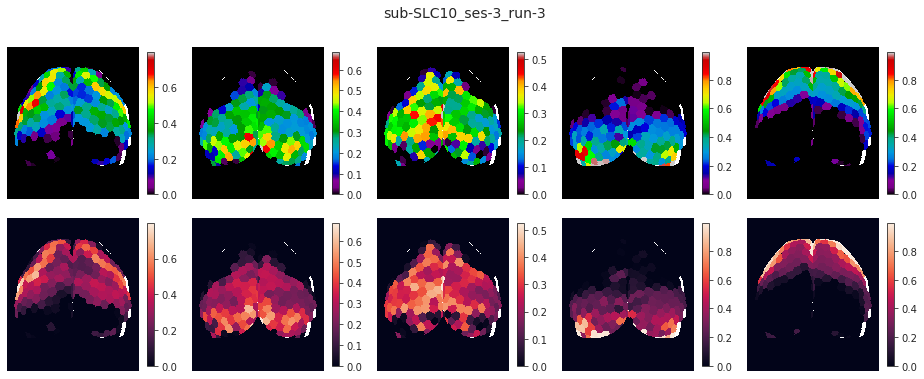

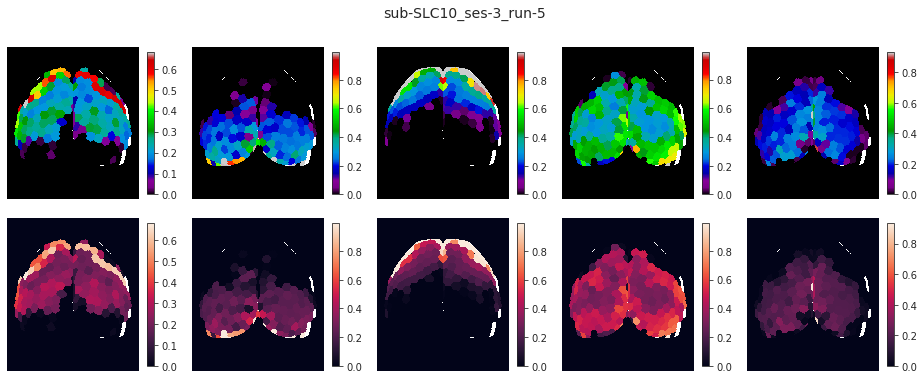

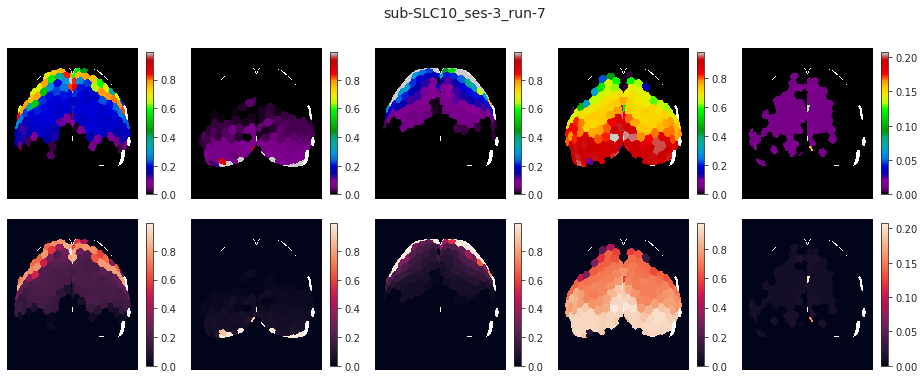

In [13]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p15-sample',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'prepare_data': False,
    'verbose': False,
}

  0%|          | 0/160 [00:00<?, ?it/s]

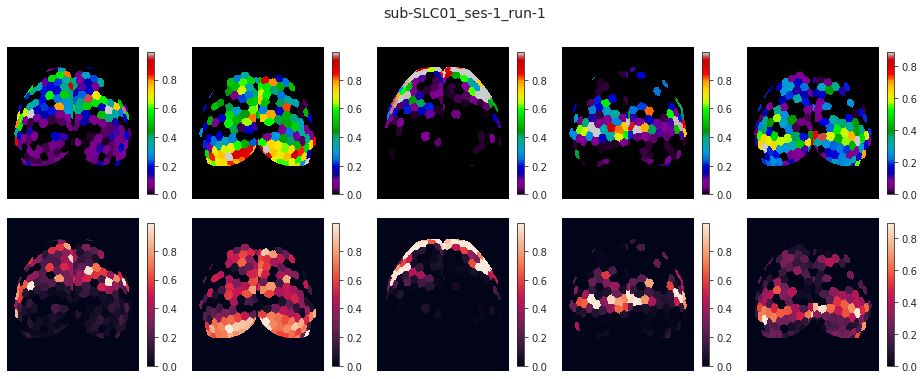

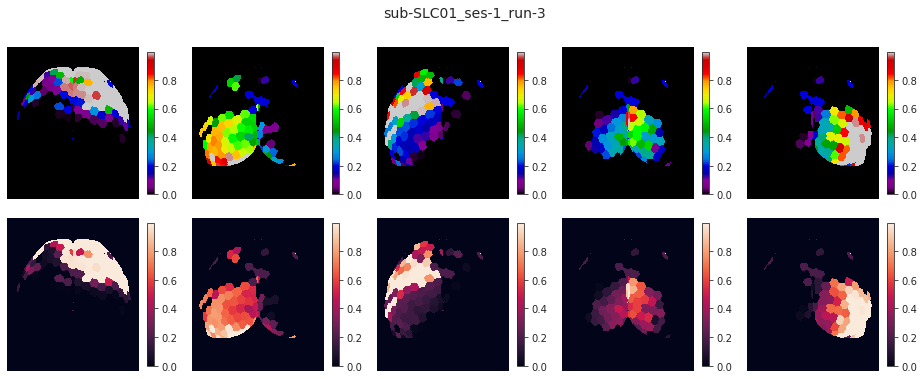

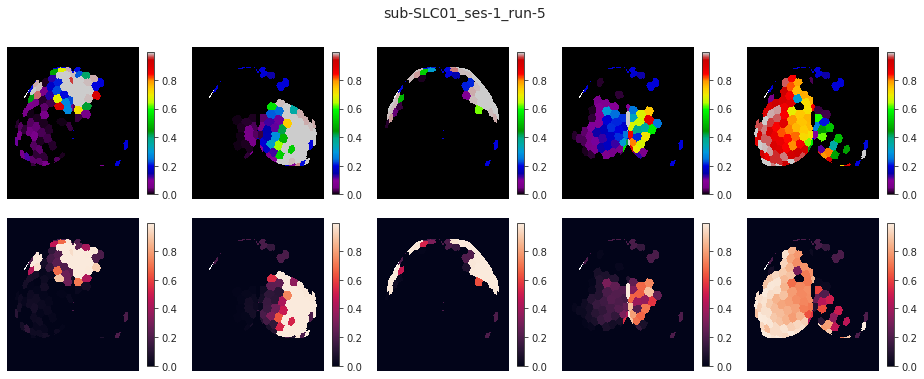

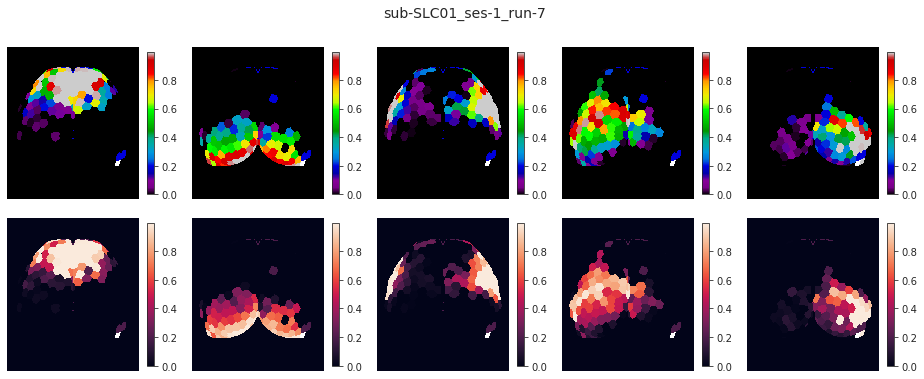

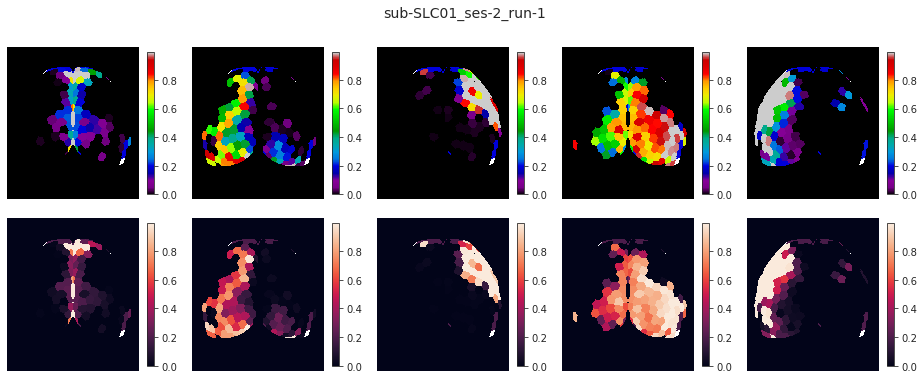

...

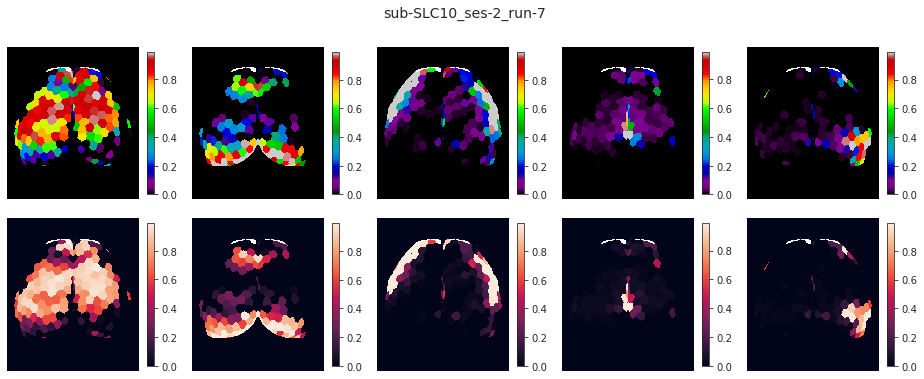

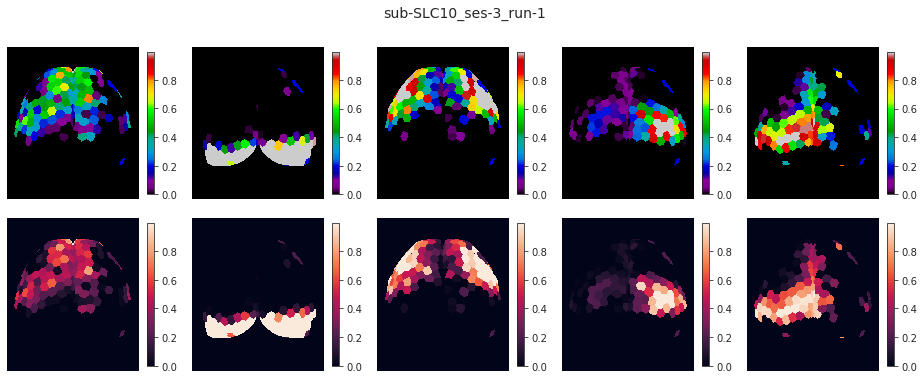

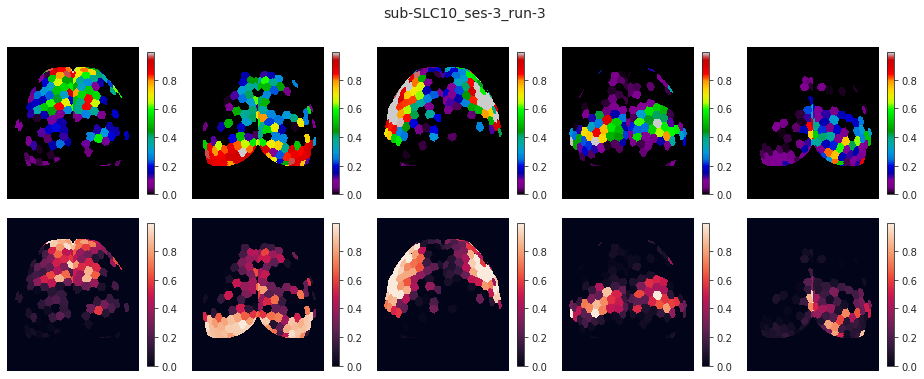

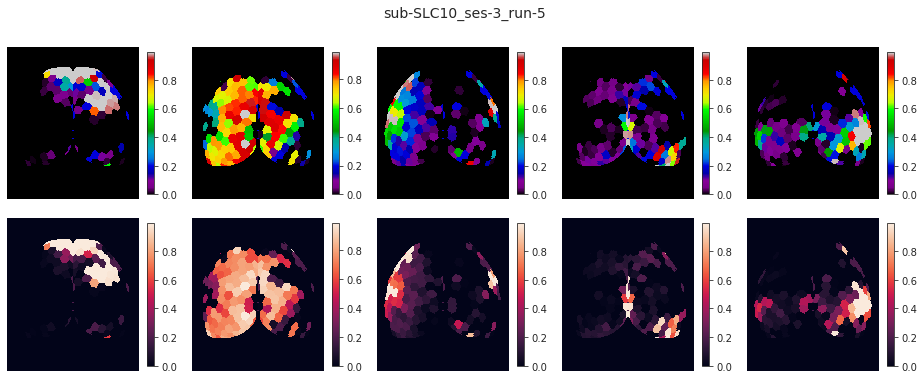

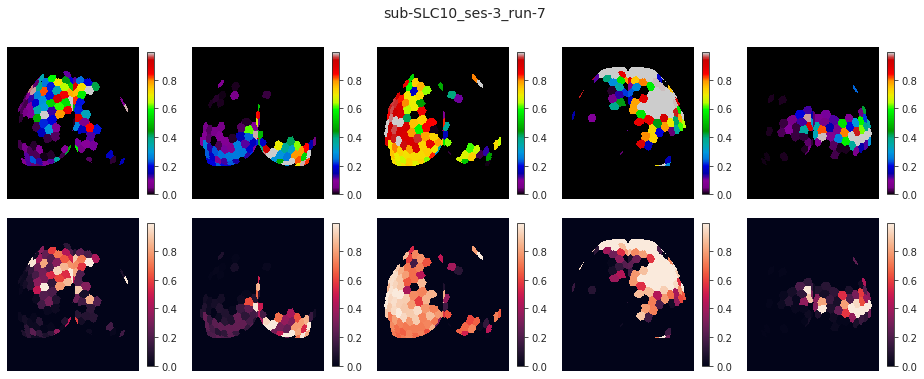

In [14]:
pi_avg = []
for key in tqdm(mice.bold):
    if 'run' not in key:
        continue
    sv = SVINET(key=key, mode='bold-lite', **props)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    else:
        continue

    proj = sv.project_vec()
    
    fig, axes = create_figure(2, 5, (13, 5.5))
    for i in range(5):
        ax = axes[0, i]
        im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
        plt.colorbar(im, ax=ax, shrink=0.8)

        ax = axes[1, i]
        im = ax.imshow(proj['parcel2d-top'][i])
        plt.colorbar(im, ax=ax, shrink=0.8)
    fig.suptitle(key, fontsize=14)
    remove_ticks(axes)
    plt.show()

  0%|          | 0/160 [00:00<?, ?it/s]

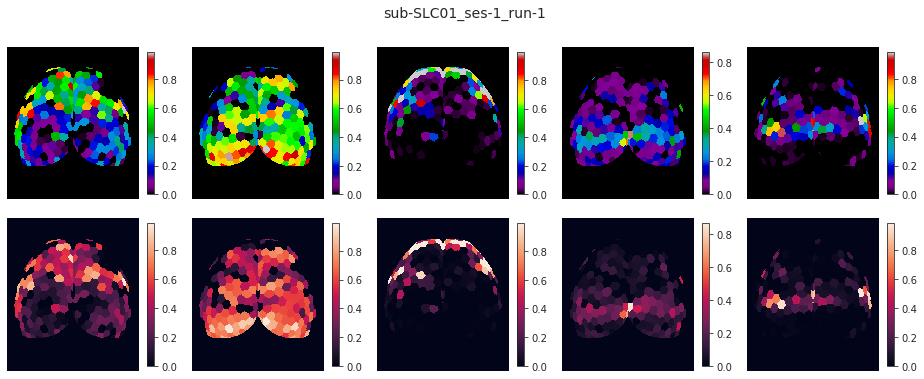

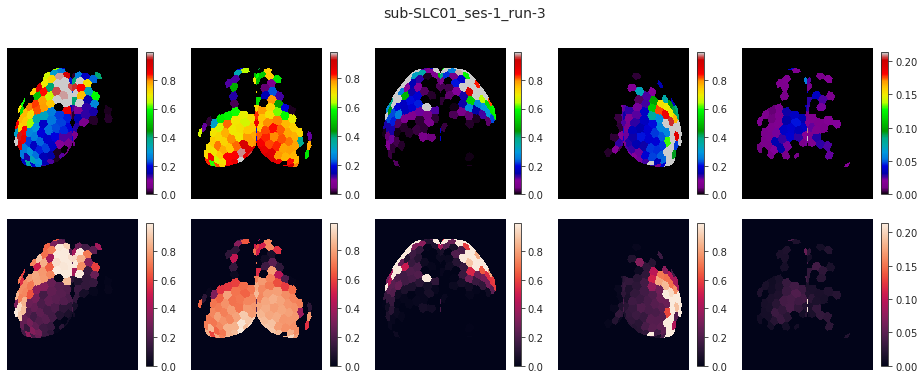

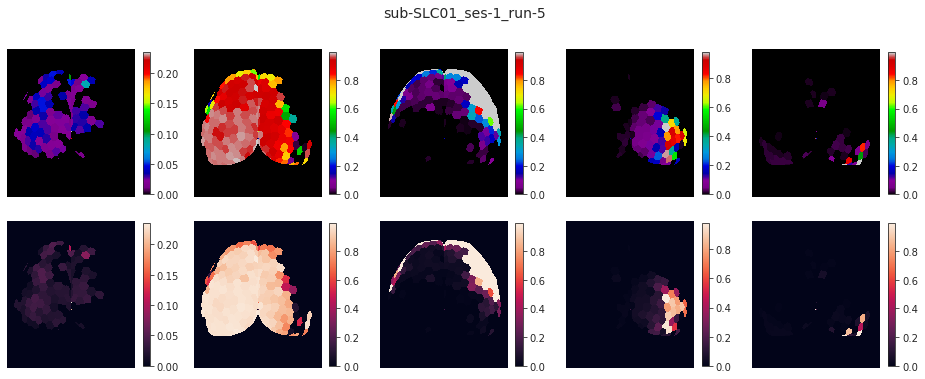

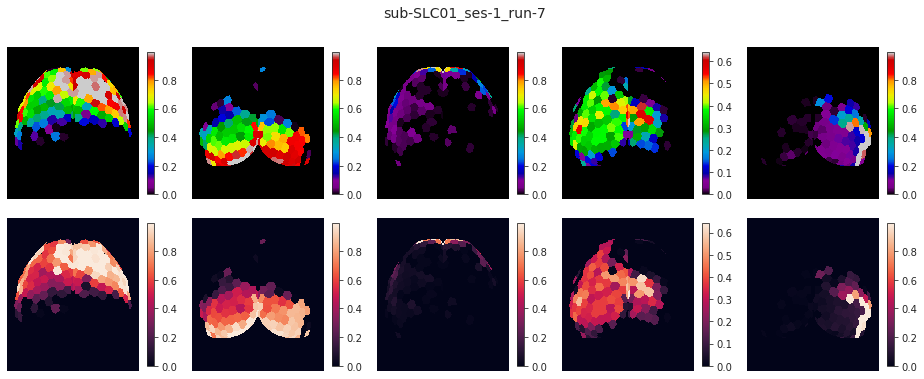

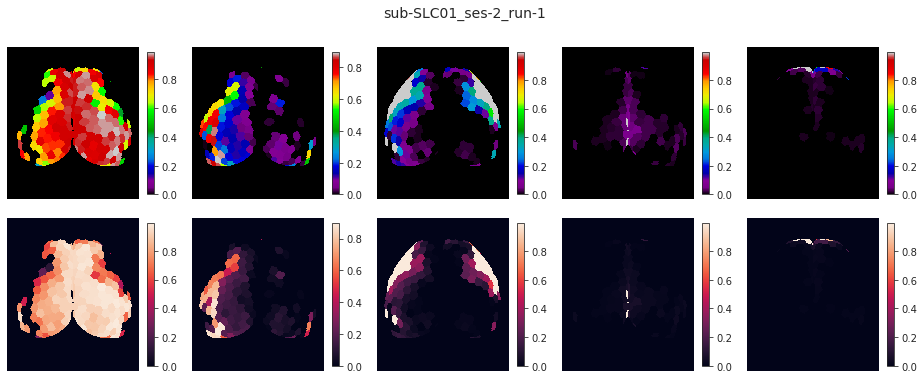

...

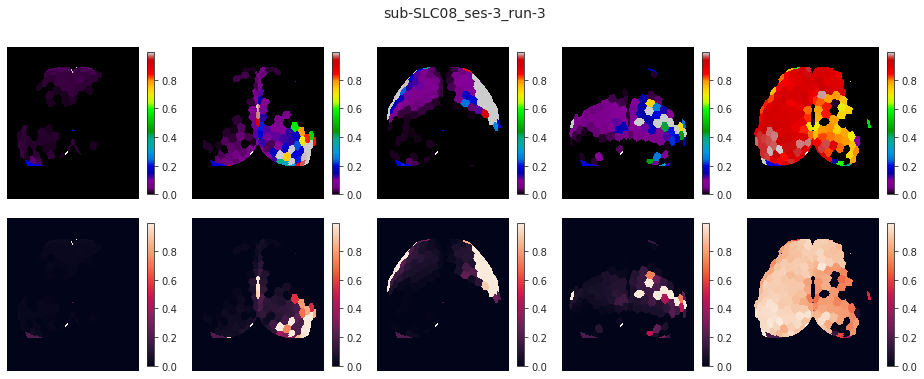

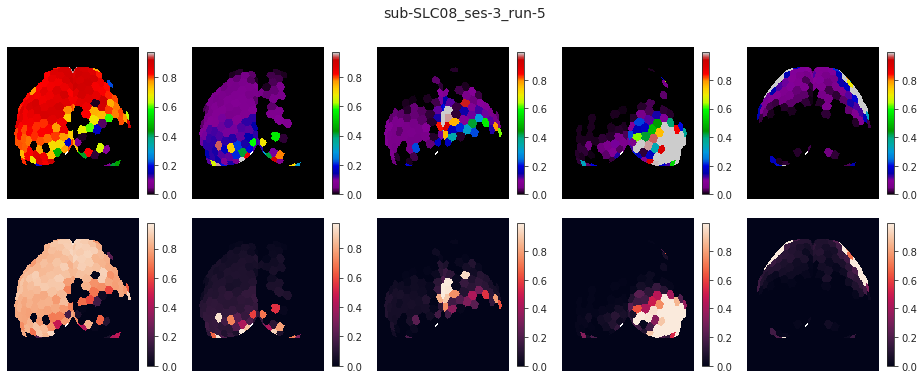

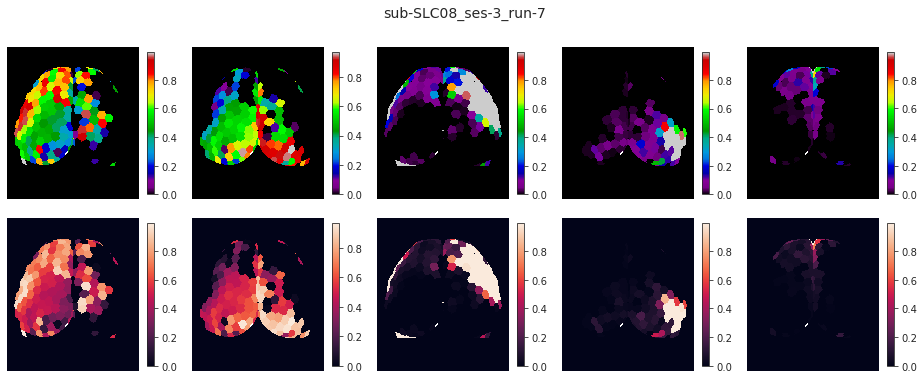

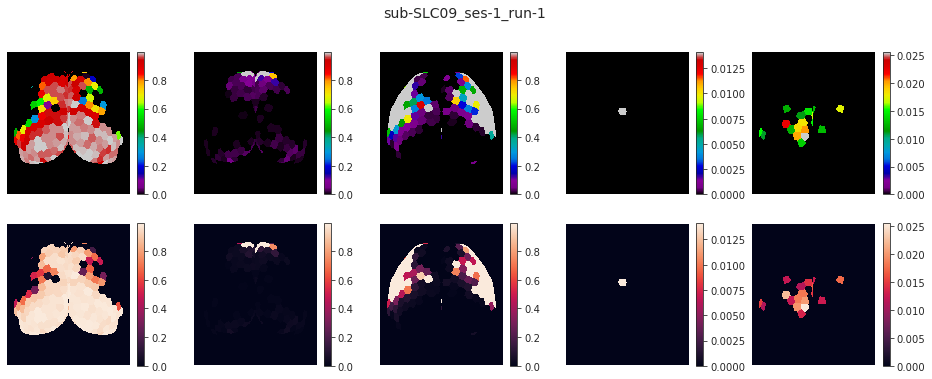

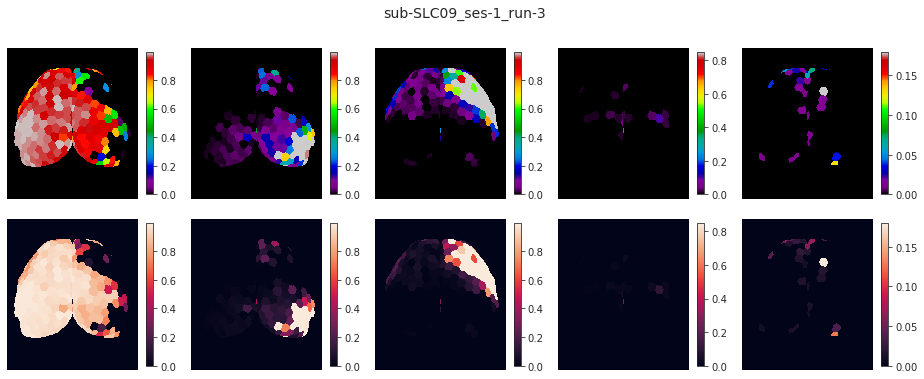

In [66]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-binary',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'prepare_data': False,
    'verbose': False,
}

In [67]:
def give_me_pi(mode):
    proc, *_ = mice.get_data_containers(mode)
    pi_avg = []
    for key in proc:
        if 'run' not in key:
            continue
        sv = SVINET(key=key, mode=mode, **props)
        _ = sv.load_results()
        if sv.pi is not None:
            pi_avg.append(np.expand_dims(sv.pi, 0))
        else:
            continue
    pi_avg = np.concatenate(pi_avg)
    pi_avg = bn.nanmean(pi_avg, axis=0)
    comm_vec = sv.get_disjoint_community(pi_avg, to_vec=True)
    pi_full = np.concatenate([pi_avg, np.expand_dims(comm_vec, 0)])
    return pi_full

In [68]:
pi_ca = give_me_pi('ca2')
pi_ca.shape

(6, 302)

In [69]:
gr = Group(mode='ca2', **props)
proj_ca = gr.project_vec(pi_ca)

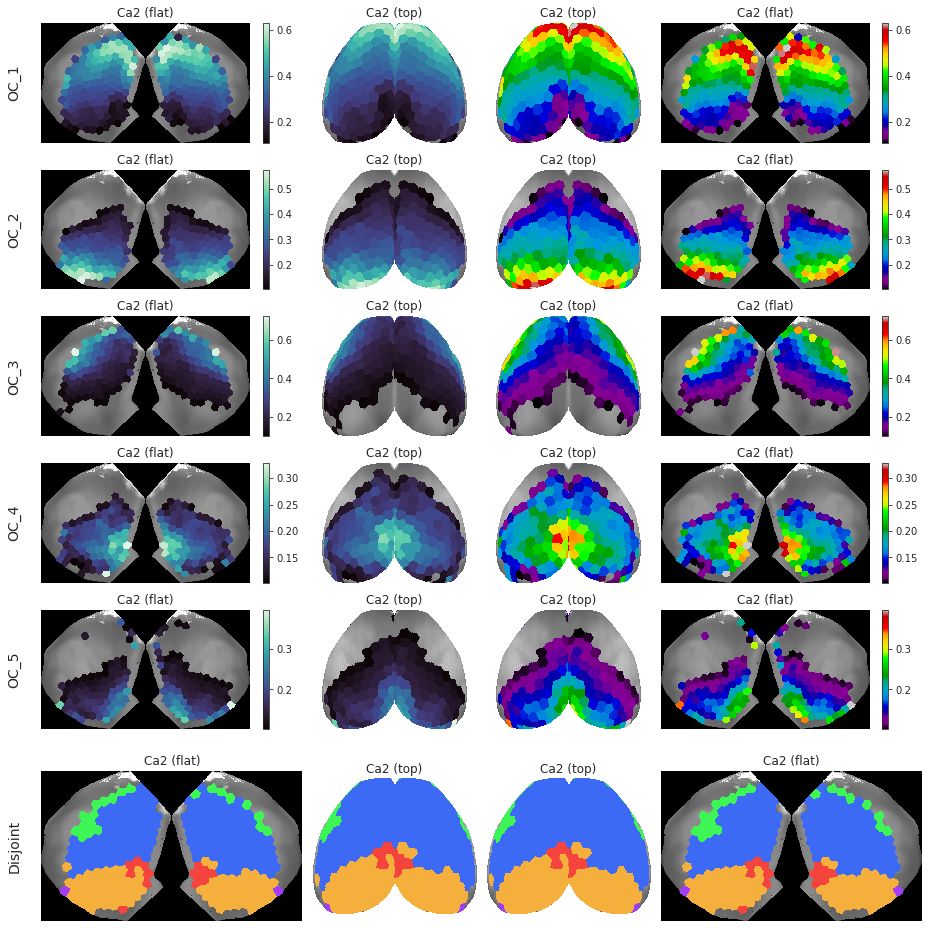

In [70]:
gr.show(proj_ca, labels=('Ca2',) * 2, cmaps=('mako', 'nipy_spectral'))

In [71]:
pi_bold = give_me_pi('bold-lite')
pi_bold.shape

(6, 302)

In [72]:
gr = Group(mode='bold-lite', **props)
proj_bold = gr.project_vec(pi_bold)

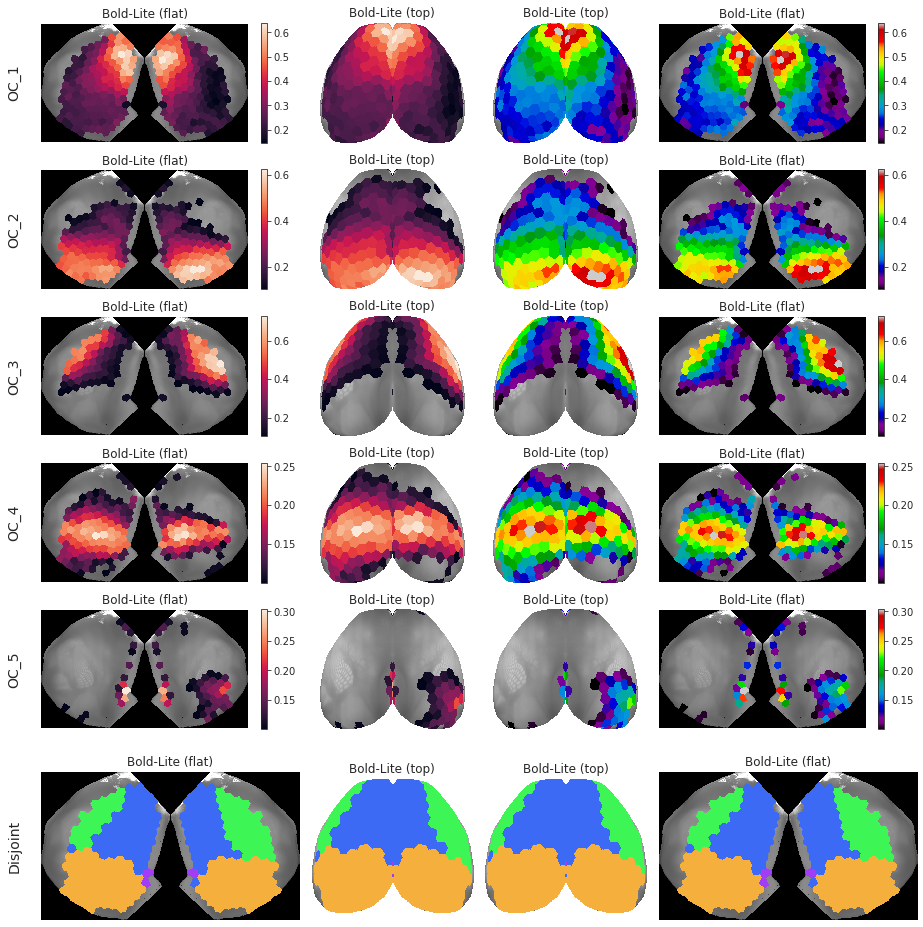

In [73]:
gr.show(proj_bold, labels=('Bold-Lite',) * 2)

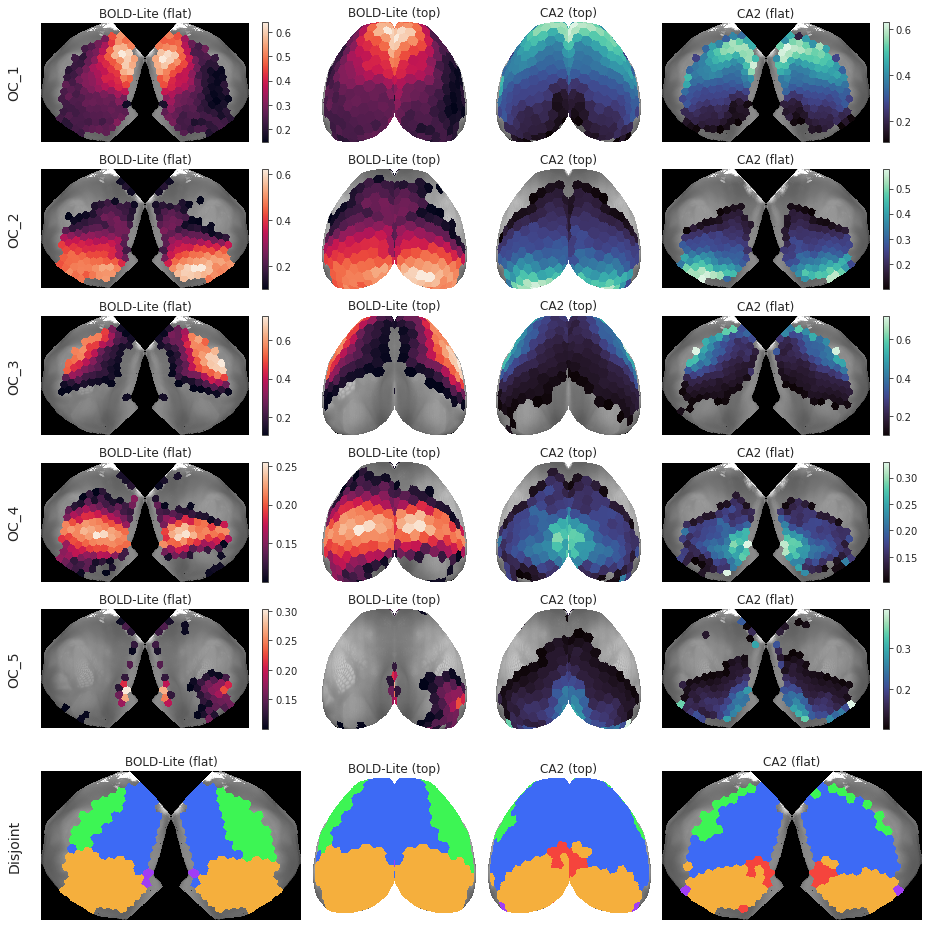

In [74]:
gr.show(proj_bold, proj_ca, cmaps=('rocket', 'mako'), labels=('BOLD-Lite', 'CA2'))

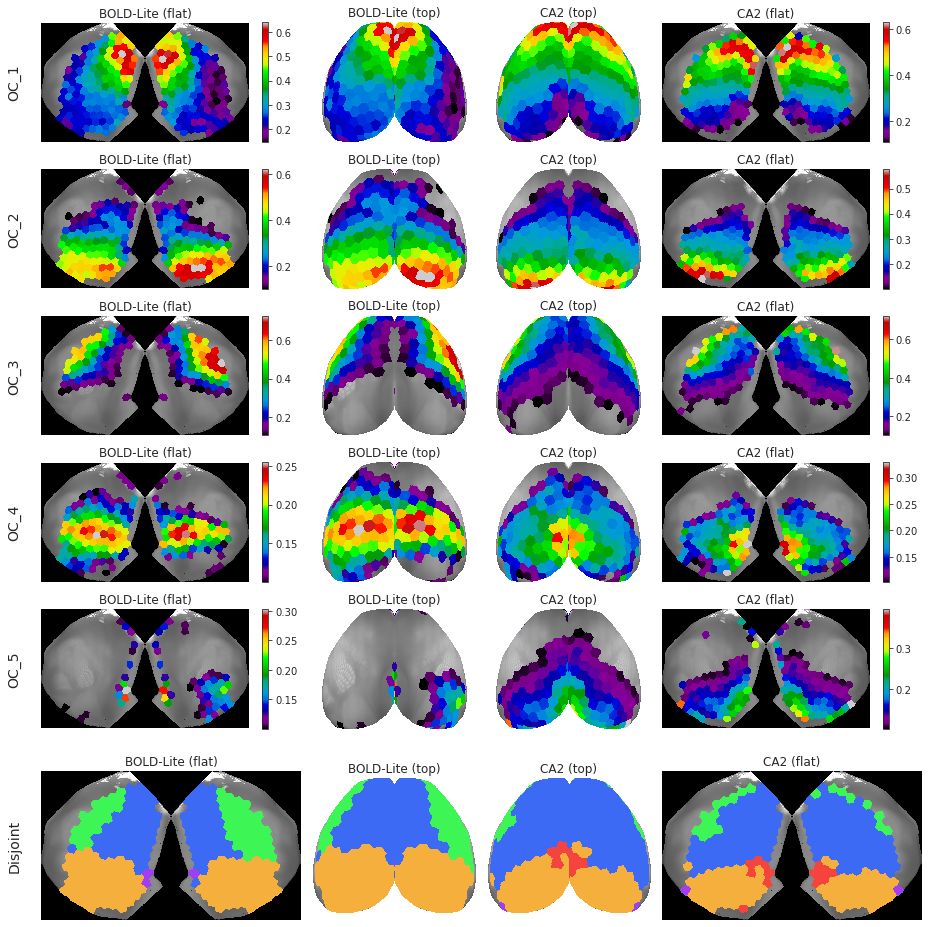

In [75]:
gr.show(proj_bold, proj_ca, cmaps=('nipy_spectral',) * 2, labels=('BOLD-Lite', 'CA2'))

In [76]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-sample',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'prepare_data': False,
    'verbose': False,
}

In [77]:
def give_me_pi(mode):
    proc, *_ = mice.get_data_containers(mode)
    pi_avg = []
    for key in proc:
        if 'run' not in key:
            continue
        sv = SVINET(key=key, mode=mode, **props)
        _ = sv.load_results()
        if sv.pi is not None:
            pi_avg.append(np.expand_dims(sv.pi, 0))
        else:
            continue
    pi_avg = np.concatenate(pi_avg)
    pi_avg = bn.nanmean(pi_avg, axis=0)
    comm_vec = sv.get_disjoint_community(pi_avg, to_vec=True)
    pi_full = np.concatenate([pi_avg, np.expand_dims(comm_vec, 0)])
    return pi_full

In [78]:
pi_ca = give_me_pi('ca2')
pi_ca.shape

(6, 302)

In [79]:
gr = Group(mode='ca2', **props)
proj_ca = gr.project_vec(pi_ca)

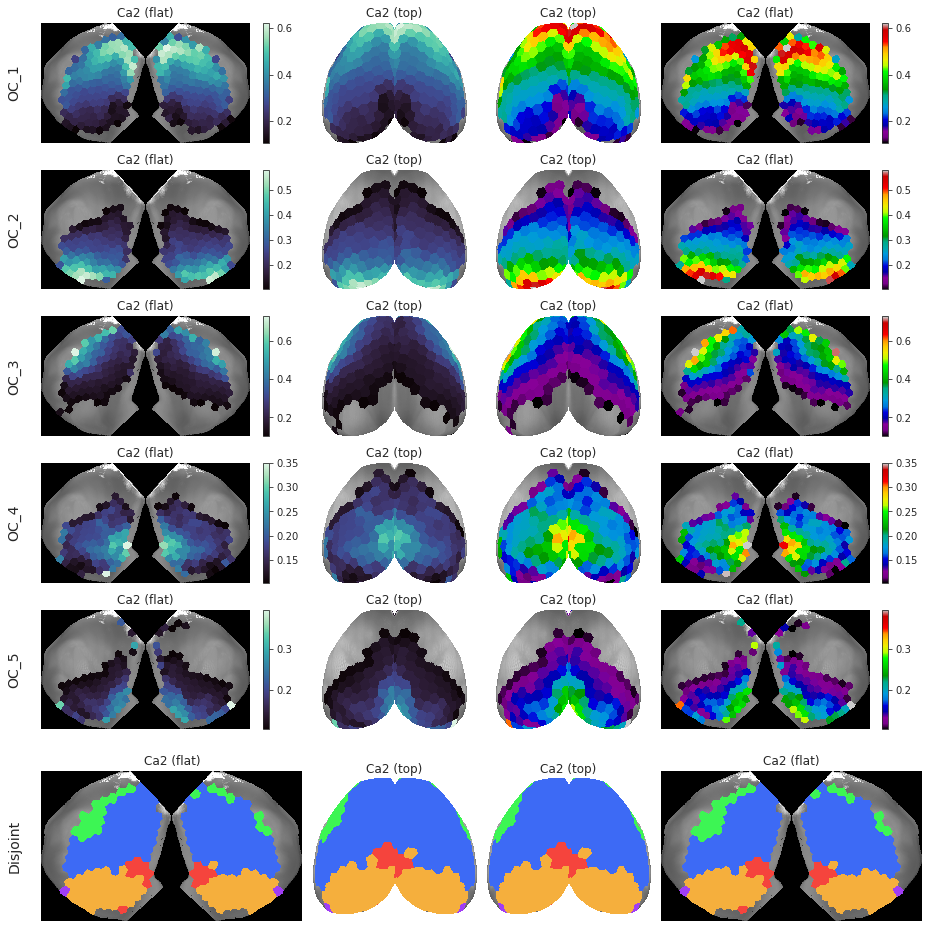

In [80]:
gr.show(proj_ca, labels=('Ca2',) * 2, cmaps=('mako', 'nipy_spectral'))

In [81]:
pi_bold = give_me_pi('bold-lite')
pi_bold.shape

(6, 302)

In [82]:
gr = Group(mode='bold-lite', **props)
proj_bold = gr.project_vec(pi_bold)

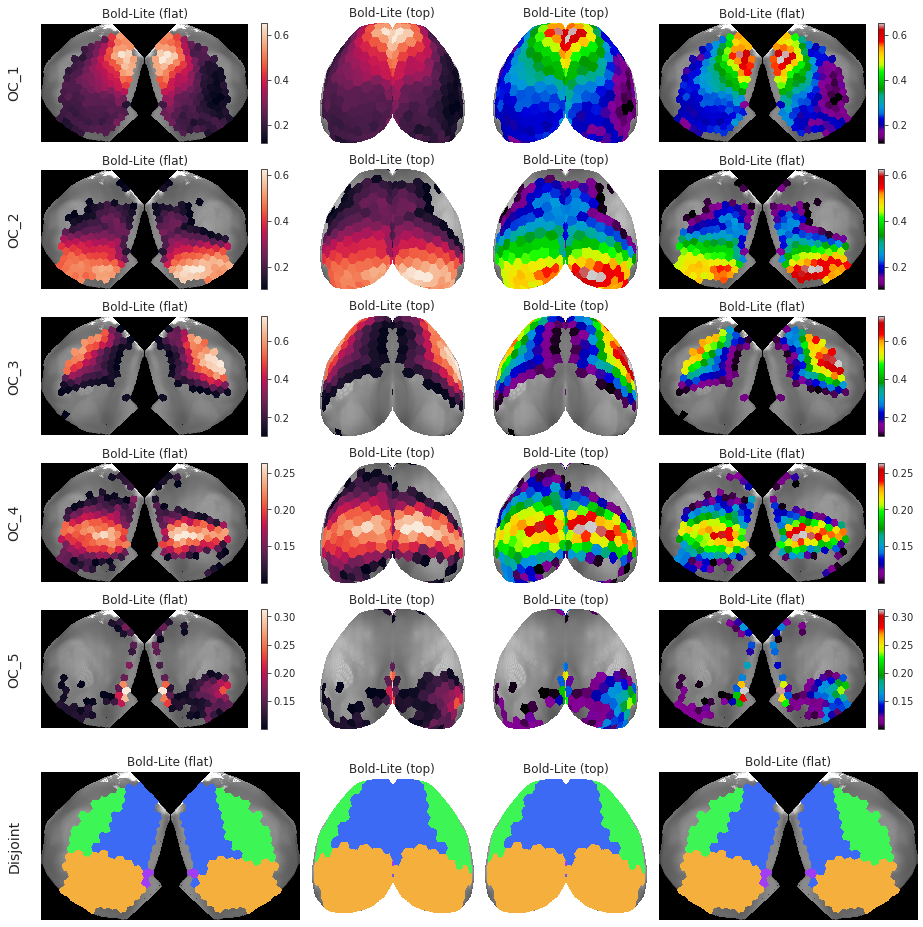

In [83]:
gr.show(proj_bold, labels=('Bold-Lite',) * 2)

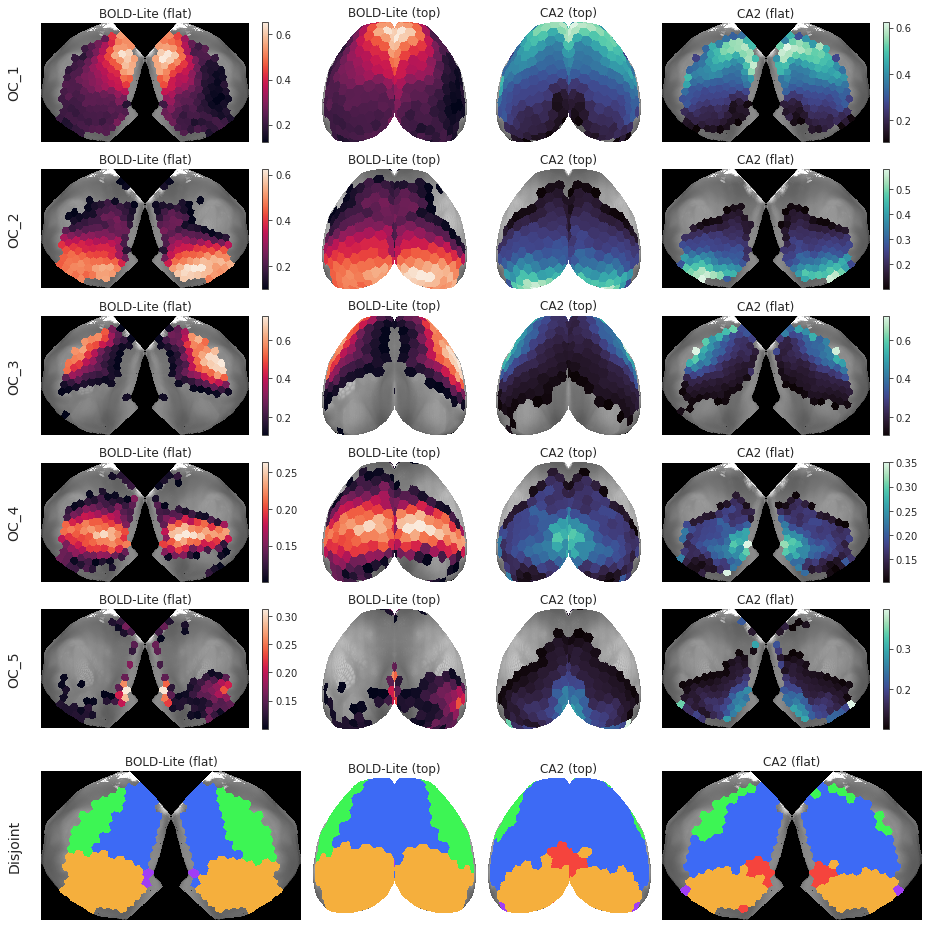

In [84]:
gr.show(proj_bold, proj_ca, cmaps=('rocket', 'mako'), labels=('BOLD-Lite', 'CA2'))

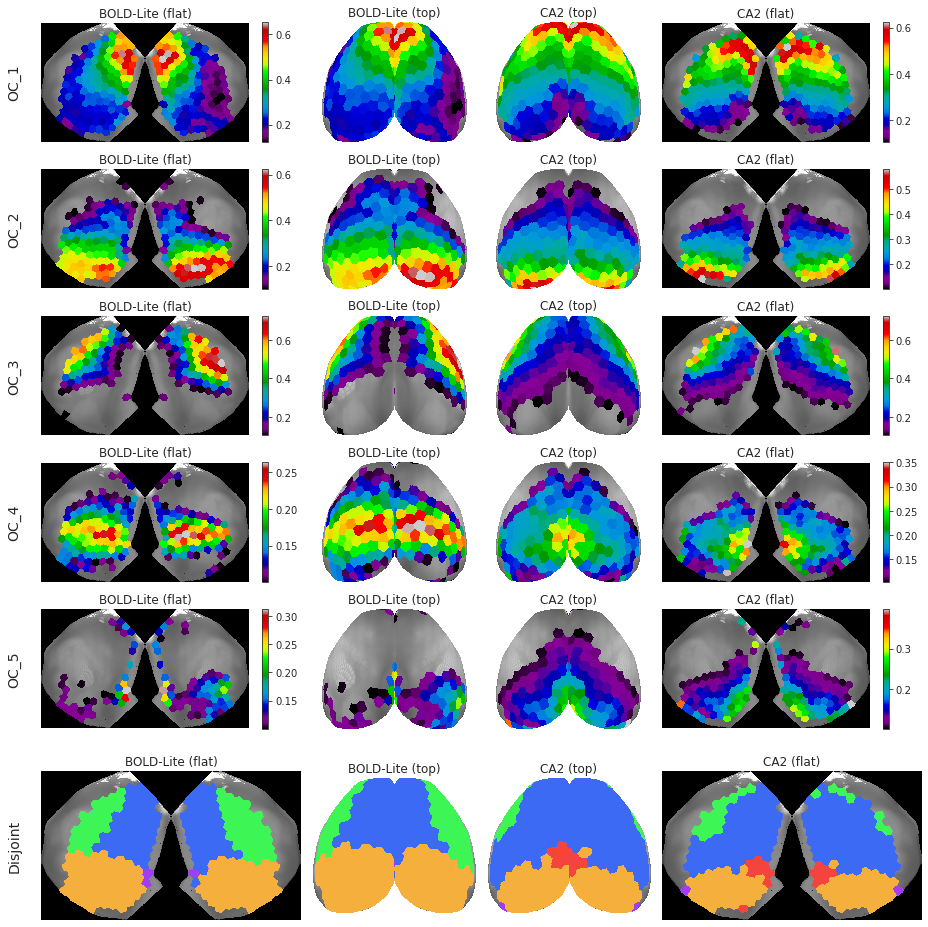

In [85]:
gr.show(proj_bold, proj_ca, cmaps=('nipy_spectral',) * 2, labels=('BOLD-Lite', 'CA2'))

In [23]:
sv = SVINET(key='sub-SLC', mode='ca2', **props)
_ = sv.load_results()

comm_vec = sv.get_disjoint_community(sv.pi, to_vec=True)
pi_mega_ca = np.concatenate([sv.pi, np.expand_dims(comm_vec, 0)])
proj_mega_ca = sv.project_vec(pi_mega_ca)

sv = SVINET(key='sub-SLC', mode='bold-lite', **props)
_ = sv.load_results()

comm_vec = sv.get_disjoint_community(sv.pi, to_vec=True)
pi_mega_bold = np.concatenate([sv.pi, np.expand_dims(comm_vec, 0)])
proj_mega_bold = sv.project_vec(pi_mega_bold)

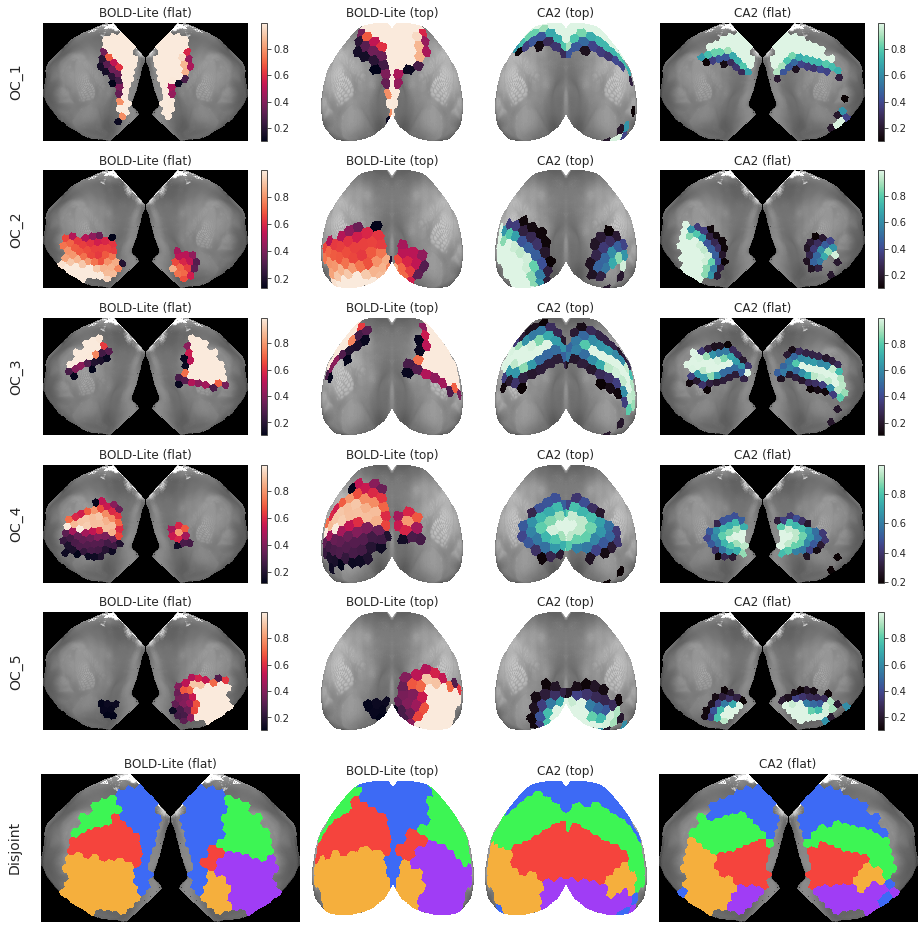

In [25]:
gr.show(proj_mega_bold, proj_mega_ca, cmaps=('rocket', 'mako'), labels=('BOLD-Lite', 'CA2'))

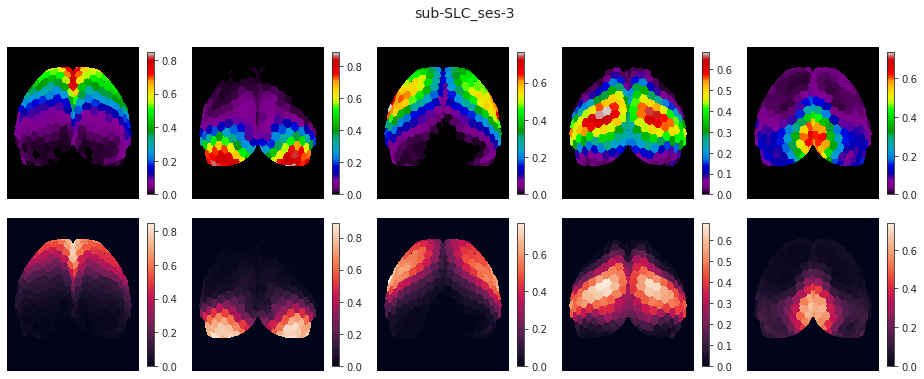

In [28]:
fig, axes = create_figure(2, 5, (13, 5.5))
for i in range(5):
    ax = axes[0, i]
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[1, i]
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

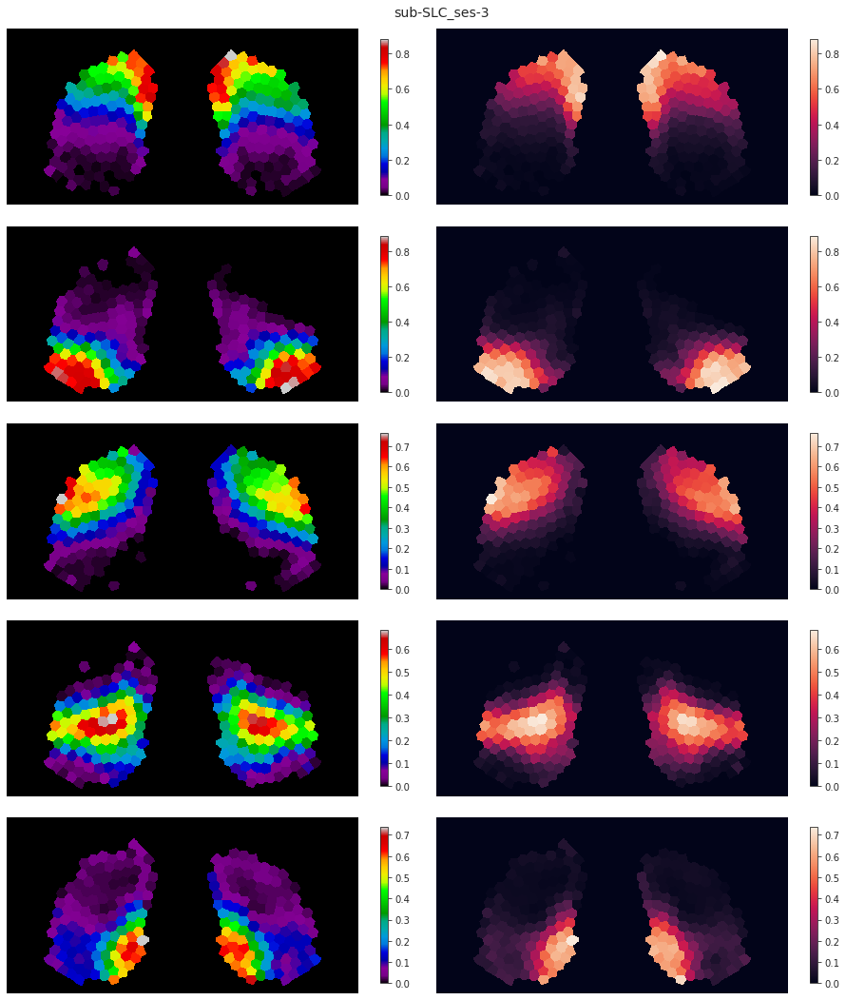

In [29]:
fig, axes = create_figure(5, 2, (13, 15))
for i in range(5):
    ax = axes[i, 0]
    im = ax.imshow(proj['parcel2d-flat'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[i, 1]
    im = ax.imshow(proj['parcel2d-flat'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

In [30]:
import ants

topview = 'topview_10um.nii.gz'
topview = pjoin(mice.cfg.base_dir, topview)
topview = ants.image_read(topview, pixeltype='unsigned int')
topview = topview.numpy()

flatmap = 'flatmap_10um.nii.gz'
flatmap = pjoin(mice.cfg.base_dir, flatmap)
flatmap = ants.image_read(flatmap, pixeltype='unsigned int')
flatmap = flatmap.numpy()

In [65]:
np.expand_dims([0, 1, 2], 1)

array([[0],
       [1],
       [2]])

In [57]:
proj_top = list(proj['parcel2d-top'])

results = filter_boundaries(
    x_list=[topview] + proj_top, mask=topview > 0)
topview_tr = results.pop(0)
proj_top = np.concatenate([np.expand_dims(e, axis=0) for e in results])

proj_flat = list(proj['parcel2d-flat'])

results = filter_boundaries(
    x_list=[flatmap] + proj_flat, mask=flatmap > 0)
flatmap_tr = results.pop(0)
proj_flat = np.concatenate([np.expand_dims(e, axis=0) for e in results])

<matplotlib.image.AxesImage object at 0x7f0fd644ca30>

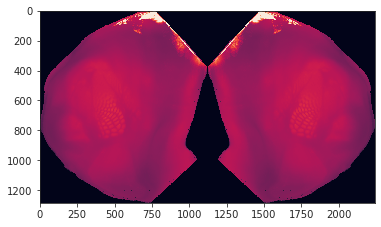

In [59]:
plt.imshow(flatmap_tr)

<matplotlib.image.AxesImage object at 0x7f0ff80350d0>

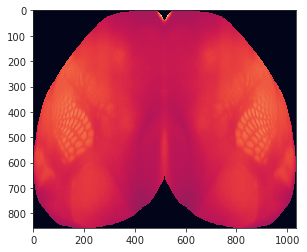

In [60]:
plt.imshow(topview_tr)

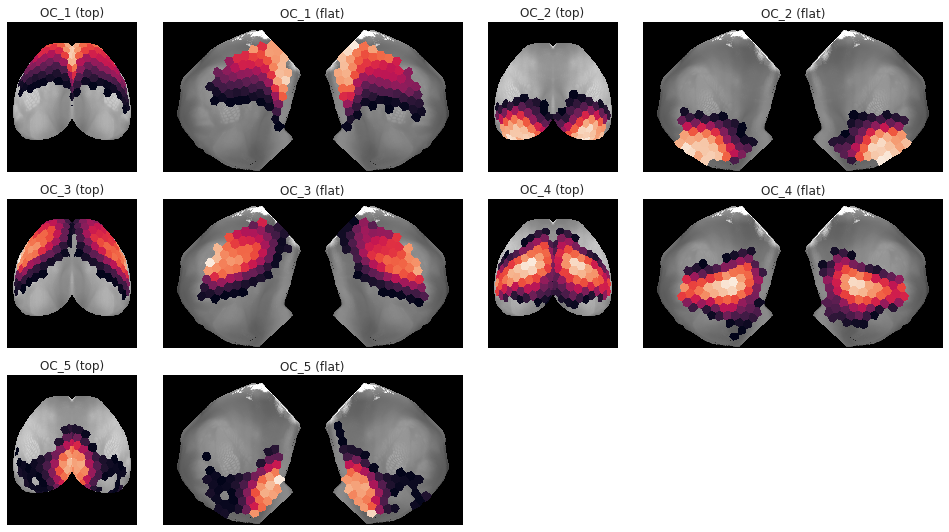

In [38]:
ncols = 4
nrows = int(np.ceil(len(pi_avg) / (ncols / 2)))
fig, axes = create_figure(nrows, ncols, (13.5, 2.5 * nrows), gridspec_kw={'width_ratios': [1, 2, 1, 2]})

min_thres = 0.1

for i in range(len(pi_avg)):
    # cmap = get_cluster_cmap(range(len(pi_avg)))
    data_top = proj['parcel2d-top'][i]
    data_flat = proj['parcel2d-flat'][i]

    data2plt = np.ma.masked_where(data_top < min_thres, data_top)
    ax = axes.ravel()[i * 2]
    ax.imshow(topview, cmap='Greys_r')
    ax.imshow(data2plt, cmap='rocket')
    ax.set_title(f"OC_{i+1} (top)")

    data2plt = np.ma.masked_where(data_flat < min_thres, data_flat)
    ax = axes.ravel()[i * 2 + 1]
    ax.imshow(flatmap, cmap='Greys_r')
    ax.imshow(data2plt, cmap='rocket')
    ax.set_title(f"OC_{i+1} (flat)")

trim_axs(axes, 2 * len(pi_avg))
remove_ticks(axes)
plt.show()

In [57]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-sample',
    'metric': 'pearson',
    'match_metric': 'cosine',
    'match_using': 'pi',
    'prepare_data': False,
    'verbose': False,
}

In [58]:
pi_avg = []
for key in tqdm(mice.bold):
    if 'run' not in key:
        continue
    sv = SVINET(key=key, mode='bold-lite', **props)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    else:
        continue

  0%|          | 0/160 [00:00<?, ?it/s]

In [59]:
pi_avg = np.concatenate(pi_avg)
pi_avg.shape

(114, 5, 302)

In [60]:
pi_avg = bn.nanmean(pi_avg, axis=0)
pi_avg.shape

(5, 302)

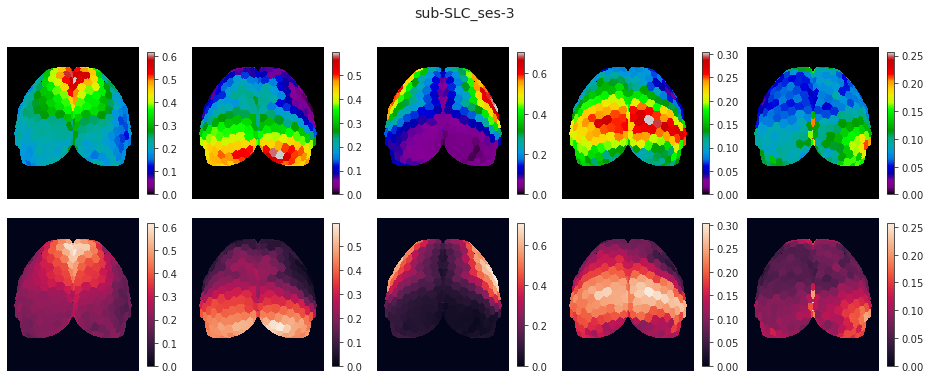

In [61]:
proj = sv.project_vec(pi_avg)

fig, axes = create_figure(2, 5, (13, 5.5))
for i in range(5):
    ax = axes[0, i]
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[1, i]
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

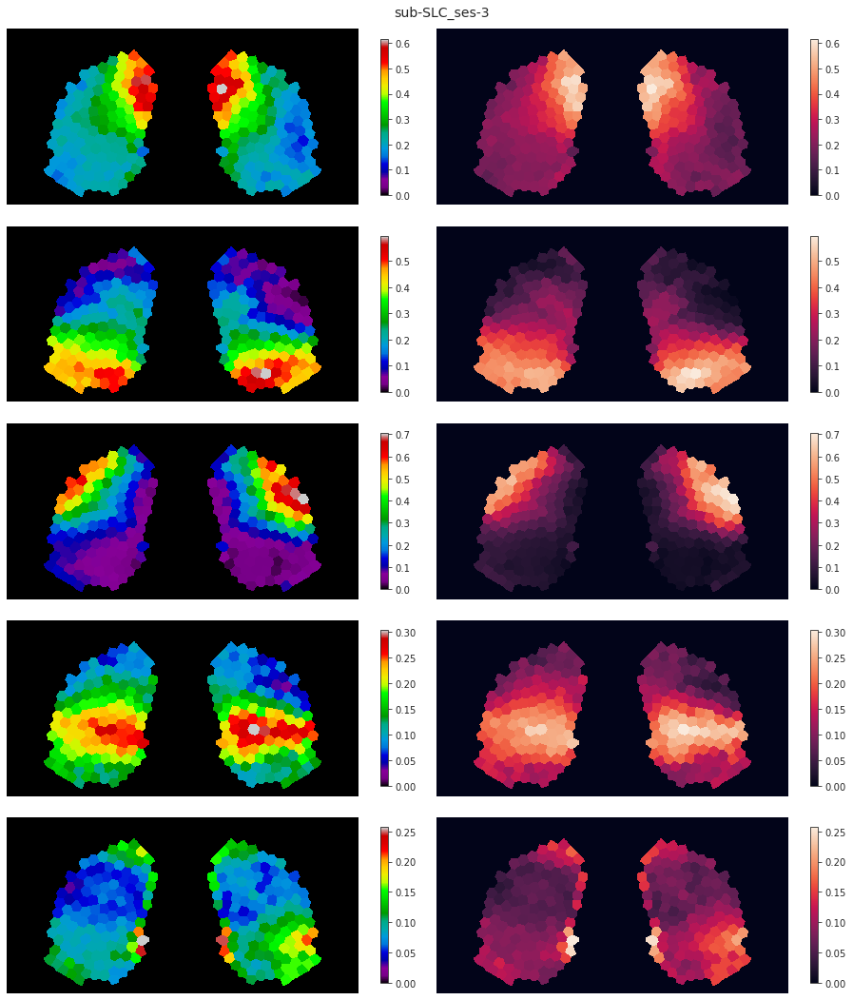

In [62]:
fig, axes = create_figure(5, 2, (13, 15))
for i in range(5):
    ax = axes[i, 0]
    im = ax.imshow(proj['parcel2d-flat'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[i, 1]
    im = ax.imshow(proj['parcel2d-flat'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

In [63]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-sample',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'prepare_data': False,
    'verbose': False,
}

key = 'sub-SLC'
sv = SVINET(key=key, mode='ca2', **props)
_ = sv.load_results()
proj = sv.project_vec(sv.pi)

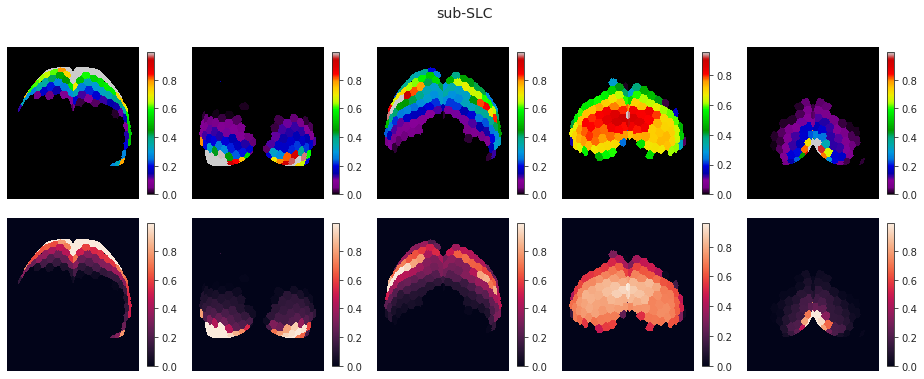

In [64]:
fig, axes = create_figure(2, 5, (13, 5.5))
for i in range(5):
    ax = axes[0, i]
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[1, i]
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

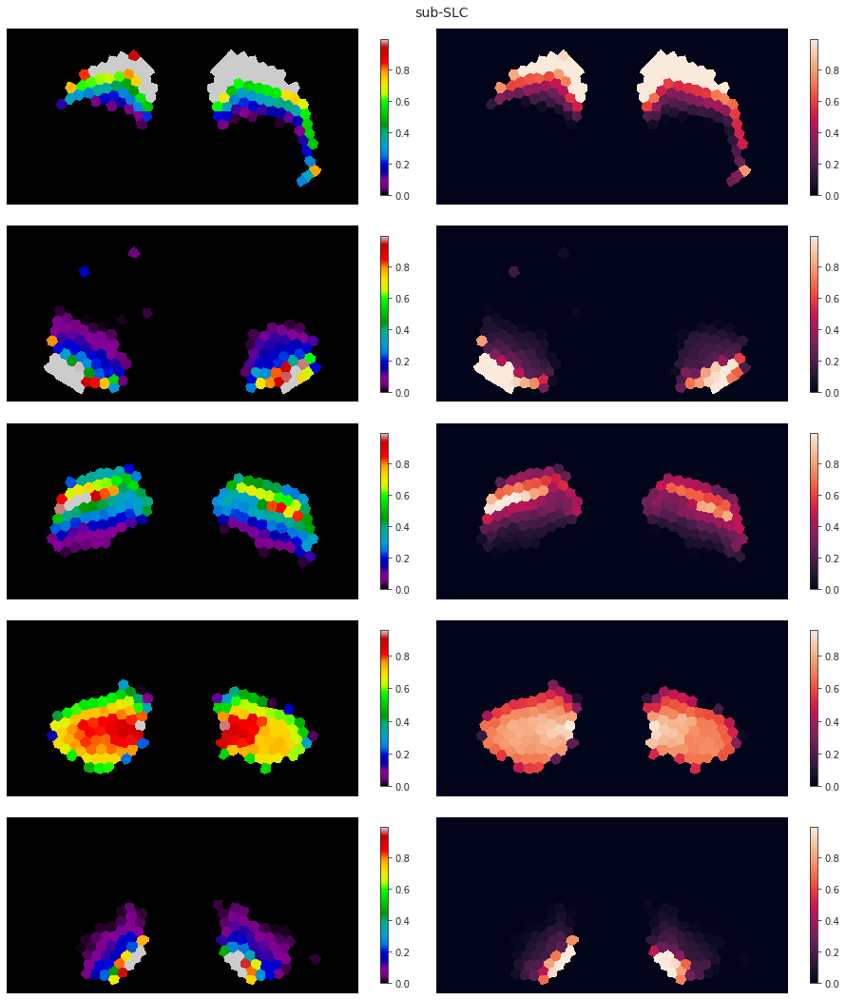

In [67]:
fig, axes = create_figure(5, 2, (13, 15))
for i in range(5):
    ax = axes[i, 0]
    im = ax.imshow(proj['parcel2d-flat'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[i, 1]
    im = ax.imshow(proj['parcel2d-flat'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

[
    <matplotlib.lines.Line2D object at 0x7f2fbf2fcd30>,
    <matplotlib.lines.Line2D object at 0x7f2fbf2fce50>,
    <matplotlib.lines.Line2D object at 0x7f2fbf2fcf40>,
    <matplotlib.lines.Line2D object at 0x7f2fbf30f070>,
    <matplotlib.lines.Line2D object at 0x7f2fbf30f160>
]

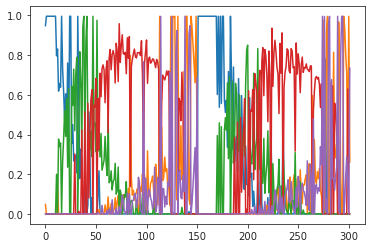

In [65]:
plt.plot(sv.pi.T)

<AxesSubplot:ylabel='Density'>

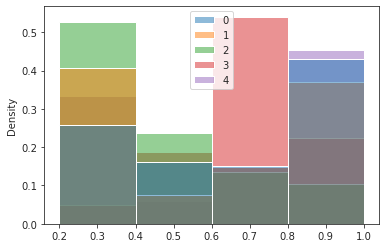

In [66]:
sns.histplot(sv.pi.T, bins=np.linspace(0.2, 1.0, 5), stat='density')

In [23]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-sample',
    'metric': 'pearson',
    'match_metric': 'cosine',
    'match_using': 'pi',
    'prepare_data': False,
    'verbose': False,
}

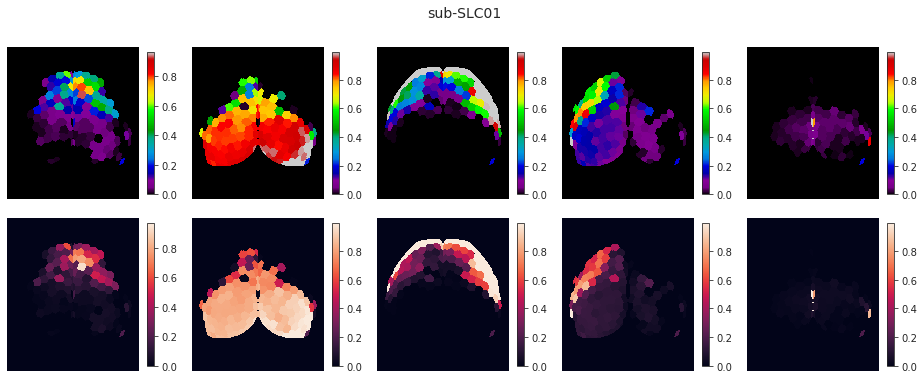

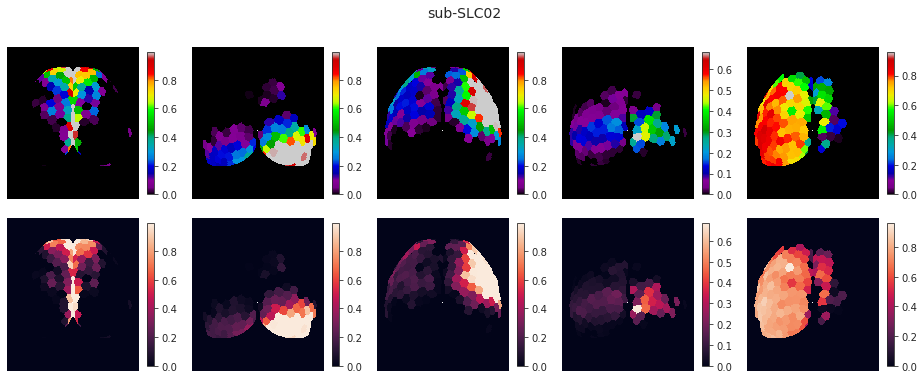

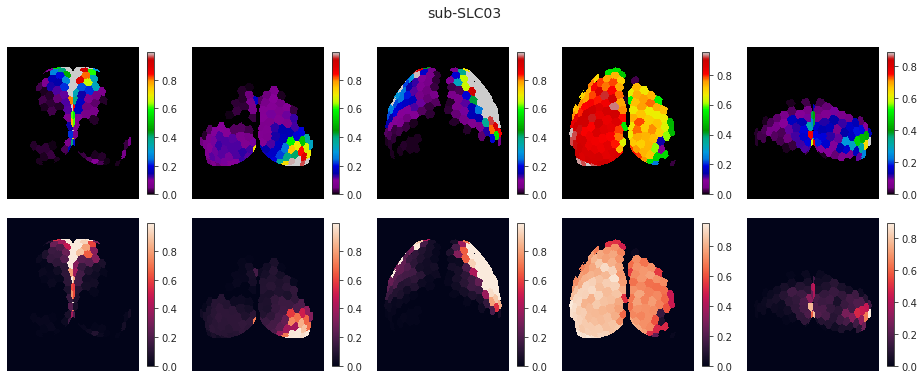

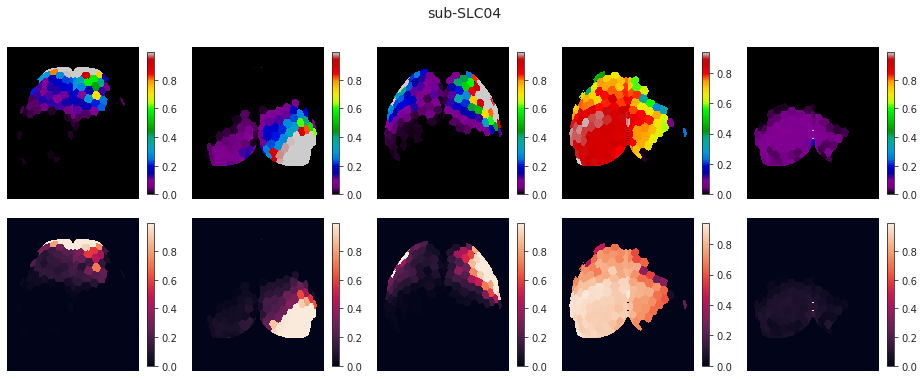

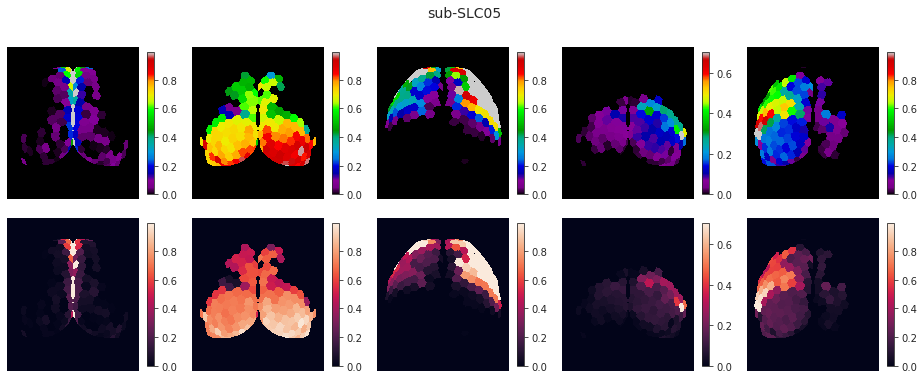

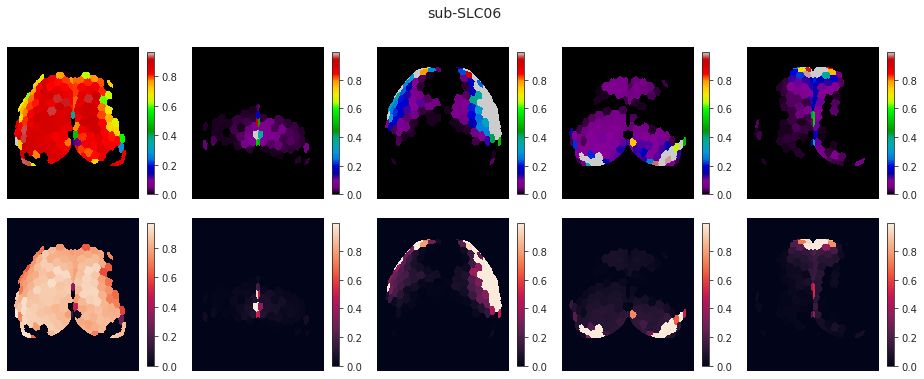

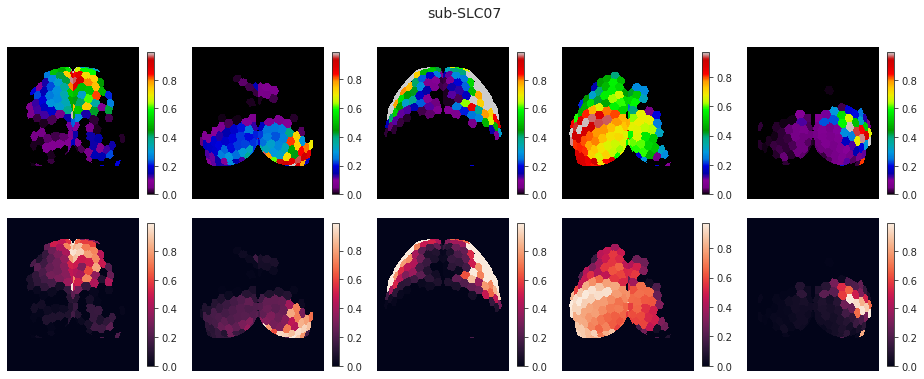

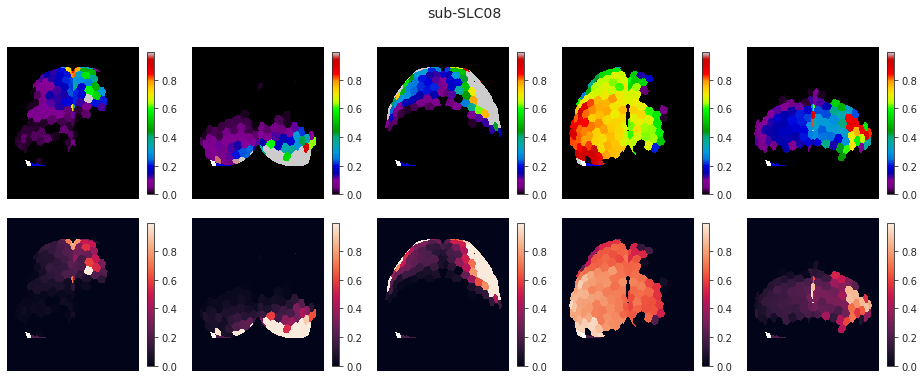

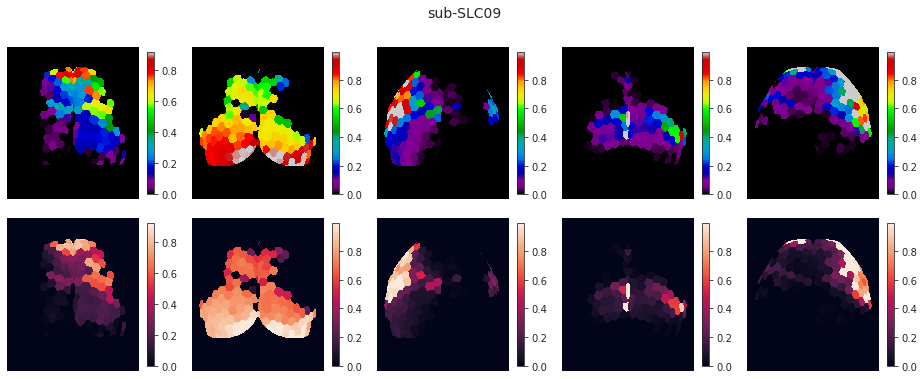

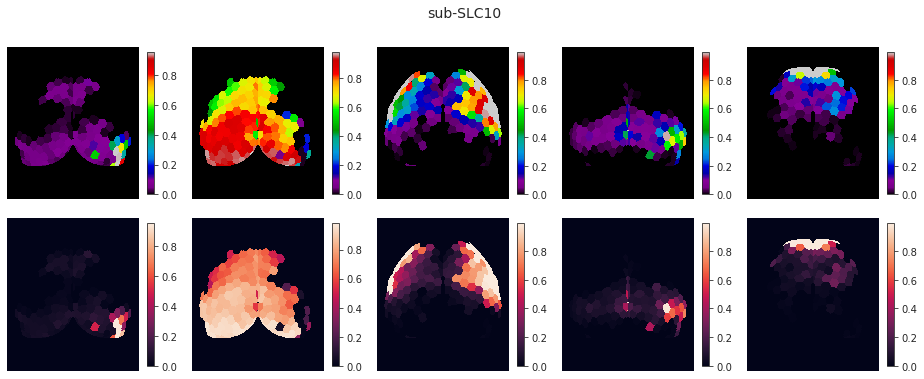

In [24]:
for sub in mice.cfg.sub_ids:
    key = f'sub-SLC{sub:02d}'
    sv = SVINET(key=key, mode='bold-lite', **props)
    _ = sv.load_results()
    proj = sv.project_vec(sv.pi)

    fig, axes = create_figure(2, 5, (13, 5.5))
    for i in range(5):
        ax = axes[0, i]
        im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
        plt.colorbar(im, ax=ax, shrink=0.8)

        ax = axes[1, i]
        im = ax.imshow(proj['parcel2d-top'][i])
        plt.colorbar(im, ax=ax, shrink=0.8)
    fig.suptitle(key, fontsize=14)
    remove_ticks(axes)
    plt.show()

In [27]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-sample',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'prepare_data': False,
    'verbose': False,
}

key = 'sub-SLC'
sv = SVINET(key=key, mode='bold-lite', **props)
_ = sv.load_results()
proj = sv.project_vec(sv.pi)

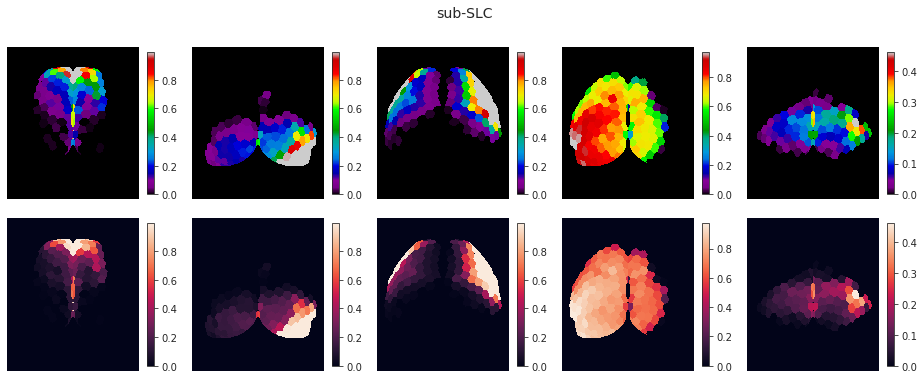

In [28]:
fig, axes = create_figure(2, 5, (13, 5.5))
for i in range(5):
    ax = axes[0, i]
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[1, i]
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

In [29]:
sv.pi_all.shape

(980, 5, 302)

In [30]:
nonzero = sv.pi_all.sum(-2, keepdims=True) != 0
pi_all = np.where(nonzero, sv.pi_all, np.nan)

In [31]:
pi = bn.nanmedian(pi_all, 0)

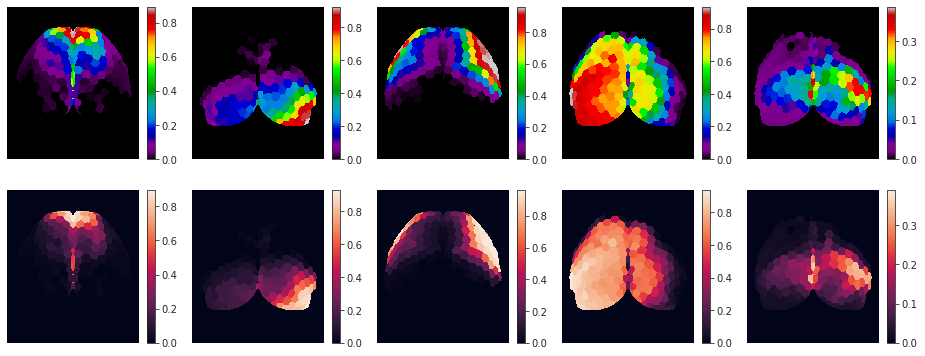

In [34]:
pi = bn.nanmean(pi_all, 0)
proj = sv.project_vec(pi)

fig, axes = create_figure(2, 5, (13, 5.5))
for i in range(5):
    ax = axes[0, i]
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)

    ax = axes[1, i]
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)

remove_ticks(axes)
plt.show()

### Old

In [ ]:
props = {
    'mice': mice,
    'num_k': 5,
    'perc': 'p40-sample',
    'metric': 'pearson',
    'match_metric': 'euclidean',
    'match_using': 'gam',
    'verbose': False,
}

In [5]:
pi_avg = []
for key in tqdm(mice.ca):
    if 'run' not in key:
        continue
    sv = SVINET(key=key, mode='ca2', **props)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    # proj = sv.project_vec()
    
    # fig, axes = create_figure(1, 5, (13, 3.))
    # for i, ax in enumerate(axes.flat):
    #     im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    #     plt.colorbar(im, ax=ax, shrink=0.8)
    # fig.suptitle(key, fontsize=14)
    # remove_ticks(axes)
    # plt.show()

  0%|          | 0/162 [00:00<?, ?it/s]

In [6]:
pi_avg = np.concatenate(pi_avg)
pi_avg.shape

(118, 5, 302)

In [7]:
pi_ca_runs = np.nanmean(pi_avg, 0)

In [8]:
proj = sv.project_vec(pi_ca_runs)

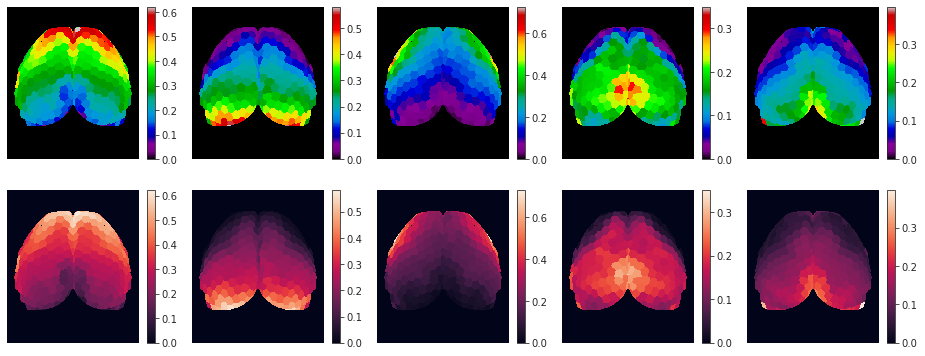

In [9]:
fig, axes = create_figure(2, 5, (13, 5.5))
for i in range(5):
    ax = axes[0, i]
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)
    
    ax = axes[1, i]
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
remove_ticks(axes)
plt.show()

<matplotlib.image.AxesImage object at 0x7f38306aea60>

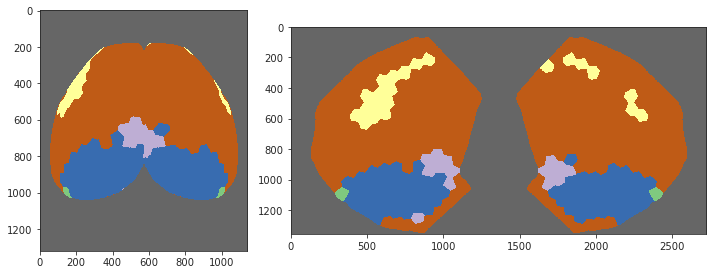

In [10]:
fig, axes = create_figure(1, 2, (10, 4), gridspec_kw={'width_ratios': [1, 2]})

x_ca_runs = np.nanargmax(proj['parcel2d-top'], axis=0)
x_ca_runs.flat[mice.parcel['nonzero-idxs_parcel2d-top']] += 1
axes[0].imshow(x_ca_runs, cmap='Accent_r')

y_ca_runs = np.nanargmax(proj['parcel2d-flat'], axis=0)
y_ca_runs.flat[mice.parcel['nonzero-idxs_parcel2d-flat']] += 1
axes[1].imshow(y_ca_runs, cmap='Accent_r')

In [11]:
pi_avg = []
for key in tqdm(mice.ca):
    sub, ses, run = mice.looper[key]
    if sub == -1 or ses == -1 or run != -1:
        continue
    sv = SVINET(mice, 5, 'p40-sample', key, 'ca2', metric='pearson', verbose=False)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    # proj = sv.project_vec()
    
    # fig, axes = create_figure(1, 5, (13, 3.))
    # for i, ax in enumerate(axes.flat):
    #     im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    #     plt.colorbar(im, ax=ax, shrink=0.8)
    # fig.suptitle(key, fontsize=14)
    # remove_ticks(axes)
    # plt.show()

  0%|          | 0/162 [00:00<?, ?it/s]

In [12]:
pi_avg = np.concatenate(pi_avg)
pi_avg.shape

(30, 5, 302)

In [13]:
pi_ca_sess = np.nanmean(pi_avg, 0)

In [14]:
proj = sv.project_vec(pi_ca_sess)

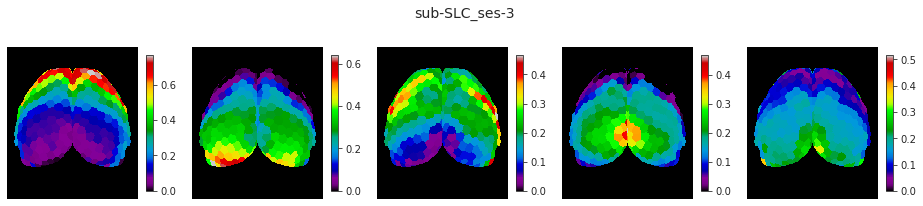

In [15]:
fig, axes = create_figure(1, 5, (13, 3.))
for i, ax in enumerate(axes.flat):
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

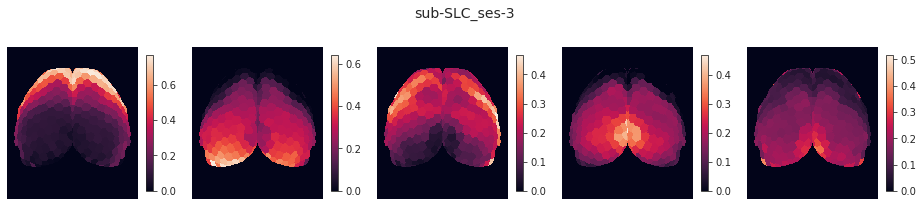

In [16]:
fig, axes = create_figure(1, 5, (13, 3.))
for i, ax in enumerate(axes.flat):
    im = ax.imshow(proj['parcel2d-top'][i])
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

<matplotlib.image.AxesImage object at 0x7f4fe55514c0>

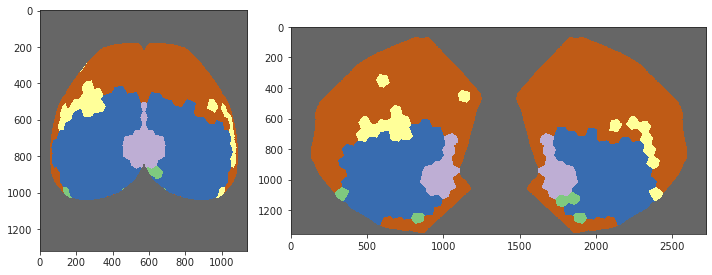

In [17]:
fig, axes = create_figure(1, 2, (10, 4), gridspec_kw={'width_ratios': [1, 2]})

x_ca_sess = np.nanargmax(proj['parcel2d-top'], axis=0)
x_ca_sess.flat[mice.parcel['nonzero-idxs_parcel2d-top']] += 1
axes[0].imshow(x_ca_sess, cmap='Accent_r')

y_ca_sess = np.nanargmax(proj['parcel2d-flat'], axis=0)
y_ca_sess.flat[mice.parcel['nonzero-idxs_parcel2d-flat']] += 1
axes[1].imshow(y_ca_sess, cmap='Accent_r')

In [18]:
pi_avg = []
for key in tqdm(mice.bold):
    if 'run' not in key:
        continue
    sv = SVINET(mice, 5, 'p40-sample', key, 'bold-lite', metric='pearson', verbose=False)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    # proj = sv.project_vec()
    
    # fig, axes = create_figure(1, 5, (13, 3.))
    # for i, ax in enumerate(axes.flat):
    #     im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    #     plt.colorbar(im, ax=ax, shrink=0.8)
    # fig.suptitle(key, fontsize=14)
    # remove_ticks(axes)
    # plt.show()

  0%|          | 0/160 [00:00<?, ?it/s]

Warning, fits dir is empty

Warning, fits dir is empty

In [19]:
pi_avg = np.concatenate(pi_avg)
pi_avg.shape

(114, 5, 302)

In [20]:
pi_bl_runs = np.nanmean(pi_avg, 0)

In [21]:
proj = sv.project_vec(pi_bl_runs)

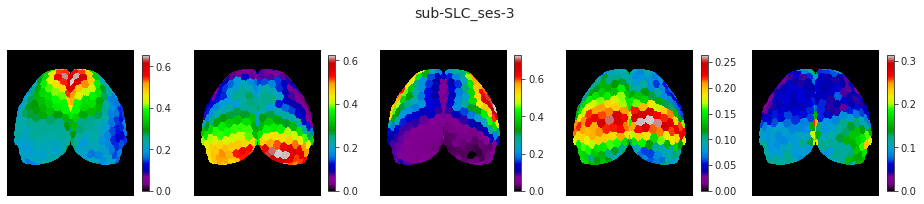

In [22]:
fig, axes = create_figure(1, 5, (13, 3.))
for i, ax in enumerate(axes.flat):
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

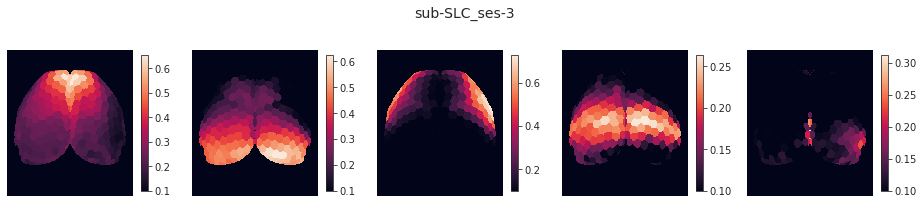

In [23]:
fig, axes = create_figure(1, 5, (13, 3.))
for i, ax in enumerate(axes.flat):
    im = ax.imshow(proj['parcel2d-top'][i], vmin=0.1)
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

<matplotlib.image.AxesImage object at 0x7f4fe5f78d60>

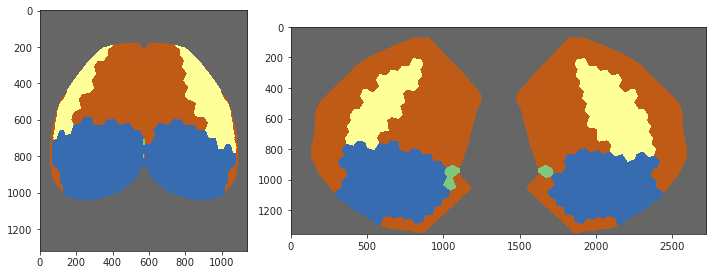

In [24]:
fig, axes = create_figure(1, 2, (10, 4), gridspec_kw={'width_ratios': [1, 2]})

x_bl_runs = np.nanargmax(proj['parcel2d-top'], axis=0)
x_bl_runs.flat[mice.parcel['nonzero-idxs_parcel2d-top']] += 1
axes[0].imshow(x_bl_runs, cmap='Accent_r')

y_bl_runs = np.nanargmax(proj['parcel2d-flat'], axis=0)
y_bl_runs.flat[mice.parcel['nonzero-idxs_parcel2d-flat']] += 1
axes[1].imshow(y_bl_runs, cmap='Accent_r')

In [25]:
pi_avg = []
for key in tqdm(mice.bold):
    sub, ses, run = mice.looper[key]
    if sub == -1 or ses == -1 or run != -1:
        continue
    sv = SVINET(mice, 5, 'p40-sample', key, 'bold-lite', metric='pearson', verbose=False)
    _ = sv.load_results()
    if sv.pi is not None:
        pi_avg.append(np.expand_dims(sv.pi, axis=0))
    # proj = sv.project_vec()
    
    # fig, axes = create_figure(1, 5, (13, 3.))
    # for i, ax in enumerate(axes.flat):
    #     im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    #     plt.colorbar(im, ax=ax, shrink=0.8)
    # fig.suptitle(key, fontsize=14)
    # remove_ticks(axes)
    # plt.show()

  0%|          | 0/160 [00:00<?, ?it/s]

In [26]:
pi_avg = np.concatenate(pi_avg)
pi_avg.shape

(30, 5, 302)

In [27]:
pi_bl_sess = np.nanmean(pi_avg, 0)

In [28]:
proj = sv.project_vec(pi_bl_sess)

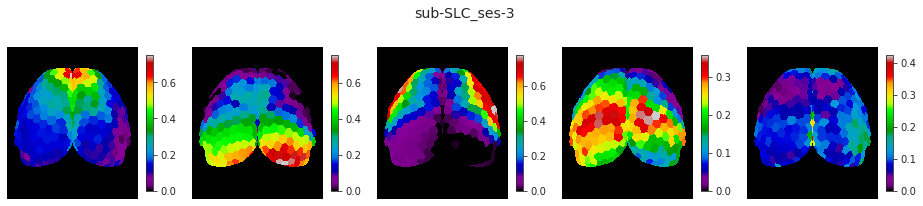

In [29]:
fig, axes = create_figure(1, 5, (13, 3.))
for i, ax in enumerate(axes.flat):
    im = ax.imshow(proj['parcel2d-top'][i], cmap='nipy_spectral')
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

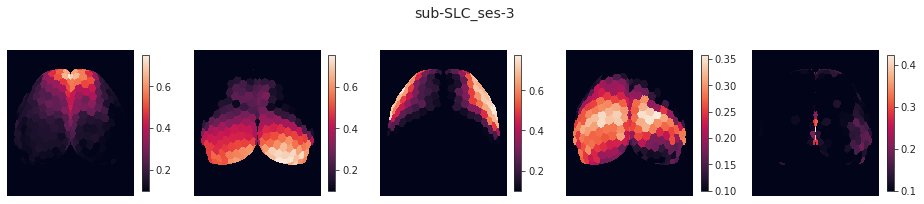

In [30]:
fig, axes = create_figure(1, 5, (13, 3.))
for i, ax in enumerate(axes.flat):
    im = ax.imshow(proj['parcel2d-top'][i], vmin=0.1)
    plt.colorbar(im, ax=ax, shrink=0.8)
fig.suptitle(key, fontsize=14)
remove_ticks(axes)
plt.show()

<matplotlib.image.AxesImage object at 0x7f4fe56755b0>

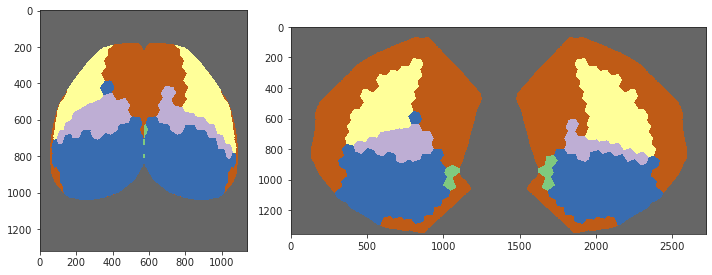

In [31]:
fig, axes = create_figure(1, 2, (10, 4), gridspec_kw={'width_ratios': [1, 2]})

x_bl_sess = np.nanargmax(proj['parcel2d-top'], axis=0)
x_bl_sess.flat[mice.parcel['nonzero-idxs_parcel2d-top']] += 1
axes[0].imshow(x_bl_sess, cmap='Accent_r')

y_bl_sess = np.nanargmax(proj['parcel2d-flat'], axis=0)
y_bl_sess.flat[mice.parcel['nonzero-idxs_parcel2d-flat']] += 1
axes[1].imshow(y_bl_sess, cmap='Accent_r')

In [32]:
d = sp_dist.cdist(pi_ca_runs, pi_ca_sess, metric='cosine')
sim = dist2sim(d)

<matplotlib.colorbar.Colorbar object at 0x7f4fe52de520>

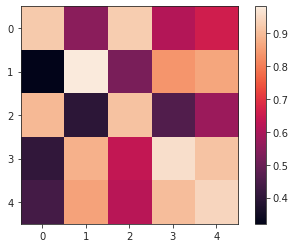

In [33]:
plt.imshow(sim)
plt.colorbar()

In [34]:
np.diag(sim)

array([0.92393911, 0.9826448 , 0.91149122, 0.96107837, 0.94567248])

<matplotlib.colorbar.Colorbar object at 0x7f4fe4752880>

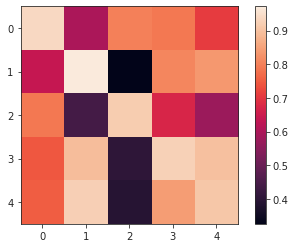

In [55]:
d = sp_dist.cdist(pi_ca_runs, pi_bl_runs, metric='cosine')
sim = dist2sim(d)

plt.imshow(sim)
plt.colorbar()

In [56]:
np.diag(sim), np.diag(sim).mean()

(
    array([0.93938741, 0.97217728, 0.92158353, 0.92783819, 0.90999917]),
    0.9341971171773128
)

<matplotlib.colorbar.Colorbar object at 0x7f4fe4679310>

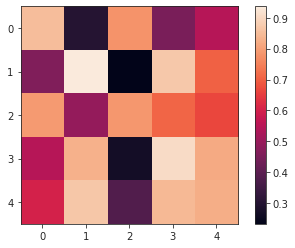

In [57]:
d = sp_dist.cdist(pi_ca_sess, pi_bl_sess, metric='cosine')
sim = dist2sim(d)

plt.imshow(sim)
plt.colorbar()

In [58]:
np.diag(sim), np.diag(sim).mean()

(
    array([0.85428295, 0.93676213, 0.78589216, 0.90661681, 0.82679314]),
    0.8620694371618273
)

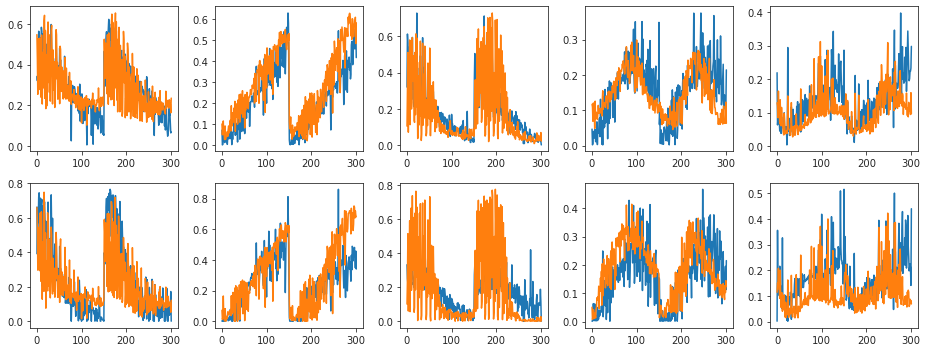

In [59]:
fig, axes = create_figure(2, 5, (13, 5))

for i in range(5):
    ax = axes[0, i]
    ax.plot(pi_ca_runs[i])
    ax.plot(pi_bl_runs[i])
    
    ax = axes[1, i]
    ax.plot(pi_ca_sess[i])
    ax.plot(pi_bl_sess[i])
plt.show()

<matplotlib.image.AxesImage object at 0x7f4fe42c1670>

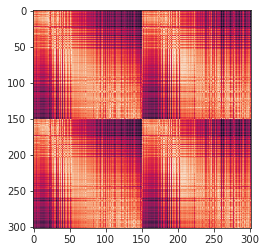

In [60]:
d = sp_dist.cdist(pi_ca_runs.T, pi_ca_sess.T, metric='jensenshannon')
sim_same = dist2sim(d)
plt.imshow(sim_same)

<matplotlib.image.AxesImage object at 0x7f4fe4218dc0>

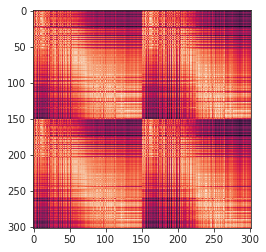

In [61]:
d = sp_dist.cdist(pi_ca_runs.T, pi_bl_runs.T, metric='jensenshannon')
sim_across = dist2sim(d)
plt.imshow(sim_across)

<AxesSubplot:ylabel='Count'>

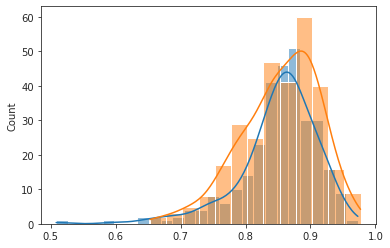

In [62]:
sns.histplot(np.diag(sim_same), kde=True)
sns.histplot(np.diag(sim_across), color='C1', kde=True)

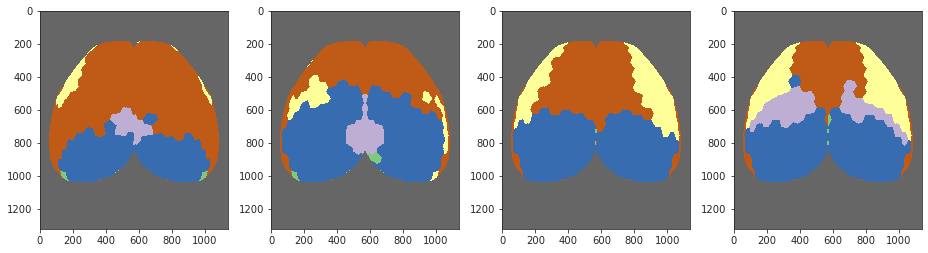

In [64]:
fig, axes = create_figure(1, 4, (13, 4))

axes[0].imshow(x_ca_runs, cmap='Accent_r')
axes[1].imshow(x_ca_sess, cmap='Accent_r')
axes[2].imshow(x_bl_runs, cmap='Accent_r')
axes[3].imshow(x_bl_sess, cmap='Accent_r')
plt.show()

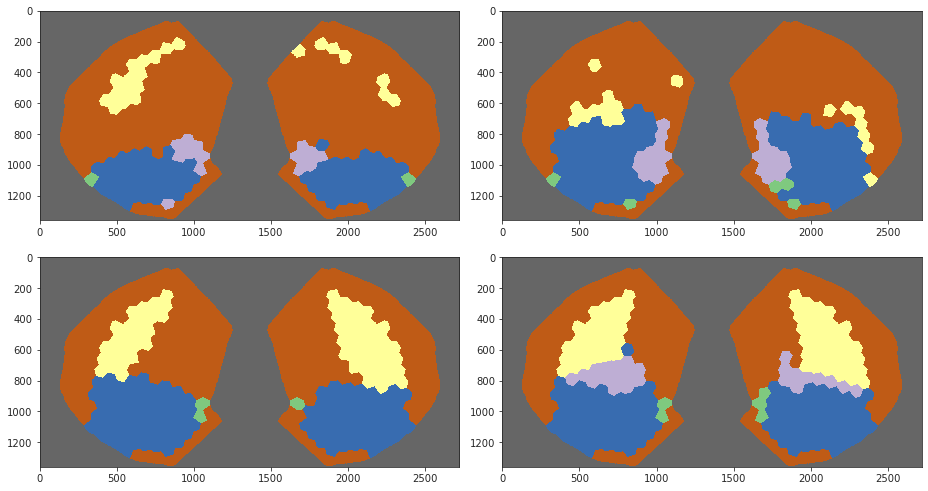

In [66]:
fig, axes = create_figure(2, 2, (13, 7))

axes.flat[0].imshow(y_ca_runs, cmap='Accent_r')
axes.flat[1].imshow(y_ca_sess, cmap='Accent_r')
axes.flat[2].imshow(y_bl_runs, cmap='Accent_r')
axes.flat[3].imshow(y_bl_sess, cmap='Accent_r')
plt.show()

In [4]:
gr = Group(mice, 5, 'p30-sample')

In [7]:
vars(gr)

{
    'style': {},
    'mode': 'bold',
    'task': 'rest',
    'metric': 'pearson',
    'verbose': True,
    'key': 'sub-SLC',
    'mice': <model.mouse.Mice object at 0x7fe3035fa700>,
    'n2l': {
        0: '1-1-0',
        1: '1-1-1',
        2: '1-1-2',
        3: '1-1-3',
        4: '1-2-0',
        5: '1-2-1',
        6: '1-2-2',
        7: '1-2-3',
        8: '1-3-0',
        9: '1-3-1',
        10: '1-3-2',
        11: '1-3-3',
        12: '1-4-0',
        13: '1-4-1',
        14: '1-4-2',
        15: '1-4-3',
        16: '1-5-0',
        17: '1-5-1',
        18: '1-5-2',
        19: '1-5-3',
        20: '1-6-0',
        21: '1-6-1',
        22: '1-6-2',
        23: '1-6-3',
        24: '1-7-0',
        25: '1-7-1',
        26: '1-7-2',
        27: '1-7-3',
        28: '1-8-0',
        29: '1-8-1',
        30: '1-8-2',
        31: '1-9-0',
        32: '1-9-1',
        33: '1-9-2',
        34: '1-10-0',
        35: '1-10-1',
        36: '1-10-2',
        37: '1-11-0',
        38: '1-11-1',
        39: '1-11-2',
        40: '1-12-0',
        41: '1-12-1',
        42: '1-12-2',
        43: '1-12-3',
        44: '1-13-0',
        45: '1-13-1',
        46: '1-13-2',
        47: '1-13-3',
        48: '1-14-0',
        49: '1-14-1',
        50: '1-14-2',
        51: '1-15-0',
        52: '1-15-1',
        53: '1-15-2',
        54: '1-16-0',
        55: '1-16-1',
        56: '1-16-2',
        57: '1-16-3',
        58: '1-17-0',
        59: '1-17-1',
        60: '1-18-0',
        61: '1-18-1',
        62: '1-18-2',
        63: '1-18-3',
        64: '1-19-0',
        65: '1-19-1',
        66: '1-19-2',
        67: '1-20-0',
        68: '1-20-1',
        69: '1-20-2',
        70: '1-21-0',
        71: '1-21-1',
        72: '1-21-2',
        73: '1-21-3',
        74: '1-22-0',
        75: '1-22-1',
        76: '1-22-2',
        77: '1-22-3',
        78: '1-23-0',
        79: '1-23-1',
        80: '1-23-2',
        81: '1-24-0',
        82: '1-24-1',
        83: '1-24-2',
        84: '1-24-3',
        85: '1-25-0',
        86: '1-25-1',
        87: '1-26-0',
        88: '1-26-1',
        89: '1-26-2',
        90: '1-26-3',
        91: '1-27-0',
        92: '1-27-1',
        93: '1-28-0',
        94: '1-28-1',
        95: '1-28-2',
        96: '1-28-3',
        97: '1-29-0',
        98: '1-29-1',
        99: '1-29-2',
        100: '1-29-3',
        101: '1-30-0',
        102: '1-30-1',
        103: '1-30-2',
        104: '1-31-0',
        105: '1-31-1',
        106: '1-31-2',
        107: '1-31-3',
        108: '1-32-0',
        109: '1-32-1',
        110: '1-32-2',
        111: '1-32-3',
        112: '1-33-0',
        113: '1-33-1',
        114: '1-33-2',
        115: '1-33-3',
        116: '1-34-0',
        117: '1-34-1',
        118: '1-34-2',
        119: '1-34-3',
        120: '1-35-0',
        121: '1-35-1',
        122: '1-35-2',
        123: '1-35-3',
        124: '1-36-0',
        125: '1-36-1',
        126: '1-37-0',
        127: '1-37-1',
        128: '1-37-2',
        129: '1-38-0',
        130: '1-38-1',
        131: '1-38-2',
        132: '1-38-3',
        133: '1-39-0',
        134: '1-39-1',
        135: '1-39-2',
        136: '1-39-3',
        137: '1-40-0',
        138: '1-40-1',
        139: '1-40-2',
        140: '1-41-0',
        141: '1-41-1',
        142: '1-41-2',
        143: '1-41-3',
        144: '1-42-0',
        145: '1-42-1',
        146: '1-42-2',
        147: '1-43-0',
        148: '1-43-1',
        149: '1-43-2',
        150: '1-43-3',
        151: '1-44-0',
        152: '1-44-1',
        153: '1-44-2',
        154: '1-44-3',
        155: '1-45-0',
        156: '1-45-1',
        157: '1-45-2',
        158: '1-45-3',
        159: '1-46-0',
        160: '1-46-1',
        161: '1-46-2',
        162: '1-46-3',
        163: '1-47-0',
        164: '1-47-1',
        165: '1-47-2',
        166: '1-47-3',
        167: '1-48-0',
        168: '1-48-1',
        169: '1-48-2',
        170: '1-48-3',
        171: '

In [8]:
len(range(10))

10

In [9]:
np.delete(range(10), range(6, 10))

array([0, 1, 2, 3, 4, 5])

In [16]:
collections.Counter([1, 1, 1, 2,2])

1

In [4]:
sv = SVINET(mice, 5, 'p40-sample', 'sub-SLC', 'bold-lite', metric='pearson')

current expt: 'p40-sample'

In [5]:
_ = sv.load_results()

Warning, fits dir is empty

In [12]:
mice.combine_meta['ca2_rest']

{
    'sub-SLC01_ses-1': [
        'sub-SLC01_ses-1_run-1',
        'sub-SLC01_ses-1_run-3',
        'sub-SLC01_ses-1_run-5',
        'sub-SLC01_ses-1_run-7'
    ],
    'sub-SLC01_ses-2': [
        'sub-SLC01_ses-2_run-1',
        'sub-SLC01_ses-2_run-3',
        'sub-SLC01_ses-2_run-5',
        'sub-SLC01_ses-2_run-7'
    ],
    'sub-SLC01_ses-3': [
        'sub-SLC01_ses-3_run-1',
        'sub-SLC01_ses-3_run-3',
        'sub-SLC01_ses-3_run-5',
        'sub-SLC01_ses-3_run-7'
    ],
    'sub-SLC02_ses-1': [
        'sub-SLC02_ses-1_run-1',
        'sub-SLC02_ses-1_run-3',
        'sub-SLC02_ses-1_run-5',
        'sub-SLC02_ses-1_run-7'
    ],
    'sub-SLC02_ses-2': [
        'sub-SLC02_ses-2_run-1',
        'sub-SLC02_ses-2_run-3',
        'sub-SLC02_ses-2_run-5'
    ],
    'sub-SLC02_ses-3': [
        'sub-SLC02_ses-3_run-1',
        'sub-SLC02_ses-3_run-3',
        'sub-SLC02_ses-3_run-5',
        'sub-SLC02_ses-3_run-7'
    ],
    'sub-SLC03_ses-1': [
        'sub-SLC03_ses-1_run-1',
        'sub-SLC03_ses-1_run-2',
        'sub-SLC03_ses-1_run-4',
        'sub-SLC03_ses-1_run-6'
    ],
    'sub-SLC03_ses-2': [
        'sub-SLC03_ses-2_run-1',
        'sub-SLC03_ses-2_run-3',
        'sub-SLC03_ses-2_run-5',
        'sub-SLC03_ses-2_run-7'
    ],
    'sub-SLC03_ses-3': [
        'sub-SLC03_ses-3_run-1',
        'sub-SLC03_ses-3_run-3',
        'sub-SLC03_ses-3_run-5',
        'sub-SLC03_ses-3_run-7'
    ],
    'sub-SLC04_ses-1': [
        'sub-SLC04_ses-1_run-1',
        'sub-SLC04_ses-1_run-3',
        'sub-SLC04_ses-1_run-5',
        'sub-SLC04_ses-1_run-7'
    ],
    'sub-SLC04_ses-2': [
        'sub-SLC04_ses-2_run-1',
        'sub-SLC04_ses-2_run-3',
        'sub-SLC04_ses-2_run-5',
        'sub-SLC04_ses-2_run-7'
    ],
    'sub-SLC04_ses-3': [
        'sub-SLC04_ses-3_run-1',
        'sub-SLC04_ses-3_run-3',
        'sub-SLC04_ses-3_run-5',
        'sub-SLC04_ses-3_run-7'
    ],
    'sub-SLC05_ses-1': [
        'sub-SLC05_ses-1_run-1',
        'sub-SLC05_ses-1_run-3',
        'sub-SLC05_ses-1_run-5',
        'sub-SLC05_ses-1_run-7'
    ],
    'sub-SLC05_ses-2': [
        'sub-SLC05_ses-2_run-1',
        'sub-SLC05_ses-2_run-3',
        'sub-SLC05_ses-2_run-5',
        'sub-SLC05_ses-2_run-7'
    ],
    'sub-SLC05_ses-3': [
        'sub-SLC05_ses-3_run-1',
        'sub-SLC05_ses-3_run-3',
        'sub-SLC05_ses-3_run-5',
        'sub-SLC05_ses-3_run-7'
    ],
    'sub-SLC06_ses-1': [
        'sub-SLC06_ses-1_run-1',
        'sub-SLC06_ses-1_run-3',
        'sub-SLC06_ses-1_run-5',
        'sub-SLC06_ses-1_run-7'
    ],
    'sub-SLC06_ses-2': [
        'sub-SLC06_ses-2_run-1',
        'sub-SLC06_ses-2_run-3',
        'sub-SLC06_ses-2_run-5',
        'sub-SLC06_ses-2_run-7'
    ],
    'sub-SLC06_ses-3': [
        'sub-SLC06_ses-3_run-1',
        'sub-SLC06_ses-3_run-3',
        'sub-SLC06_ses-3_run-5',
        'sub-SLC06_ses-3_run-7'
    ],
    'sub-SLC07_ses-1': [
        'sub-SLC07_ses-1_run-1',
        'sub-SLC07_ses-1_run-3',
        'sub-SLC07_ses-1_run-5',
        'sub-SLC07_ses-1_run-7'
    ],
    'sub-SLC07_ses-2': [
        'sub-SLC07_ses-2_run-1',
        'sub-SLC07_ses-2_run-3',
        'sub-SLC07_ses-2_run-5',
        'sub-SLC07_ses-2_run-7'
    ],
    'sub-SLC07_ses-3': [
        'sub-SLC07_ses-3_run-1',
        'sub-SLC07_ses-3_run-3',
        'sub-SLC07_ses-3_run-5',
        'sub-SLC07_ses-3_run-7'
    ],
    'sub-SLC08_ses-1': [
        'sub-SLC08_ses-1_run-1',
        'sub-SLC08_ses-1_run-3',
        'sub-SLC08_ses-1_run-5'
    ],
    'sub-SLC08_ses-2': [
        'sub-SLC08_ses-2_run-1',
        'sub-SLC08_ses-2_run-3',
        'sub-SLC08_ses-2_run-5',
        'sub-SLC08_ses-2_run-7'
    ],
    'sub-SLC08_ses-3': [
        'sub-SLC08_ses-3_run-1',
        'sub-SLC08_ses-3_run-3',
        'sub-SLC08_ses-3_run-5',
        'sub-SLC08_ses-3_run-7'
    ],
    'sub-SLC09_ses-1': [
        'sub-SLC09_ses-1_run-1',
        'sub-SLC09_ses-1_run-3',
        'sub-SLC09_ses-1_run-5',
        'sub-SLC09_ses-1_run

In [13]:
sv.path

In [8]:
sv.create_path(['test', 'hier'])

'/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-192*4_bold-lite_rest_pearson_sub-SLC/test-hier-(2021_10_23)'

In [9]:
hier = Hierarchical(mice)

In [10]:
hier.create_path(['test', 'hier'])

'/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/Hierarchical/n-192*4_bold_rest_correlation_sub-SLC/test-hier-(2021_10_23)'

In [21]:
proj = sv.project_vec()

In [22]:
list(proj)

['parcel2d-top', 'parcel2d-flat', 'parcel3d']

<matplotlib.image.AxesImage object at 0x7f449f7c9550>

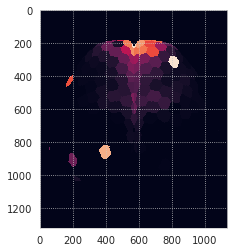

In [39]:
x = proj['parcel2d-top'][0].copy()
x[np.isnan(x)] = 0.0
plt.imshow(x)

[<matplotlib.lines.Line2D object at 0x7f44a0037940>]

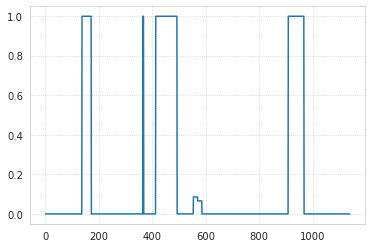

In [35]:
plt.plot(x[600])

In [43]:
y = mice.al.cortical_map(proj['parcel3d'][-1], 'top_view', np.nanmean)

In [44]:
y.shape

(1320, 1140)

<matplotlib.image.AxesImage object at 0x7f449f928640>

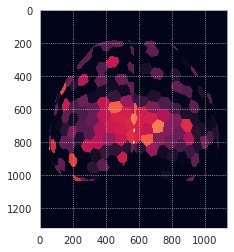

In [45]:
plt.imshow(y)

In [15]:
sv._create_save_dir()

'SVINET'

In [16]:
sv.path

'/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-192*4_bold-lite_rest_pearson_sub-SLC/real-k5-p40-sample-euclidean-linksampling-(2021_10_23)'

In [18]:
sv.path.replace(sv.perc, 'p88-binary')

'/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-192*4_bold-lite_rest_pearson_sub-SLC/real-k5-p88-binary-euclidean-linksampling-(2021_10_23)'

In [19]:
sv.path

'/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-192*4_bold-lite_rest_pearson_sub-SLC/real-k5-p40-sample-euclidean-linksampling-(2021_10_23)'

In [82]:
sv = SVINET(mice, 6, 'p40-sample', 'sub-SLC', 'bold', metric='spearman')

current expt: 'p40-sample'

In [83]:
_ = sv.load_runs()

[PROGRESS] experiment loaded: 'k = 6, p40-sample',  total # runs:  500

In [52]:
%%time

_ = sv.fit_svinet(save_plots=False)

[PROGRESS] fit: initiated

Intel(R) oneAPI Data Analytics Library solvers for sklearn enabled: https://intelpython.github.io/daal4py/sklearn.html


[PROGRESS] kmeans fit: done

[PROGRESS] find best mappings: done

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

warning type 1

[PROGRESS] results aligned: done

creating pi df, run: n1598-k6-mmsb-seed500-linksampling-p40-sample: 100%|██████████| 500/500 [00:06<00:00, 80.42it/s]


[PROGRESS] membership df: done

[PROGRESS] 'result.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'perf.df' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'pi_cut.df' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'gam_all.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'lam_all.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'pi_all.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'gam.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'lam.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] 'pi.npy' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-192*4/results/SVINET/n-1
92*4_bold_rest_spearman_sub-SLC/real-k6-p40-sample-euclidean-linksampling-(2021_10_22)

[PROGRESS] process results: done

[PROGRESS] fit: done!

CPU times: user 4min 53s, sys: 5.95 s, total: 4min 59s
Wall time: 4min 31s


In [53]:
sv.pi.shape

(6, 1742)

[
    <matplotlib.lines.Line2D object at 0x7f44a060ffa0>,
    <matplotlib.lines.Line2D object at 0x7f44a060f9d0>,
    <matplotlib.lines.Line2D object at 0x7f44a060ff40>,
    <matplotlib.lines.Line2D object at 0x7f44a0643640>,
    <matplotlib.lines.Line2D object at 0x7f44a0643e20>,
    <matplotlib.lines.Line2D object at 0x7f44a01122b0>
]

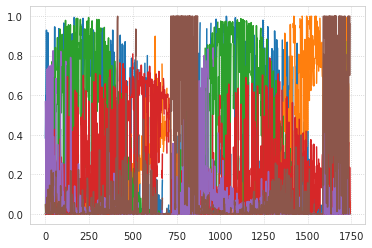

In [54]:
plt.plot(sv.pi.T)

In [55]:
proj = sv.project_vec()

In [56]:
list(proj)

['parcel2d-top', 'parcel2d-flat', 'parcel3d']

<AxesSubplot:ylabel='Count'>

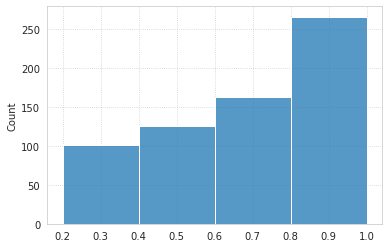

In [69]:
sns.histplot(np.round(sv.pi[2], 2), bins=np.linspace(0.2, 1.0, 5))

<matplotlib.colorbar.Colorbar object at 0x7f4328c21760>

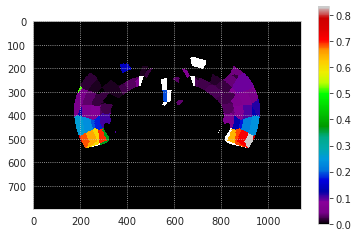

In [76]:
plt.imshow(proj['parcel3d'][4][400], cmap='nipy_spectral')
plt.colorbar()

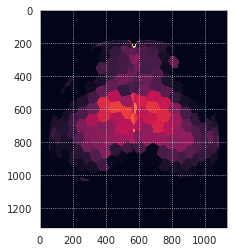

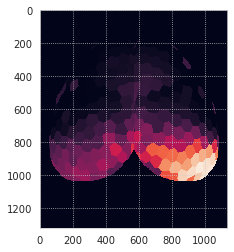

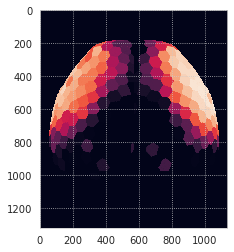

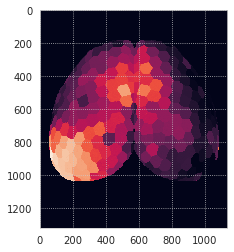

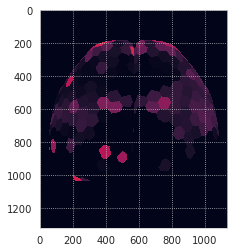

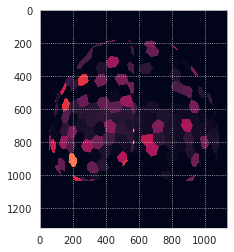

In [79]:
for i in range(sv.num_k):
    y = mice.al.cortical_map(proj['parcel3d'][i], 'top_view', np.nanmean)
    plt.imshow(y)
    plt.show()

In [122]:
key = 'sub-SLC10_ses-2_run-3'
net = Network(mice, key, 'bold-lite', metric='spearman')

In [87]:
net.fit_network()

[PROGRESS] fit: initiated

TypeError: 'float' object does not support item assignment

In [90]:
net.data.shape

(302, 550)

<matplotlib.image.AxesImage object at 0x7f4486ff1fa0>

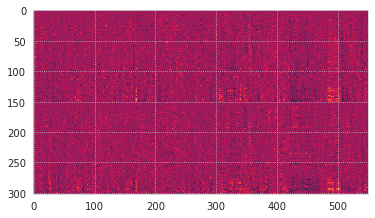

In [91]:
plt.imshow(net.data)

In [101]:
a, p = sp_stats.spearmanr(net.data, axis=1)
a, p 

(nan, nan)

In [100]:
a.shape

(550, 550)

[<matplotlib.lines.Line2D object at 0x7f448657b3a0>]

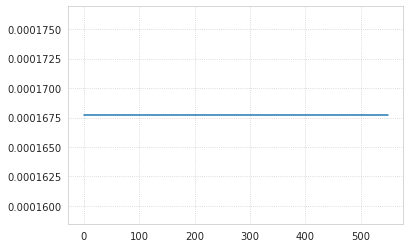

In [109]:
plt.plot(net.data[2])

<matplotlib.lines.Line2D object at 0x7f4483d1a2e0>

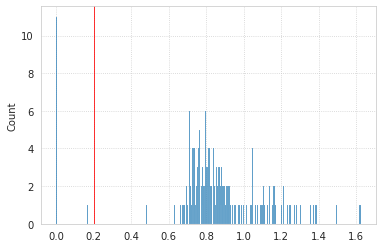

In [132]:
sns.histplot(np.std(net.data, axis=1), bins=500)
plt.axvline(0.2, lw=0.8, color='r')

<matplotlib.lines.Line2D object at 0x7f4484c43c40>

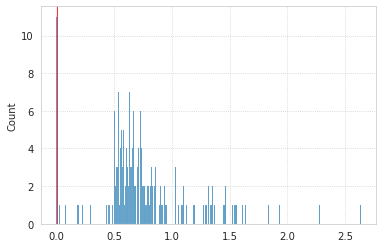

In [131]:
sns.histplot(np.var(net.data, axis=1), bins=500)
plt.axvline(0.01, lw=0.8, color='r')

(0.0, 0.1)

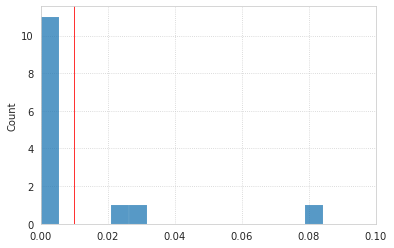

In [133]:
sns.histplot(np.var(net.data, axis=1), bins=500)
plt.axvline(0.01, lw=0.8, color='r')
plt.xlim(0., .1)

In [114]:
net.data[np.std(net.data, axis=1) < 1e-5] = np.nan

In [117]:
a, p = sp_stats.spearmanr(net.data, axis=1)

<matplotlib.image.AxesImage object at 0x7f4486555df0>

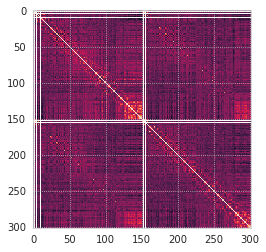

In [118]:
plt.imshow(a)

In [134]:
key = 'sub-SLC10_ses-2_run-3'
net = Network(mice, key, 'ca2', metric='spearman')

<matplotlib.lines.Line2D object at 0x7f44836dd1f0>

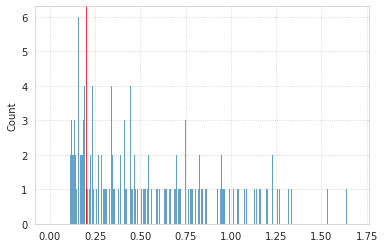

In [135]:
sns.histplot(np.std(net.data, axis=1), bins=500)
plt.axvline(0.2, lw=0.8, color='r')

<matplotlib.lines.Line2D object at 0x7f44835dbe80>

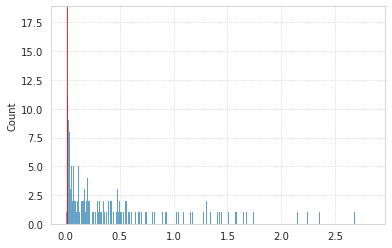

In [136]:
sns.histplot(np.var(net.data, axis=1), bins=500)
plt.axvline(0.01, lw=0.8, color='r')

(0.0, 0.1)

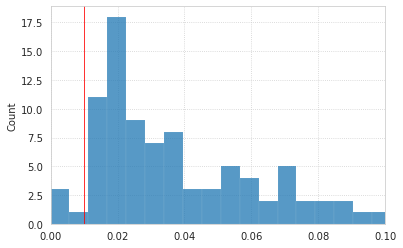

In [139]:
sns.histplot(np.var(net.data, axis=1), bins=500)
plt.axvline(0.01, lw=0.8, color='r')
plt.xlim(0., .1)

In [147]:
eps = 1e-3


3

In [151]:
for key in mice.ca:
    net = Network(mice, key, 'ca2', metric='spearman')
    print(key, (np.var(net.data, axis=1) < 1e-2).sum(), (np.var(net.data, axis=1) < 1e-3).sum(), (np.var(net.data, axis=1) < 1e-4).sum())

sub-SLC01_ses-1_run-1 0 0 0

sub-SLC01_ses-1_run-3 0 0 0

sub-SLC01_ses-1_run-5 0 0 0

sub-SLC01_ses-1_run-7 0 0 0

sub-SLC01_ses-2_run-1 3 2 2

sub-SLC01_ses-2_run-3 2 2 2

sub-SLC01_ses-2_run-5 2 2 2

sub-SLC01_ses-2_run-7 5 2 2

sub-SLC01_ses-3_run-1 5 2 2

sub-SLC01_ses-3_run-3 5 2 2

sub-SLC01_ses-3_run-5 2 2 2

sub-SLC01_ses-3_run-7 7 2 2

sub-SLC02_ses-1_run-1 1 0 0

sub-SLC02_ses-1_run-3 2 0 0

sub-SLC02_ses-1_run-5 25 0 0

sub-SLC02_ses-1_run-7 1 0 0

sub-SLC02_ses-2_run-1 1 1 1

sub-SLC02_ses-2_run-3 12 1 1

sub-SLC02_ses-2_run-5 4 1 1

sub-SLC02_ses-3_run-1 7 0 0

sub-SLC02_ses-3_run-3 0 0 0

sub-SLC02_ses-3_run-5 11 0 0

sub-SLC02_ses-3_run-7 0 0 0

sub-SLC03_ses-1_run-1 2 2 2

sub-SLC03_ses-1_run-2 14 2 2

sub-SLC03_ses-1_run-4 8 2 2

sub-SLC03_ses-1_run-6 7 2 2

sub-SLC03_ses-2_run-1 3 2 2

sub-SLC03_ses-2_run-3 6 2 2

sub-SLC03_ses-2_run-5 7 2 2

sub-SLC03_ses-2_run-7 9 2 2

sub-SLC03_ses-3_run-1 5 1 1

sub-SLC03_ses-3_run-3 12 2 2

sub-SLC03_ses-3_run-5 21 2 2

sub-SLC03_ses-3_run-7 3 2 2

sub-SLC04_ses-1_run-1 3 2 2

sub-SLC04_ses-1_run-3 13 2 2

sub-SLC04_ses-1_run-5 3 2 2

sub-SLC04_ses-1_run-7 31 2 2

sub-SLC04_ses-2_run-1 13 0 0

sub-SLC04_ses-2_run-3 25 0 0

sub-SLC04_ses-2_run-5 11 0 0

sub-SLC04_ses-2_run-7 19 0 0

sub-SLC04_ses-3_run-1 21 3 3

sub-SLC04_ses-3_run-3 4 3 3

sub-SLC04_ses-3_run-5 32 3 3

sub-SLC04_ses-3_run-7 5 3 3

sub-SLC05_ses-1_run-1 18 0 0

sub-SLC05_ses-1_run-3 31 0 0

sub-SLC05_ses-1_run-5 0 0 0

sub-SLC05_ses-1_run-7 3 0 0

sub-SLC05_ses-2_run-1 15 0 0

sub-SLC05_ses-2_run-3 1 0 0

sub-SLC05_ses-2_run-5 1 0 0

sub-SLC05_ses-2_run-7 14 0 0

sub-SLC05_ses-3_run-1 3 1 1

sub-SLC05_ses-3_run-3 14 1 1

sub-SLC05_ses-3_run-5 2 1 1

sub-SLC05_ses-3_run-7 15 1 1

sub-SLC06_ses-1_run-1 15 2 2

sub-SLC06_ses-1_run-3 17 2 2

sub-SLC06_ses-1_run-5 4 2 2

sub-SLC06_ses-1_run-7 3 2 2

sub-SLC06_ses-2_run-1 9 1 1

sub-SLC06_ses-2_run-3 12 1 1

sub-SLC06_ses-2_run-5 11 1 1

sub-SLC06_ses-2_run-7 3 1 1

sub-SLC06_ses-3_run-1 17 0 0

sub-SLC06_ses-3_run-3 21 0 0

sub-SLC06_ses-3_run-5 0 0 0

sub-SLC06_ses-3_run-7 0 0 0

sub-SLC07_ses-1_run-1 37 2 2

sub-SLC07_ses-1_run-3 43 2 2

sub-SLC07_ses-1_run-5 52 3 3

sub-SLC07_ses-1_run-7 50 2 2

sub-SLC07_ses-2_run-1 3 0 0

sub-SLC07_ses-2_run-3 3 0 0

sub-SLC07_ses-2_run-5 6 0 0

sub-SLC07_ses-2_run-7 4 0 0

sub-SLC07_ses-3_run-1 14 1 1

sub-SLC07_ses-3_run-3 2 1 1

sub-SLC07_ses-3_run-5 3 2 2

sub-SLC07_ses-3_run-7 4 1 1

sub-SLC08_ses-1_run-1 5 1 1

sub-SLC08_ses-1_run-3 3 1 1

sub-SLC08_ses-1_run-5 3 1 1

sub-SLC08_ses-2_run-1 6 0 0

sub-SLC08_ses-2_run-3 3 1 1

sub-SLC08_ses-2_run-5 9 1 1

sub-SLC08_ses-2_run-7 1 1 1

sub-SLC08_ses-3_run-1 18 4 4

sub-SLC08_ses-3_run-3 17 4 4

sub-SLC08_ses-3_run-5 7 4 4

sub-SLC08_ses-3_run-7 4 4 4

sub-SLC09_ses-1_run-1 25 2 1

sub-SLC09_ses-1_run-3 2 1 1

sub-SLC09_ses-1_run-5 26 2 1

sub-SLC09_ses-1_run-7 23 1 1

sub-SLC09_ses-2_run-1 1 0 0

sub-SLC09_ses-2_run-3 1 0 0

sub-SLC09_ses-2_run-5 5 0 0

sub-SLC09_ses-2_run-7 2 0 0

sub-SLC09_ses-3_run-1 2 1 1

sub-SLC09_ses-3_run-3 16 1 1

sub-SLC09_ses-3_run-5 1 1 1

sub-SLC09_ses-3_run-7 20 1 1

sub-SLC10_ses-1_run-1 1 0 0

sub-SLC10_ses-1_run-3 0 0 0

sub-SLC10_ses-1_run-5 3 0 0

sub-SLC10_ses-1_run-7 1 0 0

sub-SLC10_ses-2_run-1 29 3 3

sub-SLC10_ses-2_run-3 3 3 3

sub-SLC10_ses-2_run-5 43 3 3

sub-SLC10_ses-2_run-7 3 3 3

sub-SLC10_ses-3_run-1 28 0 0

sub-SLC10_ses-3_run-3 0 0 0

sub-SLC10_ses-3_run-5 19 0 0

sub-SLC10_ses-3_run-7 18 0 0

sub-SLC01_ses-1 0 0 0

sub-SLC01_ses-2 0 0 0

sub-SLC01_ses-3 0 0 0

sub-SLC02_ses-1 0 0 0

sub-SLC02_ses-2 0 0 0

sub-SLC02_ses-3 0 0 0

sub-SLC03_ses-1 2 0 0

sub-SLC03_ses-2 0 0 0

sub-SLC03_ses-3 0 0 0

sub-SLC04_ses-1 2 0 0

sub-SLC04_ses-2 0 0 0

sub-SLC04_ses-3 0 0 0

sub-SLC05_ses-1 0 0 0

sub-SLC05_ses-2 0 0 0

sub-SLC05_ses-3 0 0 0

sub-SLC06_ses-1 3 0 0

sub-SLC06_ses-2 0 0 0

sub-SLC06_ses-3 0 0 0

sub-SLC07_ses-1 36 0 0

sub-SLC07_ses-2 0 0 0

sub-SLC07_ses-3 0 0 0

sub-SLC08_ses-1 0 0 0

sub-SLC08_ses-2 0 0 0

sub-SLC08_ses-3 0 0 0

sub-SLC09_ses-1 0 0 0

sub-SLC09_ses-2 1 0 0

sub-SLC09_ses-3 0 0 0

sub-SLC10_ses-1 0 0 0

sub-SLC10_ses-2 3 0 0

sub-SLC10_ses-3 0 0 0

sub-SLC01 0 0 0

sub-SLC02 0 0 0

sub-SLC03 0 0 0

sub-SLC04 0 0 0

sub-SLC05 0 0 0

sub-SLC06 0 0 0

sub-SLC07 0 0 0

sub-SLC08 0 0 0

sub-SLC09 0 0 0

sub-SLC10 0 0 0

sub-SLC 0 0 0

sub-SLC_ses-1 0 0 0

sub-SLC_ses-2 0 0 0

sub-SLC_ses-3 0 0 0

In [153]:
for key in mice.bold:
    net = Network(mice, key, 'bold', metric='spearman')
    print(key, (np.var(net.data, axis=1) < 1e-2).sum(), (np.var(net.data, axis=1) < 1e-3).sum(), (np.var(net.data, axis=1) < 1e-4).sum())

sub-SLC01_ses-1_run-1 2 1 1

sub-SLC01_ses-1_run-3 4 2 1

sub-SLC01_ses-1_run-5 4 1 1

sub-SLC01_ses-1_run-7 4 1 1

sub-SLC01_ses-2_run-1 0 0 0

sub-SLC01_ses-2_run-3 0 0 0

sub-SLC01_ses-2_run-5 0 0 0

sub-SLC01_ses-2_run-7 0 0 0

sub-SLC01_ses-3_run-1 0 0 0

sub-SLC01_ses-3_run-3 0 0 0

sub-SLC01_ses-3_run-5 0 0 0

sub-SLC01_ses-3_run-7 0 0 0

sub-SLC02_ses-1_run-1 2 0 0

sub-SLC02_ses-1_run-3 2 0 0

sub-SLC02_ses-1_run-5 2 0 0

sub-SLC02_ses-1_run-7 2 0 0

sub-SLC02_ses-2_run-1 0 0 0

sub-SLC02_ses-2_run-3 0 0 0

sub-SLC02_ses-2_run-5 0 0 0

sub-SLC02_ses-3_run-1 0 0 0

sub-SLC02_ses-3_run-3 1 0 0

sub-SLC02_ses-3_run-5 0 0 0

sub-SLC02_ses-3_run-7 0 0 0

sub-SLC03_ses-1_run-2 1 0 0

sub-SLC03_ses-1_run-4 0 0 0

sub-SLC03_ses-1_run-6 0 0 0

sub-SLC03_ses-2_run-1 1 0 0

sub-SLC03_ses-2_run-3 1 0 0

sub-SLC03_ses-2_run-5 0 0 0

sub-SLC03_ses-2_run-7 0 0 0

sub-SLC03_ses-3_run-1 0 0 0

sub-SLC03_ses-3_run-3 0 0 0

sub-SLC03_ses-3_run-5 0 0 0

sub-SLC03_ses-3_run-7 0 0 0

sub-SLC04_ses-1_run-1 0 0 0

sub-SLC04_ses-1_run-3 0 0 0

sub-SLC04_ses-1_run-5 0 0 0

sub-SLC04_ses-1_run-7 0 0 0

sub-SLC04_ses-2_run-1 0 0 0

sub-SLC04_ses-2_run-3 0 0 0

sub-SLC04_ses-2_run-5 0 0 0

sub-SLC04_ses-2_run-7 0 0 0

sub-SLC04_ses-3_run-1 0 0 0

sub-SLC04_ses-3_run-3 0 0 0

sub-SLC04_ses-3_run-5 0 0 0

sub-SLC04_ses-3_run-7 0 0 0

sub-SLC05_ses-1_run-1 6 4 2

sub-SLC05_ses-1_run-3 6 3 2

sub-SLC05_ses-1_run-7 6 4 2

sub-SLC05_ses-2_run-1 0 0 0

sub-SLC05_ses-2_run-3 0 0 0

sub-SLC05_ses-2_run-5 0 0 0

sub-SLC05_ses-2_run-7 0 0 0

sub-SLC05_ses-3_run-1 0 0 0

sub-SLC05_ses-3_run-3 0 0 0

sub-SLC05_ses-3_run-5 0 0 0

sub-SLC05_ses-3_run-7 0 0 0

sub-SLC06_ses-1_run-1 0 0 0

sub-SLC06_ses-1_run-3 2 0 0

sub-SLC06_ses-1_run-5 0 0 0

sub-SLC06_ses-1_run-7 0 0 0

sub-SLC06_ses-2_run-1 0 0 0

sub-SLC06_ses-2_run-3 0 0 0

sub-SLC06_ses-2_run-5 0 0 0

sub-SLC06_ses-2_run-7 0 0 0

sub-SLC06_ses-3_run-1 0 0 0

sub-SLC06_ses-3_run-3 0 0 0

sub-SLC06_ses-3_run-5 0 0 0

sub-SLC06_ses-3_run-7 0 0 0

sub-SLC07_ses-1_run-1 0 0 0

sub-SLC07_ses-1_run-3 0 0 0

sub-SLC07_ses-1_run-5 0 0 0

sub-SLC07_ses-1_run-7 0 0 0

sub-SLC07_ses-2_run-1 0 0 0

sub-SLC07_ses-2_run-3 0 0 0

sub-SLC07_ses-2_run-5 0 0 0

sub-SLC07_ses-2_run-7 0 0 0

sub-SLC07_ses-3_run-1 0 0 0

sub-SLC07_ses-3_run-3 0 0 0

sub-SLC07_ses-3_run-5 0 0 0

sub-SLC07_ses-3_run-7 0 0 0

sub-SLC08_ses-1_run-1 0 0 0

sub-SLC08_ses-1_run-3 2 2 1

sub-SLC08_ses-1_run-5 3 2 1

sub-SLC08_ses-2_run-1 2 2 2

sub-SLC08_ses-2_run-3 2 2 2

sub-SLC08_ses-2_run-5 3 2 2

sub-SLC08_ses-2_run-7 2 2 2

sub-SLC08_ses-3_run-1 5 2 2

sub-SLC08_ses-3_run-3 9 2 2

sub-SLC08_ses-3_run-5 9 2 2

sub-SLC08_ses-3_run-7 7 2 2

sub-SLC09_ses-1_run-1 0 0 0

sub-SLC09_ses-1_run-3 0 0 0

sub-SLC09_ses-1_run-5 0 0 0

sub-SLC09_ses-1_run-7 0 0 0

sub-SLC09_ses-2_run-1 2 0 0

sub-SLC09_ses-2_run-3 2 0 0

sub-SLC09_ses-2_run-5 2 0 0

sub-SLC09_ses-2_run-7 2 0 0

sub-SLC09_ses-3_run-1 4 2 2

sub-SLC09_ses-3_run-3 4 2 2

sub-SLC09_ses-3_run-5 4 2 2

sub-SLC09_ses-3_run-7 4 2 2

sub-SLC10_ses-1_run-1 4 2 2

sub-SLC10_ses-1_run-3 4 2 2

sub-SLC10_ses-1_run-5 4 2 2

sub-SLC10_ses-1_run-7 4 2 2

sub-SLC10_ses-2_run-1 0 0 0

sub-SLC10_ses-2_run-3 23 23 23

sub-SLC10_ses-2_run-5 23 23 23

sub-SLC10_ses-2_run-7 23 23 23

sub-SLC10_ses-3_run-1 0 0 0

sub-SLC10_ses-3_run-3 0 0 0

sub-SLC10_ses-3_run-5 0 0 0

sub-SLC10_ses-3_run-7 0 0 0

sub-SLC01_ses-1 4 1 1

sub-SLC01_ses-2 0 0 0

sub-SLC01_ses-3 0 0 0

sub-SLC02_ses-1 2 0 0

sub-SLC02_ses-2 0 0 0

sub-SLC02_ses-3 0 0 0

sub-SLC03_ses-1 0 0 0

sub-SLC03_ses-2 1 0 0

sub-SLC03_ses-3 0 0 0

sub-SLC04_ses-1 0 0 0

sub-SLC04_ses-2 0 0 0

sub-SLC04_ses-3 0 0 0

sub-SLC05_ses-1 6 4 2

sub-SLC05_ses-2 0 0 0

sub-SLC05_ses-3 0 0 0

sub-SLC06_ses-1 0 0 0

sub-SLC06_ses-2 0 0 0

sub-SLC06_ses-3 0 0 0

sub-SLC07_ses-1 0 0 0

sub-SLC07_ses-2 0 0 0

sub-SLC07_ses-3 0 0 0

sub-SLC08_ses-1 2 2 1

sub-SLC08_ses-2 2 2 2

sub-SLC08_ses-3 7 2 2

sub-SLC09_ses-1 0 0 0

sub-SLC09_ses-2 2 0 0

sub-SLC09_ses-3 4 2 2

sub-SLC10_ses-1 4 2 2

sub-SLC10_ses-2 23 23 23

sub-SLC10_ses-3 0 0 0

sub-SLC01 0 0 0

sub-SLC02 0 0 0

sub-SLC03 0 0 0

sub-SLC04 0 0 0

sub-SLC05 0 0 0

sub-SLC06 0 0 0

sub-SLC07 0 0 0

sub-SLC08 3 2 2

sub-SLC09 0 0 0

sub-SLC10 0 0 0

sub-SLC 0 0 0

sub-SLC_ses-1 0 0 0

sub-SLC_ses-2 0 0 0

sub-SLC_ses-3 0 0 0

In [167]:
key = 'sub-SLC01_ses-1_run-3'
net = Network(mice, key, 'bold-lite', metric='spearman')
_ = net.load_network()

In [170]:
net.data.shape

(302, 550)

<matplotlib.colorbar.Colorbar object at 0x7f445a3d7f70>

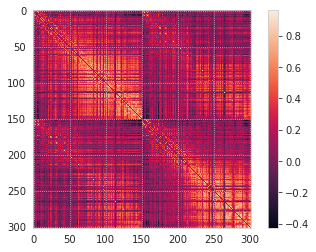

In [171]:
plt.imshow(net.adj)
plt.colorbar()

In [172]:
key = 'sub-SLC01_ses-1_run-3'
net = Network(mice, key, 'ca2', metric='spearman')
_ = net.load_network()

In [173]:
net.data.shape

(302, 5500)

<matplotlib.colorbar.Colorbar object at 0x7f445a3d7940>

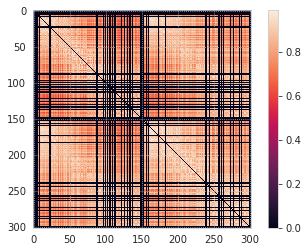

In [174]:
plt.imshow(net.adj)
plt.colorbar()

In [5]:
%timeit sv.load_network()

2.78 s ± 196 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [6]:
len(sv.adj), len(sv.n2l)

(1742, 1742)

In [4]:
%%time

sv = SVINET(mice, 5, 'p30-sample', 'sub-SLC04_ses-3')

current expt: 'p30-sample'

CPU times: user 1.67 s, sys: 645 ms, total: 2.32 s
Wall time: 2.31 s


In [5]:
sv.percentiles

[40, 30, 20, 15, 10, 5]

In [6]:
list(sv.thresholds)

[40, 30, 20, 15, 10, 5]

<matplotlib.colorbar.Colorbar object at 0x7ff5437c1130>

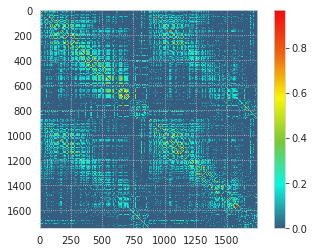

In [12]:
plt.imshow(sv.adjacencies[40], cmap=sv.style['cmap'])
plt.colorbar()

In [13]:
sv.thresholds

{
    40: 0.0,
    30: 0.04223917557809394,
    20: 0.07071104943410576,
    15: 0.0911330144107286,
    10: 0.12157440629050609,
    5: 0.18066209268201297
}

In [14]:
for key in mice.bold:
    sv = SVINET(mice, 5, 'p30-sample', key)
    print(key, sv.thresholds)

current expt: 'p30-sample'

sub-SLC01_ses-1_run-1
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.09016127946723317, 5: 0.12099397979192154}

current expt: 'p30-sample'

sub-SLC01_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.13185975145407794,
    15: 0.16803934276172153,
    10: 0.21974244868423298,
    5: 0.3105517042757758
}

current expt: 'p30-sample'

sub-SLC01_ses-1_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.09654222309049243,
    15: 0.12345781925756293,
    10: 0.16277207074819997,
    5: 0.23962779926175798
}

current expt: 'p30-sample'

sub-SLC01_ses-1_run-7
{
    40: 0.0,
    30: 0.10030740540544242,
    20: 0.14889563324694105,
    15: 0.17990437199792847,
    10: 0.22125369697704214,
    5: 0.29098244068800067
}

current expt: 'p30-sample'

sub-SLC01_ses-2_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.1193916455053045,
    15: 0.1506945756227815,
    10: 0.1937567831985091,
    5: 0.2692389838042244
}

current expt: 'p30-sample'

sub-SLC01_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.08420776598779202,
    15: 0.10710052936858125,
    10: 0.14037928314171408,
    5: 0.20635175125956914
}

current expt: 'p30-sample'

sub-SLC01_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.08525746717286248,
    15: 0.11011717059375045,
    10: 0.1472181020921447,
    5: 0.2214190054032601
}

current expt: 'p30-sample'

sub-SLC01_ses-2_run-7
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.10387889856148377, 5: 0.1416265412665592}

current expt: 'p30-sample'

sub-SLC01_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.0975131678627127,
    10: 0.1260351321052991,
    5: 0.17807616698829143
}

current expt: 'p30-sample'

sub-SLC01_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.10972679258786092,
    15: 0.1377839879174986,
    10: 0.1770105319339102,
    5: 0.24608619992312827
}

current expt: 'p30-sample'

sub-SLC01_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.10275076809294506,
    10: 0.1334426677333474,
    5: 0.1890524244097661
}

current expt: 'p30-sample'

sub-SLC01_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.0999572870868114,
    10: 0.13032373038233938,
    5: 0.1871738066005991
}

current expt: 'p30-sample'

sub-SLC02_ses-1_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.10593946566910108,
    15: 0.13179360679722446,
    10: 0.1682302445824275,
    5: 0.23223977787663982
}

current expt: 'p30-sample'

sub-SLC02_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.09311060238226752,
    15: 0.11704119544062008,
    10: 0.1507746826723291,
    5: 0.21151901235624437
}

current expt: 'p30-sample'

sub-SLC02_ses-1_run-5
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.09284022033946626, 5: 0.12369746518264059}

current expt: 'p30-sample'

sub-SLC02_ses-1_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09613695803652411,
    10: 0.1220094250899584,
    5: 0.16764749601192244
}

current expt: 'p30-sample'

sub-SLC02_ses-2_run-1
{
    40: 0.0,
    30: 0.10367806618433328,
    20: 0.15013913183118613,
    15: 0.18080812394931267,
    10: 0.22176441418026233,
    5: 0.28900005460600303
}

current expt: 'p30-sample'

sub-SLC02_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.10346279139733221,
    10: 0.13153553882520996,
    5: 0.18242872283209147
}

current expt: 'p30-sample'

sub-SLC02_ses-2_run-5
{
    40: 0.0,
    30: 0.0863876769623505,
    20: 0.13599487873546395,
    15: 0.1713820474109847,
    10: 0.22264070524432827,
    5: 0.31539954767457784
}

current expt: 'p30-sample'

sub-SLC02_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.08382319264197269,
    15: 0.10491333340527034,
    10: 0.1344937662052534,
    5: 0.18895688995541596
}

current expt: 'p30-sample'

sub-SLC02_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.11717184527091522,
    15: 0.1414875283740616,
    10: 0.1744905031757223,
    5: 0.2301578272363613
}

current expt: 'p30-sample'

sub-SLC02_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.11010052493276834,
    15: 0.13792559671771948,
    10: 0.17803194782942808,
    5: 0.25822921869885324
}

current expt: 'p30-sample'

sub-SLC02_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09155419286911344,
    10: 0.11515398355420864,
    5: 0.15743572933807531
}

current expt: 'p30-sample'

sub-SLC03_ses-1_run-2
{
    40: 0.0,
    30: 0.0,
    20: 0.11621542371744288,
    15: 0.14436040007681764,
    10: 0.18229027524278651,
    5: 0.2472793300623774
}

current expt: 'p30-sample'

sub-SLC03_ses-1_run-4
{
    40: 0.0,
    30: 0.0,
    20: 0.11620033738408198,
    15: 0.14581758930664912,
    10: 0.1868569313117682,
    5: 0.2608322843227865
}

current expt: 'p30-sample'

sub-SLC03_ses-1_run-6
{
    40: 0.0,
    30: 0.09554713631052411,
    20: 0.14661418069233864,
    15: 0.18002754954244796,
    10: 0.22561888994286022,
    5: 0.30333606720439077
}

current expt: 'p30-sample'

sub-SLC03_ses-2_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.10164876480404933,
    15: 0.12488394110771948,
    10: 0.15758407979929046,
    5: 0.21562390370649495
}

current expt: 'p30-sample'

sub-SLC03_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.11910642927033073,
    15: 0.1439730758249863,
    10: 0.1767678354086247,
    5: 0.2310359873410285
}

current expt: 'p30-sample'

sub-SLC03_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.10884662682041192,
    15: 0.13859496052387804,
    10: 0.18079510945048846,
    5: 0.2577862898078656
}

current expt: 'p30-sample'

sub-SLC03_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.08919645873507133,
    15: 0.1128123699080865,
    10: 0.14644320237751066,
    5: 0.21153218127661524
}

current expt: 'p30-sample'

sub-SLC03_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.10616620242336784,
    15: 0.13690355877446822,
    10: 0.18076699610050626,
    5: 0.25551966408156734
}

current expt: 'p30-sample'

sub-SLC03_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.10735303362639088,
    15: 0.13747368269987792,
    10: 0.18244201500438567,
    5: 0.2743026117770095
}

current expt: 'p30-sample'

sub-SLC03_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.1247780933132311,
    15: 0.15822285039603884,
    10: 0.20767563124388982,
    5: 0.30398706914653484
}

current expt: 'p30-sample'

sub-SLC03_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.12197455979832532,
    15: 0.15701332954348515,
    10: 0.20852245636034203,
    5: 0.309012433429198
}

current expt: 'p30-sample'

sub-SLC04_ses-1_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.11741159568616309,
    15: 0.14823383212019794,
    10: 0.19304517843246483,
    5: 0.2730001662129934
}

current expt: 'p30-sample'

sub-SLC04_ses-1_run-3
{
    40: 0.0,
    30: 0.08364557446999167,
    20: 0.13500003816617442,
    15: 0.16982486244190254,
    10: 0.2178553691010084,
    5: 0.29989728581060904
}

current expt: 'p30-sample'

sub-SLC04_ses-1_run-5
{
    40: 0.0,
    30: 0.08940578755409562,
    20: 0.14402258979268837,
    15: 0.17989060339679633,
    10: 0.22876820735364,
    5: 0.31184562833792745
}

current expt: 'p30-sample'

sub-SLC04_ses-1_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.08397798152252438,
    10: 0.10937273446675032,
    5: 0.15738533476436936
}

current expt: 'p30-sample'

sub-SLC04_ses-2_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.09762123056317953,
    15: 0.12301579439187878,
    10: 0.15912965734230167,
    5: 0.2259162074976858
}

current expt: 'p30-sample'

sub-SLC04_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0920085348386373,
    15: 0.1158492895942804,
    10: 0.14991210648185369,
    5: 0.21301651836253882
}

current expt: 'p30-sample'

sub-SLC04_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.11851135055118729,
    15: 0.14851480546986007,
    10: 0.19133016944857392,
    5: 0.2711247310736989
}

current expt: 'p30-sample'

sub-SLC04_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0842504541932697,
    15: 0.10635739831373889,
    10: 0.13848029842210322,
    5: 0.20105518744661002
}

current expt: 'p30-sample'

sub-SLC04_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.09767759194595695,
    15: 0.12364987367311886,
    10: 0.16107613248553213,
    5: 0.230264779420771
}

current expt: 'p30-sample'

sub-SLC04_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.09077540751188119,
    15: 0.11433893022886851,
    10: 0.1472090457427852,
    5: 0.20587173141056894
}

current expt: 'p30-sample'

sub-SLC04_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.09071167803005023,
    15: 0.11316976070335706,
    10: 0.14410934357898525,
    5: 0.19904009203563633
}

current expt: 'p30-sample'

sub-SLC04_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.10933013517504257,
    15: 0.1358610512926695,
    10: 0.17213429130091015,
    5: 0.2349341223012702
}

current expt: 'p30-sample'

sub-SLC05_ses-1_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.08883970323790435,
    15: 0.1128675943442105,
    10: 0.146263531096807,
    5: 0.20957961645500747
}

current expt: 'p30-sample'

sub-SLC05_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.08416105877861378,
    15: 0.10438169741600155,
    10: 0.1318714550920977,
    5: 0.1806419184332057
}

current expt: 'p30-sample'

sub-SLC05_ses-1_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.10068748467125618,
    15: 0.1293155547761142,
    10: 0.17143897132697916,
    5: 0.2511895042871702
}

current expt: 'p30-sample'

sub-SLC05_ses-2_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.10086818743071482,
    15: 0.12786057857606561,
    10: 0.16608198195689888,
    5: 0.23473903341155605
}

current expt: 'p30-sample'

sub-SLC05_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.10667334363661346,
    15: 0.13520592119831767,
    10: 0.17631646851528754,
    5: 0.25281738064407283
}

current expt: 'p30-sample'

sub-SLC05_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.09937705222151322,
    15: 0.12495390987213163,
    10: 0.16132353484725825,
    5: 0.2255852641101215
}

current expt: 'p30-sample'

sub-SLC05_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.08564380363191626,
    15: 0.10601541840049701,
    10: 0.13364694272993896,
    5: 0.18127951325654337
}

current expt: 'p30-sample'

sub-SLC05_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.09510472143901905,
    15: 0.11890973664210312,
    10: 0.151669980340658,
    5: 0.2101697637693128
}

current expt: 'p30-sample'

sub-SLC05_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.11729508600865445,
    15: 0.14556783338532606,
    10: 0.18392130341684731,
    5: 0.24818119468479555
}

current expt: 'p30-sample'

sub-SLC05_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.09789415407636157,
    15: 0.12090710020548255,
    10: 0.15294975156484897,
    5: 0.2125172729324671
}

current expt: 'p30-sample'

sub-SLC05_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.11954541162530805,
    15: 0.1456069123618344,
    10: 0.1807344536484554,
    5: 0.2395591142939802
}

current expt: 'p30-sample'

sub-SLC06_ses-1_run-1
{
    40: 0.0,
    30: 0.1102542632126645,
    20: 0.17385209688603384,
    15: 0.21549838799789378,
    10: 0.2730582130268262,
    5: 0.36658183978715897
}

current expt: 'p30-sample'

sub-SLC06_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.08669637887917261,
    15: 0.10886610563349498,
    10: 0.14082301047664303,
    5: 0.20207289868916542
}

current expt: 'p30-sample'

sub-SLC06_ses-1_run-5
{
    40: 0.0,
    30: 0.12123803145857792,
    20: 0.1765969707241072,
    15: 0.21286603228763934,
    10: 0.2627842777631245,
    5: 0.3461068366986402
}

current expt: 'p30-sample'

sub-SLC06_ses-1_run-7
{
    40: 0.0,
    30: 0.10875346621319357,
    20: 0.16306015341781777,
    15: 0.19747558383254707,
    10: 0.24354804350853915,
    5: 0.31907887216500685
}

current expt: 'p30-sample'

sub-SLC06_ses-2_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.12731976774412085,
    15: 0.15951765326412592,
    10: 0.20573739288834728,
    5: 0.29235672801570006
}

current expt: 'p30-sample'

sub-SLC06_ses-2_run-3
{
    40: 0.0,
    30: 0.10968521185177413,
    20: 0.17117195420058498,
    15: 0.2114910274932697,
    10: 0.2664582837562471,
    5: 0.3604847462599491
}

current expt: 'p30-sample'

sub-SLC06_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.12269761934212361,
    15: 0.15699275831948026,
    10: 0.2061285461065141,
    5: 0.2925063382424282
}

current expt: 'p30-sample'

sub-SLC06_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.08577611639285469,
    15: 0.1079464702834147,
    10: 0.13845267074051182,
    5: 0.19200430699476884
}

current expt: 'p30-sample'

sub-SLC06_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.09993701199884499,
    15: 0.12480425138081934,
    10: 0.160044372634362,
    5: 0.2252172013942788
}

current expt: 'p30-sample'

sub-SLC06_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09359708757614822,
    10: 0.12070319100253689,
    5: 0.17039897728741005
}

current expt: 'p30-sample'

sub-SLC06_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09698594726251582,
    10: 0.12352705195006738,
    5: 0.17112977199915644
}

current expt: 'p30-sample'

sub-SLC06_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.1265439694819042,
    15: 0.16161673048669317,
    10: 0.21267052988806467,
    5: 0.2985667717457386
}

current expt: 'p30-sample'

sub-SLC07_ses-1_run-1
{
    40: 0.0,
    30: 0.10818788884926209,
    20: 0.15862567707878925,
    15: 0.19180571544592695,
    10: 0.23676163739104947,
    5: 0.3138681526109103
}

current expt: 'p30-sample'

sub-SLC07_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.1017936285027176,
    15: 0.13221839715101447,
    10: 0.17702818282611227,
    5: 0.25936881271944934
}

current expt: 'p30-sample'

sub-SLC07_ses-1_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.11449173248319443,
    15: 0.1476699068985657,
    10: 0.19524106808802144,
    5: 0.27891836082099536
}

current expt: 'p30-sample'

sub-SLC07_ses-1_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.09934591595147248,
    15: 0.12487720575334454,
    10: 0.1614832886000872,
    5: 0.2283769203546709
}

current expt: 'p30-sample'

sub-SLC07_ses-2_run-1
{
    40: 0.0,
    30: 0.1214442652389737,
    20: 0.18078798599761428,
    15: 0.2210951975354057,
    10: 0.2759513187478934,
    5: 0.3659065918571525
}

current expt: 'p30-sample'

sub-SLC07_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.08976826875826144,
    15: 0.11596659647050422,
    10: 0.15539977955490178,
    5: 0.23443335763947534
}

current expt: 'p30-sample'

sub-SLC07_ses-2_run-5
{
    40: 0.0,
    30: 0.09119487731749315,
    20: 0.14408031579112118,
    15: 0.17909545943226346,
    10: 0.22715480226092447,
    5: 0.3076770130705298
}

current expt: 'p30-sample'

sub-SLC07_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09279167679476619,
    10: 0.11773437653847957,
    5: 0.16309143420799146
}

current expt: 'p30-sample'

sub-SLC07_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.08416538600319977,
    15: 0.10653029170839158,
    10: 0.1382427243374042,
    5: 0.19500810921660805
}

current expt: 'p30-sample'

sub-SLC07_ses-3_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.08835068051944901,
    15: 0.11200168983799202,
    10: 0.14554818522050283,
    5: 0.207616093194762
}

current expt: 'p30-sample'

sub-SLC07_ses-3_run-5
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.10246709060916953, 5: 0.13863580738873904}

current expt: 'p30-sample'

sub-SLC07_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.09140539598254688,
    15: 0.11497301561298626,
    10: 0.14775638017429452,
    5: 0.20790315140168134
}

current expt: 'p30-sample'

sub-SLC08_ses-1_run-1
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.0, 5: 0.0}

current expt: 'p30-sample'

sub-SLC08_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0931148912308593,
    15: 0.11885249892565411,
    10: 0.15577952825694727,
    5: 0.2210653748560001
}

current expt: 'p30-sample'

sub-SLC08_ses-1_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.11731555018384122,
    15: 0.15239828059677368,
    10: 0.2034490904473289,
    5: 0.2904805733962589
}

current expt: 'p30-sample'

sub-SLC08_ses-2_run-1
{
    40: 0.0,
    30: 0.10985127299792363,
    20: 0.16967835306785597,
    15: 0.20994071958143415,
    10: 0.2633400462492272,
    5: 0.34701564724141976
}

current expt: 'p30-sample'

sub-SLC08_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.10815317073666487,
    15: 0.14324462363906215,
    10: 0.19682552033008582,
    5: 0.29343967057760273
}

current expt: 'p30-sample'

sub-SLC08_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.12109683375144034,
    15: 0.15073355768586416,
    10: 0.1929955622368725,
    5: 0.26661963905078984
}

current expt: 'p30-sample'

sub-SLC08_ses-2_run-7
{
    40: 0.0,
    30: 0.08480125909850933,
    20: 0.13661368308808572,
    15: 0.17197988264568906,
    10: 0.22251045124698807,
    5: 0.31712583405496214
}

current expt: 'p30-sample'

sub-SLC08_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.10633240824372085,
    15: 0.1374790469939359,
    10: 0.18473839373395648,
    5: 0.28176741323935917
}

current expt: 'p30-sample'

sub-SLC08_ses-3_run-3
{
    40: 0.0,
    30: 0.12688687033973878,
    20: 0.19452673904214726,
    15: 0.2391375049639763,
    10: 0.30112827794788893,
    5: 0.40527067116758975
}

current expt: 'p30-sample'

sub-SLC08_ses-3_run-5
{
    40: 0.0,
    30: 0.09169321990597917,
    20: 0.1465711273473796,
    15: 0.18401461932436827,
    10: 0.23565035149721802,
    5: 0.3227873519741013
}

current expt: 'p30-sample'

sub-SLC08_ses-3_run-7
{
    40: 0.0,
    30: 0.11386215678301448,
    20: 0.18077796195975201,
    15: 0.22534487161902333,
    10: 0.2862379089020875,
    5: 0.3849297323091971
}

current expt: 'p30-sample'

sub-SLC09_ses-1_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.11665906403161277,
    15: 0.1489290671891188,
    10: 0.1959588574275049,
    5: 0.282049700457712
}

current expt: 'p30-sample'

sub-SLC09_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.10238420782408267,
    10: 0.13524554010446344,
    5: 0.2033113654548368
}

current expt: 'p30-sample'

sub-SLC09_ses-1_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.09845137750516507,
    15: 0.12518624076310395,
    10: 0.16286787708135986,
    5: 0.23251363700106073
}

current expt: 'p30-sample'

sub-SLC09_ses-1_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.08425151929332746,
    10: 0.10767395407870103,
    5: 0.149149769089514
}

current expt: 'p30-sample'

sub-SLC09_ses-2_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.12940922495921814,
    15: 0.1620824890867431,
    10: 0.20979770624505692,
    5: 0.2930705355437182
}

current expt: 'p30-sample'

sub-SLC09_ses-2_run-3
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.09789235019355619, 5: 0.13352952800629794}

current expt: 'p30-sample'

sub-SLC09_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.10043458267474697,
    15: 0.12806597163896113,
    10: 0.1678697449679523,
    5: 0.24330087006083853
}

current expt: 'p30-sample'

sub-SLC09_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.122218869817665,
    15: 0.15140273165731263,
    10: 0.19194236841322843,
    5: 0.26467449389821024
}

current expt: 'p30-sample'

sub-SLC09_ses-3_run-1
{
    40: 0.0,
    30: 0.10191743105867875,
    20: 0.15281255296078208,
    15: 0.1874459767475784,
    10: 0.23560841622493606,
    5: 0.3179459935456319
}

current expt: 'p30-sample'

sub-SLC09_ses-3_run-3
{
    40: 0.0,
    30: 0.09526230022637776,
    20: 0.14515457212571825,
    15: 0.17802409443826753,
    10: 0.22303526511671096,
    5: 0.2989731569743799
}

current expt: 'p30-sample'

sub-SLC09_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.11583112483796482,
    15: 0.14360309269782515,
    10: 0.1822594830553292,
    5: 0.24960568152132515
}

current expt: 'p30-sample'

sub-SLC09_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.11534458030376941,
    15: 0.14777789597446253,
    10: 0.19790568600892233,
    5: 0.29813361547259837
}

current expt: 'p30-sample'

sub-SLC10_ses-1_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.10117462025309441,
    15: 0.12645820995341944,
    10: 0.1616605798759971,
    5: 0.2237747512809287
}

current expt: 'p30-sample'

sub-SLC10_ses-1_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.08867791107285919,
    10: 0.11381082125717143,
    5: 0.159298062244276
}

current expt: 'p30-sample'

sub-SLC10_ses-1_run-5
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.09774033694205438, 5: 0.1319216833296471}

current expt: 'p30-sample'

sub-SLC10_ses-1_run-7
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.10054196786417269, 5: 0.13528956878882512}

current expt: 'p30-sample'

sub-SLC10_ses-2_run-1
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.0, 5: 0.0}

current expt: 'p30-sample'

sub-SLC10_ses-2_run-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09493903555299922,
    10: 0.12117483187858276,
    5: 0.16803765323371977
}

current expt: 'p30-sample'

sub-SLC10_ses-2_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.08847307818542752,
    10: 0.11125747932285361,
    5: 0.14968044264284439
}

current expt: 'p30-sample'

sub-SLC10_ses-2_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.10290315721689723,
    10: 0.12965353726619605,
    5: 0.17595358571107128
}

current expt: 'p30-sample'

sub-SLC10_ses-3_run-1
{
    40: 0.0,
    30: 0.0,
    20: 0.11165356795817225,
    15: 0.13465298302303438,
    10: 0.16517969607320843,
    5: 0.21492993280276163
}

current expt: 'p30-sample'

sub-SLC10_ses-3_run-3
{40: 0.0, 30: 0.0, 20: 0.0, 15: 0.0, 10: 0.09945185116208075, 5: 0.13565419275876658}

current expt: 'p30-sample'

sub-SLC10_ses-3_run-5
{
    40: 0.0,
    30: 0.0,
    20: 0.08874286394652581,
    15: 0.11106575069541108,
    10: 0.14179399921517058,
    5: 0.19676581329255377
}

current expt: 'p30-sample'

sub-SLC10_ses-3_run-7
{
    40: 0.0,
    30: 0.0,
    20: 0.0,
    15: 0.09673014800790365,
    10: 0.1227974208108937,
    5: 0.1676839189324976
}

current expt: 'p30-sample'

sub-SLC01_ses-1
{
    40: 0.0,
    30: 0.04753661641447351,
    20: 0.078890446438215,
    15: 0.10188639289525374,
    10: 0.13684407447613436,
    5: 0.20541708808296444
}

current expt: 'p30-sample'

sub-SLC01_ses-2
{
    40: 0.0,
    30: 0.0,
    20: 0.059201547393402575,
    15: 0.07842828960516267,
    10: 0.10944553966337026,
    5: 0.1755936062929505
}

current expt: 'p30-sample'

sub-SLC01_ses-3
{
    40: 0.0,
    30: 0.0,
    20: 0.06019521138844264,
    15: 0.07889515674433403,
    10: 0.10821485568851623,
    5: 0.1668160495803938
}

current expt: 'p30-sample'

sub-SLC02_ses-1
{
    40: 0.0,
    30: 0.0,
    20: 0.055857235466465475,
    15: 0.07088056224370706,
    10: 0.09382961998009529,
    5: 0.1399615995341601
}

current expt: 'p30-sample'

sub-SLC02_ses-2
{
    40: 0.0,
    30: 0.06252653911529418,
    20: 0.0948192241520161,
    15: 0.11796436914700664,
    10: 0.15285513168429488,
    5: 0.2216092685805064
}

current expt: 'p30-sample'

sub-SLC02_ses-3
{
    40: 0.0,
    30: 0.043659130519679464,
    20: 0.06795331409414111,
    15: 0.08536119180884585,
    10: 0.11125188566304677,
    5: 0.16554832322766005
}

current expt: 'p30-sample'

sub-SLC03_ses-1
{
    40: 0.0,
    30: 0.06330909841954968,
    20: 0.09996009393498831,
    15: 0.12460182195200728,
    10: 0.15991839483024137,
    5: 0.22773903685969799
}

current expt: 'p30-sample'

sub-SLC03_ses-2
{
    40: 0.0,
    30: 0.048605575573958525,
    20: 0.07703642815850933,
    15: 0.0975594886843402,
    10: 0.12839936753813763,
    5: 0.1906946793386363
}

current expt: 'p30-sample'

sub-SLC03_ses-3
{
    40: 0.0,
    30: 0.048689370512852,
    20: 0.08560057431510322,
    15: 0.11356674337689965,
    10: 0.1576106780331106,
    5: 0.24687968291208823
}

current expt: 'p30-sample'

sub-SLC04_ses-1
{
    40: 0.0,
    30: 0.047988625528045704,
    20: 0.08188647602802236,
    15: 0.1072410636930896,
    10: 0.14642680680868256,
    5: 0.22050423109025122
}

current expt: 'p30-sample'

sub-SLC04_ses-2
{
    40: 0.0,
    30: 0.0,
    20: 0.06910642351502429,
    15: 0.09003419931122483,
    10: 0.12327919781636514,
    5: 0.1924591191500259
}

current expt: 'p30-sample'

sub-SLC04_ses-3
{
    40: 0.0,
    30: 0.04223917557809394,
    20: 0.07071104943410576,
    15: 0.0911330144107286,
    10: 0.12157440629050609,
    5: 0.18066209268201297
}

current expt: 'p30-sample'

sub-SLC05_ses-1
{
    40: 0.0,
    30: 0.0,
    20: 0.06788741580645234,
    15: 0.0876013418448479,
    10: 0.11799945846766331,
    5: 0.1822650506413102
}

current expt: 'p30-sample'

sub-SLC05_ses-2
{
    40: 0.0,
    30: 0.042225418082274375,
    20: 0.07169641705681892,
    15: 0.09357535403967024,
    10: 0.12711200109017992,
    5: 0.19175530828517684
}

current expt: 'p30-sample'

sub-SLC05_ses-3
{
    40: 0.0,
    30: 0.05059473284421167,
    20: 0.07935909408534213,
    15: 0.09931273986395933,
    10: 0.1283048779494319,
    5: 0.18313398810157364
}

current expt: 'p30-sample'

sub-SLC06_ses-1
{
    40: 0.048031212201297205,
    30: 0.07912325135722623,
    20: 0.11926935600730881,
    15: 0.14655762556130247,
    10: 0.18562517017729604,
    5: 0.2579183507427687
}

current expt: 'p30-sample'

sub-SLC06_ses-2
{
    40: 0.0,
    30: 0.058376836507194475,
    20: 0.09636178296732031,
    15: 0.12362801045825621,
    10: 0.16357630544044105,
    5: 0.23617700282379142
}

current expt: 'p30-sample'

sub-SLC06_ses-3
{
    40: 0.0,
    30: 0.0,
    20: 0.06793445301744011,
    15: 0.08846791915434633,
    10: 0.12034117824276412,
    5: 0.18118640819608628
}

current expt: 'p30-sample'

sub-SLC07_ses-1
{
    40: 0.0,
    30: 0.05560525295478564,
    20: 0.0933391599158782,
    15: 0.12107107141985542,
    10: 0.1632857194028391,
    5: 0.24259057253199676
}

current expt: 'p30-sample'

sub-SLC07_ses-2
{
    40: 0.0,
    30: 0.05734383905937456,
    20: 0.09250604640531777,
    15: 0.1179612161780669,
    10: 0.15642286209983483,
    5: 0.22891837634199783
}

current expt: 'p30-sample'

sub-SLC07_ses-3
{
    40: 0.0,
    30: 0.0,
    20: 0.0537023345956825,
    15: 0.06965003684214327,
    10: 0.0941591301196928,
    5: 0.1457880042724844
}

current expt: 'p30-sample'

sub-SLC08_ses-1
{
    40: 0.0,
    30: 0.0,
    20: 0.09216357456079467,
    15: 0.12170315406802147,
    10: 0.16499301660349514,
    5: 0.23990804825827947
}

current expt: 'p30-sample'

sub-SLC08_ses-2
{
    40: 0.0,
    30: 0.06352805532140074,
    20: 0.10317117734857638,
    15: 0.1326282856601714,
    10: 0.17813412784186664,
    5: 0.2657632444156806
}

current expt: 'p30-sample'

sub-SLC08_ses-3
{
    40: 0.0,
    30: 0.0714734339082789,
    20: 0.11874049457827514,
    15: 0.15326134482236617,
    10: 0.20424605594686746,
    5: 0.2979527077729933
}

current expt: 'p30-sample'

sub-SLC09_ses-1
{
    40: 0.0,
    30: 0.0,
    20: 0.06298640566251676,
    15: 0.08254062287199562,
    10: 0.11325727031085313,
    5: 0.1778414960895222
}

current expt: 'p30-sample'

sub-SLC09_ses-2
{
    40: 0.0,
    30: 0.04238766890531344,
    20: 0.06765447356804416,
    15: 0.08595789880515595,
    10: 0.1141823108003974,
    5: 0.1748096012036299
}

current expt: 'p30-sample'

sub-SLC09_ses-3
{
    40: 0.0,
    30: 0.06537385309142477,
    20: 0.10134798436597371,
    15: 0.12842789413929515,
    10: 0.17061780341283234,
    5: 0.25036658773079423
}

current expt: 'p30-sample'

sub-SLC10_ses-1
{
    40: 0.0,
    30: 0.0,
    20: 0.04735434710452067,
    15: 0.060497944617207984,
    10: 0.08038177438979816,
    5: 0.12170913262604811
}

current expt: 'p30-sample'

sub-SLC10_ses-2
{
    40: 0.0,
    30: 0.0,
    20: 0.05518984407264574,
    15: 0.06920538271043844,
    10: 0.08954043440106507,
    5: 0.1303627371038532
}

current expt: 'p30-sample'

sub-SLC10_ses-3
{
    40: 0.0,
    30: 0.0,
    20: 0.05721945434112717,
    15: 0.07090821995296313,
    10: 0.09034146880918606,
    5: 0.12830954466014824
}

current expt: 'p30-sample'

sub-SLC01
{
    40: 0.0,
    30: 0.03058420069479311,
    20: 0.05489055330923804,
    15: 0.07402371506638075,
    10: 0.1051785348082582,
    5: 0.16793782664992515
}

current expt: 'p30-sample'

sub-SLC02
{
    40: 0.0,
    30: 0.03865088525688195,
    20: 0.05989123005899319,
    15: 0.07601876730424788,
    10: 0.10135394758931084,
    5: 0.1532874662893882
}

current expt: 'p30-sample'

sub-SLC03
{
    40: 0.0,
    30: 0.0447840200719633,
    20: 0.07286139056938523,
    15: 0.09363043483229026,
    10: 0.12661892826244578,
    5: 0.19657799289430591
}

current expt: 'p30-sample'

sub-SLC04
{
    40: 0.0,
    30: 0.036025532201155896,
    20: 0.06255292804372346,
    15: 0.08342642793335402,
    10: 0.11678389771358003,
    5: 0.1840581019676401
}

current expt: 'p30-sample'

sub-SLC05
{
    40: 0.0,
    30: 0.036688164673890175,
    20: 0.06036990653031306,
    15: 0.07831222573007715,
    10: 0.10657037307231984,
    5: 0.16528057531835055
}

current expt: 'p30-sample'

sub-SLC06
{
    40: 0.02813865331749358,
    30: 0.05027339935702891,
    20: 0.08013681600974852,
    15: 0.10213052316171653,
    10: 0.13578262554666537,
    5: 0.20087791680946035
}

current expt: 'p30-sample'

sub-SLC07
{
    40: 0.0,
    30: 0.04005666819865518,
    20: 0.06800377337665489,
    15: 0.08971829092357882,
    10: 0.12384461900380783,
    5: 0.18996847973646955
}

current expt: 'p30-sample'

sub-SLC08
{
    40: 0.02816282655474351,
    30: 0.05406085788851816,
    20: 0.09215449023361295,
    15: 0.12209454605378917,
    10: 0.16846355528444779,
    5: 0.25610550937124943
}

current expt: 'p30-sample'

sub-SLC09
{
    40: 0.0,
    30: 0.039528134448090106,
    20: 0.0638731439437779,
    15: 0.08326130036187152,
    10: 0.11553750233670057,
    5: 0.1826504054018107
}

current expt: 'p30-sample'

sub-SLC10
{
    40: 0.0,
    30: 0.025655727755133213,
    20: 0.04144963502264691,
    15: 0.052837764841214475,
    10: 0.07070807765776668,
    5: 0.10939118603575448
}

current expt: 'p30-sample'

sub-SLC
{
    40: 0.01576251058128018,
    30: 0.030134505696727962,
    20: 0.05231909069126503,
    15: 0.07095784162870719,
    10: 0.10172146246458075,
    5: 0.16351115630391658
}

current expt: 'p30-sample'

sub-SLC_ses-1
{
    40: 0.01657792036158029,
    30: 0.032214634131878556,
    20: 0.05532810199751419,
    15: 0.0739638877630864,
    10: 0.10480963602297903,
    5: 0.16717126512483127
}

current expt: 'p30-sample'

sub-SLC_ses-2
{
    40: 0.01755231811386345,
    30: 0.03262460494944214,
    20: 0.05518047962589109,
    15: 0.07362083577618235,
    10: 0.10395405615261993,
    5: 0.1655474944811018
}

current expt: 'p30-sample'

sub-SLC_ses-3
{
    40: 0.017398407451935924,
    30: 0.03257638113608962,
    20: 0.05536586192595461,
    15: 0.07406176366435256,
    10: 0.10489135603331434,
    5: 0.1670228433458723
}

In [ ]:
%timeit Mice((192, 4))

In [4]:
net = Network(mice, 'sub-SLC01_ses-3_run-5', 'ca2')

In [5]:
net.struct_ids

[[993, 31], [385, 533], [985, 345, 378], [337, 361], [104, 119], [541, 922, 895]]

In [6]:
masks_fx = net.mice.al.fuse_masks(net.struct_ids)

<matplotlib.image.AxesImage object at 0x7f9c23669760>

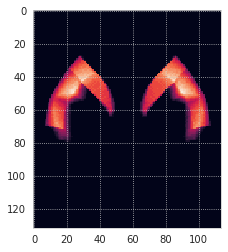

In [31]:
plt.imshow(masks_fx[2].mean(1))

In [32]:
%timeit mice.al.get_masks('Isocortex')

4.84 ms ± 436 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [4]:
net = Network(mice, 'sub-SLC01_ses-3_run-5', 'ca2')

In [5]:
net.data.shape

(302, 5500)

In [6]:
net.n2l

{
    0: '1-8-0',
    1: '1-9-0',
    2: '1-14-0',
    3: '1-15-0',
    4: '1-17-0',
    5: '1-19-0',
    6: '1-20-0',
    7: '1-22-0',
    8: '1-23-0',
    9: '1-24-0',
    10: '1-25-0',
    11: '1-27-0',
    12: '1-28-0',
    13: '1-30-0',
    14: '1-32-0',
    15: '1-33-0',
    16: '1-36-0',
    17: '1-37-0',
    18: '1-38-0',
    19: '1-40-0',
    20: '1-41-0',
    21: '1-43-0',
    22: '1-45-0',
    23: '1-46-0',
    24: '1-47-0',
    25: '1-49-0',
    26: '1-50-0',
    27: '1-51-0',
    28: '1-52-0',
    29: '1-53-0',
    30: '1-56-0',
    31: '1-58-0',
    32: '1-60-0',
    33: '1-61-0',
    34: '1-62-0',
    35: '1-63-0',
    36: '1-65-0',
    37: '1-66-0',
    38: '1-68-0',
    39: '1-69-0',
    40: '1-71-0',
    41: '1-73-0',
    42: '1-74-0',
    43: '1-75-0',
    44: '1-76-0',
    45: '1-78-0',
    46: '1-79-0',
    47: '1-80-0',
    48: '1-81-0',
    49: '1-83-0',
    50: '1-85-0',
    51: '1-86-0',
    52: '1-88-0',
    53: '1-89-0',
    54: '1-90-0',
    55: '1-91-0',
    56: '1-93-0',
    57: '1-94-0',
    58: '1-96-0',
    59: '1-97-0',
    60: '1-99-0',
    61: '1-100-0',
    62: '1-102-0',
    63: '1-103-0',
    64: '1-105-0',
    65: '1-106-0',
    66: '1-107-0',
    67: '1-109-0',
    68: '1-111-0',
    69: '1-112-0',
    70: '1-114-0',
    71: '1-115-0',
    72: '1-116-0',
    73: '1-117-0',
    74: '1-119-0',
    75: '1-120-0',
    76: '1-121-0',
    77: '1-121-1',
    78: '1-123-0',
    79: '1-124-0',
    80: '1-126-0',
    81: '1-128-0',
    82: '1-129-0',
    83: '1-130-0',
    84: '1-131-0',
    85: '1-133-0',
    86: '1-134-0',
    87: '1-134-1',
    88: '1-135-0',
    89: '1-135-1',
    90: '1-137-0',
    91: '1-137-1',
    92: '1-138-0',
    93: '1-138-1',
    94: '1-139-0',
    95: '1-139-1',
    96: '1-140-0',
    97: '1-141-0',
    98: '1-142-0',
    99: '1-143-0',
    100: '1-143-1',
    101: '1-146-0',
    102: '1-147-0',
    103: '1-147-1',
    104: '1-148-0',
    105: '1-148-1',
    106: '1-149-0',
    107: '1-149-1',
    108: '1-151-0',
    109: '1-152-0',
    110: '1-152-1',
    111: '1-153-0',
    112: '1-153-1',
    113: '1-154-0',
    114: '1-155-0',
    115: '1-157-0',
    116: '1-159-0',
    117: '1-159-1',
    118: '1-160-0',
    119: '1-161-0',
    120: '1-161-1',
    121: '1-162-0',
    122: '1-162-1',
    123: '1-163-0',
    124: '1-164-0',
    125: '1-165-0',
    126: '1-166-0',
    127: '1-167-0',
    128: '1-169-0',
    129: '1-170-0',
    130: '1-170-1',
    131: '1-171-0',
    132: '1-172-0',
    133: '1-172-1',
    134: '1-173-0',
    135: '1-173-1',
    136: '1-174-0',
    137: '1-174-1',
    138: '1-175-0',
    139: '1-177-0',
    140: '1-178-0',
    141: '1-179-0',
    142: '1-179-1',
    143: '1-180-0',
    144: '1-181-0',
    145: '1-182-0',
    146: '1-183-0',
    147: '1-184-0',
    148: '1-184-1',
    149: '1-186-0',
    150: '1-187-0',
    151: '2-8-0',
    152: '2-9-0',
    153: '2-14-0',
    154: '2-15-0',
    155: '2-17-0',
    156: '2-19-0',
    157: '2-20-0',
    158: '2-22-0',
    159: '2-23-0',
    160: '2-24-0',
    161: '2-25-0',
    162: '2-27-0',
    163: '2-28-0',
    164: '2-30-0',
    165: '2-32-0',
    166: '2-33-0',
    167: '2-36-0',
    168: '2-37-0',
    169: '2-38-0',
    170: '2-40-0',
    171: '2-41-0',
    172: '2-43-0',
    173: '2-45-0',
    174: '2-46-0',
    175: '2-47-0',
    176: '2-49-0',
    177: '2-50-0',
    178: '2-51-0',
    179: '2-52-0',
    180: '2-53-0',
    181: '2-56-0',
    182: '2-58-0',
    183: '2-60-0',
    184: '2-61-0',
    185: '2-62-0',
    186: '2-63-0',
    187: '2-65-0',
    188: '2-66-0',
    189: '2-68-0',
    190: '2-69-0',
    191: '2-71-0',
    192: '2-73-0',
    193: '2-74-0',
    194: '2-75-0',
    195: '2-76-0',
    196: '2-78-0',
    197: '2-79-0',
    198: '2-80-0',
    199: '2-81-0',
    200: '2-83-0',
    201: '2-85-0',
    202: '2-86-0',
    203: '2-88-0',
    204: '2-89-0',
    205: '2-90-0',
    206: '2-91-0',
    207: '2-93-0',
    208: '2-94-0',
    209: '2-96-0',
    210: '2-97-0',
    211: '2-9

<matplotlib.image.AxesImage object at 0x7f3241d72940>

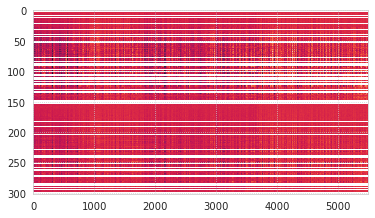

In [7]:
plt.imshow(net.data, aspect=10)

In [8]:
net = Network(mice, 'sub-SLC01_ses-3_run-5', 'bold-lite')

In [9]:
net.data.shape

(302, 550)

In [10]:
net.n2l

{
    0: '1-8-0',
    1: '1-9-0',
    2: '1-14-0',
    3: '1-15-0',
    4: '1-17-0',
    5: '1-19-0',
    6: '1-20-0',
    7: '1-22-0',
    8: '1-23-0',
    9: '1-24-0',
    10: '1-25-0',
    11: '1-27-0',
    12: '1-28-0',
    13: '1-30-0',
    14: '1-32-0',
    15: '1-33-0',
    16: '1-36-0',
    17: '1-37-0',
    18: '1-38-0',
    19: '1-40-0',
    20: '1-41-0',
    21: '1-43-0',
    22: '1-45-0',
    23: '1-46-0',
    24: '1-47-0',
    25: '1-49-0',
    26: '1-50-0',
    27: '1-51-0',
    28: '1-52-0',
    29: '1-53-0',
    30: '1-56-0',
    31: '1-58-0',
    32: '1-60-0',
    33: '1-61-0',
    34: '1-62-0',
    35: '1-63-0',
    36: '1-65-0',
    37: '1-66-0',
    38: '1-68-0',
    39: '1-69-0',
    40: '1-71-0',
    41: '1-73-0',
    42: '1-74-0',
    43: '1-75-0',
    44: '1-76-0',
    45: '1-78-0',
    46: '1-79-0',
    47: '1-80-0',
    48: '1-81-0',
    49: '1-83-0',
    50: '1-85-0',
    51: '1-86-0',
    52: '1-88-0',
    53: '1-89-0',
    54: '1-90-0',
    55: '1-91-0',
    56: '1-93-0',
    57: '1-94-0',
    58: '1-96-0',
    59: '1-97-0',
    60: '1-99-0',
    61: '1-100-0',
    62: '1-102-0',
    63: '1-103-0',
    64: '1-105-0',
    65: '1-106-0',
    66: '1-107-0',
    67: '1-109-0',
    68: '1-111-0',
    69: '1-112-0',
    70: '1-114-0',
    71: '1-115-0',
    72: '1-116-0',
    73: '1-117-0',
    74: '1-119-0',
    75: '1-120-0',
    76: '1-121-0',
    77: '1-121-1',
    78: '1-123-0',
    79: '1-124-0',
    80: '1-126-0',
    81: '1-128-0',
    82: '1-129-0',
    83: '1-130-0',
    84: '1-131-0',
    85: '1-133-0',
    86: '1-134-0',
    87: '1-134-1',
    88: '1-135-0',
    89: '1-135-1',
    90: '1-137-0',
    91: '1-137-1',
    92: '1-138-0',
    93: '1-138-1',
    94: '1-139-0',
    95: '1-139-1',
    96: '1-140-0',
    97: '1-141-0',
    98: '1-142-0',
    99: '1-143-0',
    100: '1-143-1',
    101: '1-146-0',
    102: '1-147-0',
    103: '1-147-1',
    104: '1-148-0',
    105: '1-148-1',
    106: '1-149-0',
    107: '1-149-1',
    108: '1-151-0',
    109: '1-152-0',
    110: '1-152-1',
    111: '1-153-0',
    112: '1-153-1',
    113: '1-154-0',
    114: '1-155-0',
    115: '1-157-0',
    116: '1-159-0',
    117: '1-159-1',
    118: '1-160-0',
    119: '1-161-0',
    120: '1-161-1',
    121: '1-162-0',
    122: '1-162-1',
    123: '1-163-0',
    124: '1-164-0',
    125: '1-165-0',
    126: '1-166-0',
    127: '1-167-0',
    128: '1-169-0',
    129: '1-170-0',
    130: '1-170-1',
    131: '1-171-0',
    132: '1-172-0',
    133: '1-172-1',
    134: '1-173-0',
    135: '1-173-1',
    136: '1-174-0',
    137: '1-174-1',
    138: '1-175-0',
    139: '1-177-0',
    140: '1-178-0',
    141: '1-179-0',
    142: '1-179-1',
    143: '1-180-0',
    144: '1-181-0',
    145: '1-182-0',
    146: '1-183-0',
    147: '1-184-0',
    148: '1-184-1',
    149: '1-186-0',
    150: '1-187-0',
    151: '2-8-0',
    152: '2-9-0',
    153: '2-14-0',
    154: '2-15-0',
    155: '2-17-0',
    156: '2-19-0',
    157: '2-20-0',
    158: '2-22-0',
    159: '2-23-0',
    160: '2-24-0',
    161: '2-25-0',
    162: '2-27-0',
    163: '2-28-0',
    164: '2-30-0',
    165: '2-32-0',
    166: '2-33-0',
    167: '2-36-0',
    168: '2-37-0',
    169: '2-38-0',
    170: '2-40-0',
    171: '2-41-0',
    172: '2-43-0',
    173: '2-45-0',
    174: '2-46-0',
    175: '2-47-0',
    176: '2-49-0',
    177: '2-50-0',
    178: '2-51-0',
    179: '2-52-0',
    180: '2-53-0',
    181: '2-56-0',
    182: '2-58-0',
    183: '2-60-0',
    184: '2-61-0',
    185: '2-62-0',
    186: '2-63-0',
    187: '2-65-0',
    188: '2-66-0',
    189: '2-68-0',
    190: '2-69-0',
    191: '2-71-0',
    192: '2-73-0',
    193: '2-74-0',
    194: '2-75-0',
    195: '2-76-0',
    196: '2-78-0',
    197: '2-79-0',
    198: '2-80-0',
    199: '2-81-0',
    200: '2-83-0',
    201: '2-85-0',
    202: '2-86-0',
    203: '2-88-0',
    204: '2-89-0',
    205: '2-90-0',
    206: '2-91-0',
    207: '2-93-0',
    208: '2-94-0',
    209: '2-96-0',
    210: '2-97-0',
    211: '2-9

<matplotlib.image.AxesImage object at 0x7f324042b910>

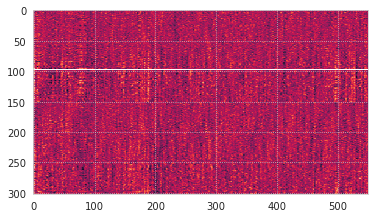

In [11]:
plt.imshow(net.data)

In [12]:
b_func = mice.bold['sub-SLC01_ses-3_run-5']
b_func.shape

(1742, 550)

In [14]:
lite_idxs = mice.get_bold_subset_idxs()

In [15]:
x = b_func[lite_idxs]
x.shape

(302, 550)

<matplotlib.image.AxesImage object at 0x7fd0fd7f6280>

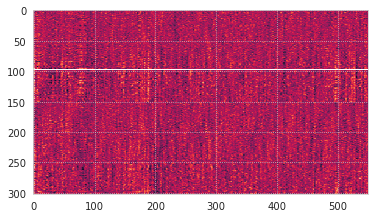

In [16]:
plt.imshow(x)

In [24]:
b_nan = np.where(np.isnan(x).sum(1))[0]
b_nan

array([97])

In [18]:
c_func = mice.ca['sub-SLC01_ses-3_run-5']
c_func.shape

(302, 5500)

In [19]:
y = c_func[:]
y.shape

(302, 5500)

<matplotlib.image.AxesImage object at 0x7fd0fda44220>

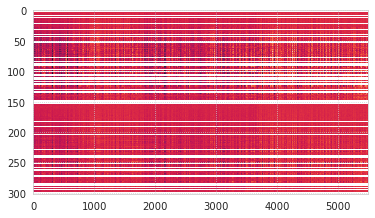

In [21]:
plt.imshow(y, aspect=10)

In [23]:
c_nan = np.where(np.isnan(y).sum(1))[0]
c_nan

array([  0,   1,   2,   9,  12,  22,  24,  32,  40,  43,  51,  53,  62,
        77,  84,  87,  89,  91,  93,  95,  97, 100, 103, 105, 107, 110,
       112, 114, 117, 120, 122, 126, 130, 131, 133, 135, 142, 148, 149,
       150, 151, 152, 153, 154, 175, 183, 191, 204, 228, 238, 240, 242,
       244, 246, 251, 254, 258, 261, 263, 271, 273, 277, 282, 284, 286,
       288, 291, 293, 294, 299, 300, 301])

In [28]:
nan = set(c_nan).union(b_nan)
nan = list(nan)
nonan = np.delete(range(len(y)), nan, axis=0)

<matplotlib.image.AxesImage object at 0x7fd0fc4a22e0>

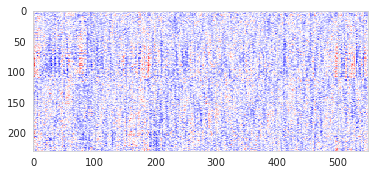

In [38]:
plt.imshow(x[nonan], cmap='bwr')

<matplotlib.image.AxesImage object at 0x7fd0fd559310>

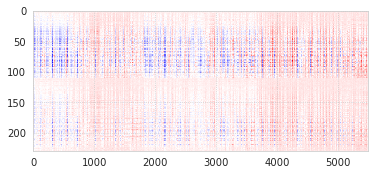

In [39]:
plt.imshow(y[nonan], aspect=10, cmap='bwr')

[<matplotlib.lines.Line2D object at 0x7fd0fc750c70>]

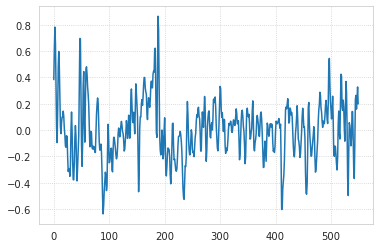

In [36]:
plt.plot(x[nonan].mean(0))

[<matplotlib.lines.Line2D object at 0x7fd0fc34c0a0>]

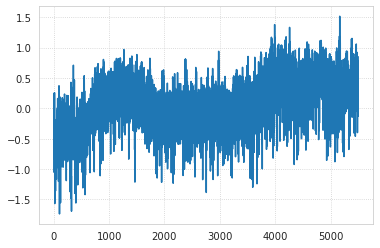

In [37]:
plt.plot(y[nonan].mean(0))